# Fitting COSMOS-HSC (UDeep) Data with MultiProFit

This notebook plots results from fitting sources from the Hyper-Suprime Cam (HSC) Subaru Strategic Program (SSP, https://hsc-release.mtk.nao.ac.jp/doc/) UltraDeep grizy imaging of the COSMOS field (http://cosmos.astro.caltech.edu/) using MultiProFit (https://github.com/lsst-dm/multiprofit, 'MPF'). Specifically, it reads the results of using a Task to fit exposures given an existing catalog with fits from meas_modelfit (https://github.com/lsst/meas_modelfit, 'MMF'), which implements a variant of the SDSS CModel algorithm. In additional to CModel, MultiProFit allows for multi-band fitting, as well as fitting of Sersic profiles, multi-Gaussian approximations thereof ('MG' Sersic), and non-parametric radial profiles (Gaussian mixtures model with shared ellipse parameters, effectively having a Gaussian mixture radial profile). Thus, the main results are comparisons of the two codes doing basically the same thing (single-band exponential, de Vaucouleurs, and CModel linear combination fits), followed by plots highlighting Sersic vs CModel fits, MultiProFit's multi-band performance, and finally comparisons to fits from Hubble Space Telescope (HST) images in the F814W band, which covers a similar wavelength range to the i+z filters.

In [1]:
# Import required packages
from astropy.table import vstack
from astropy.visualization import make_lupton_rgb
from lsst.geom import degrees, Point2D
import glob
from lsst.afw.table import SourceCatalog
from lsst.daf.persistence import Butler
import matplotlib as mpl
import matplotlib.pyplot as plt
from modelling_research.calibrate import calibrate_catalogs, parse_multiprofit_dataId_Hsc
from modelling_research.catalogs import read_source_fits_as_astropy as read_as_astropy
from modelling_research.make_cutout import (get_exposure_cutout_HST, get_exposures_HST_COSMOS,
     get_tiles_overlapping_HST, get_tiles_HST_COSMOS)
import modelling_research.meas_model as mrMeas
from modelling_research.plotting import plotjoint_running_percentiles
from modelling_research.timing import time_print
from multiprofit.gaussutils import sigma_to_reff
from multiprofit.utils import flux_to_mag, mag_to_flux
import numpy as np
import os
import seaborn as sns
from timeit import default_timer as timer
import traceback

In [2]:
# Setup for plotting
%matplotlib inline
sns.set_style('darkgrid')
mpl.rcParams['figure.dpi'] = 160
mpl.rcParams['image.origin'] = 'lower'
sns.set(rc={'axes.facecolor': '0.85', 'figure.facecolor': 'w'})

argspj = dict(
    percentiles=[2.5, 16, 50, 84, 97.5],
    percentilecolours=[(0.4, 0.6, 0.9), (0.3, 0.45, 0.6), (0.3, 0.3, 0.3),
                       (0.3, 0.45, 0.6), (0.4, 0.6, 0.9)],
    scatterleft=True,
    scatterright=True,
    ndivisions=120,
    nbinspan=2,
)

In [3]:
# Setup models and familiar names for parameters
models = {
    "psf": {
        "mpf": mrMeas.Model("MPF PSF", "multiprofit_psf", 2, is_psf=True),
        "mmf": mrMeas.Model("Stack PSF", "modelfit_DoubleShapeletPsfApprox", 2, is_psf=True),
    },
    "gauss": {
        "mpf": mrMeas.Model("MPF Gauss", "multiprofit_gausspx", 1),
        # This isn't actually a PSF-convolved Gaussian model
        # It seems to be configurable but nearly identical to base_SdssShape_instFlux in practice
        #"base": mrMeas.Model("Base Gauss", "base_GaussianFlux", 1),
    },
    "gauss_no_psf": {
        "mpf": mrMeas.Model("MPF Gauss1", "multiprofit_gausspx-nopsf", 1),
        "base": mrMeas.Model("Base Gauss1", "base_SdssShape", 1),
    },
    "exp": {
        "mpf": mrMeas.Model("MPF Exp.", "multiprofit_mg8expgpx", 1),
        "mmf": mrMeas.Model("Stack Exp.", "modelfit_CModel_exp", 1),
    },
    "dev": {
        "mpf": mrMeas.Model("MPF Dev.", "multiprofit_mg8devepx", 1),
        "mmf": mrMeas.Model("", "modelfit_CModel_dev", 1),
    },
    "cmodel": {
        "mpf": mrMeas.Model("MPF CModel", "multiprofit_mg8cmodelpx", 2),
        "mmf": mrMeas.Model("Stack CModel", "modelfit_CModel", 2),
    },
    "mg8serb": {
        "mpf": mrMeas.Model("MPF Sersic", "multiprofit_mg8serbpx", 1),
    },
    "mg8serg": {
        "mpf": mrMeas.Model("MPF Sersic-G", "multiprofit_mg8sergpx", 1),
    },
    "mg8serm": {
        "mpf": mrMeas.Model("MPF Sersic-M", "multiprofit_mg8sermpx", 1),
    },
}

names_optional_comp = ("nser",)
names_optional = ("loglike", "chisqred", "time")
flags_bad = ["base_PixelFlags_flag_saturatedCenter", "base_PixelFlags_flag_sensor_edgeCenter",
             "deblend_tooManyPeaks", "modelfit_CModel_flag"]
flags_good = ["detect_isPatchInner"]

In [4]:
# Define methods to parse tables and put required columns into dicts by useful keys
# TODO: Replace with parquet or something that can do lazy/deferred reading/loading
data = {}
joiner = "_"

def assign_field(datum, field, name):
    if field is not None:
        datum[name] = field

def assign_fields(datum, fields, names, postfix=''):
    for field, name in zip(fields, names):
        assign_field(datum, field, f'{name}{postfix}')

names_ellipse = ('reff', 'axrat', 'ang')

def is_band_hst(band_short):
    return band_short.startswith('f')

def get_bands(bands_short):
    if is_band_hst(bands_short):
        return {bands_short: bands_short.upper()}
    else:
        return {band: f'HSC-{band.upper()}' for band in bands_short}

def get_field(cat, field, log=False):
    if field in cat.columns:
        return cat[field]
    if log:
        print(f"Didn't find field {field}")
    return None

def reduce_cat(cat, name_cat, scale_dist, is_single, field_flux='flux', has_mags=True, log=False, add_prereq_time=True):
    bands_fit = name_cat.split('_unmatched')[0]
    colnames_cat = cat.colnames
    datum_bands = {}
    sigma2reff = sigma_to_reff(1)
    scale_reff = scale_dist*sigma2reff
    bands = get_bands(bands_fit)

    for name_model, algos in models.items():
        is_cmodel = name_model == "cmodel"
        is_psf = name_model == "psf"
        is_gauss = name_model == "gauss"
        is_gauss_no_psf = name_model == 'gauss_no_psf'
        datum_model = {}
        for algo, meas_model in algos.items():
            n_comps = meas_model.n_comps
            is_base = algo == "base"
            is_mmf = algo == "mmf"
            is_mpf = algo == "mpf"
            is_gauss_no_psf_base = is_gauss_no_psf and is_base
            datum = {}
            
            # gauss_no_psf only works in single band for now
            if is_single or (is_mpf and not (is_gauss_no_psf and (len(bands) > 1))):
                for band_short, band_full in bands.items():
                    if is_psf:
                        for comp in range(is_mpf, meas_model.n_comps + is_mpf):
                            reff, axrat, ang = meas_model.get_ellipse_terms(cat, band=band_full, comp=comp)
                            assign_fields(datum, (np.log10(scale_dist*reff), axrat, ang), names_ellipse, postfix=f'{comp}')
                            for name_item in names_optional_comp:
                                name_src = f'{meas_model.get_field_prefix(band_full, comp=comp)}_{name_item}'
                                name_out = f'{name_item}_{comp}_{band_short}'
                                assign_field(datum, get_field(cat, name_src), name_out)
                        for name_item in names_optional:
                            name_src = get_field(cat, f'{meas_model.get_field_prefix(band_full)}_{name_item}')
                            assign_field(datum, name_src, f'{name_item}_{band_short}')
                    else:
                        datum[f'flux_{band_short}'] = meas_model.get_flux_total(cat, band=band_full, flux=field_flux)
                        if is_cmodel and is_mmf:
                            datum[f"fracDev_{band_short}"] = cat[f'{meas_model.get_field_prefix(band_full)}_fracDev']
                        if is_cmodel and is_mpf:
                            # Could do it for HST but not going to bother
                            if has_mags:
                                flux_exp = mag_to_flux(meas_model.get_mag_comp(cat, band=band_full, comp=1))
                                flux_dev = mag_to_flux(meas_model.get_mag_comp(cat, band=band_full, comp=2))
                                mag_c = flux_to_mag(flux_dev + flux_exp)
                                datum[f'mag_{band_short}'] = mag_c
                                datum[f"fracDev_{band_short}"] = flux_dev/(flux_dev + flux_exp)
                        elif has_mags:
                            datum[f'mag_{band_short}'] = meas_model.get_mag_total(cat, band=band_full)
                if not is_psf:
                    if not (is_cmodel or (is_base and is_gauss)):
                        for comp in range(1, meas_model.n_comps + 1):
                            reff, axrat, ang = meas_model.get_ellipse_terms(cat, comp=comp)
                            assign_fields(datum, (np.log10((scale_reff if is_gauss_no_psf_base else scale_dist)*reff), axrat, ang), names_ellipse)
                            for name_item in names_optional_comp:
                                name_src = f'{meas_model.get_field_prefix("", comp=comp)}_{name_item}'
                                assign_field(datum, get_field(cat, name_src), f'{name_item}_{comp}')
                        for ax in ('x', 'y'):
                            assign_field(datum, meas_model.get_cen(cat, axis=ax, comp=1), f'cen{ax}')
                    for name_item in names_optional:
                        name_src = f'multiprofit_measmodel_like_{name_model}' if (is_mmf and name_item == 'loglike') else \
                            f'{meas_model.get_field_prefix("")}_{name_item}'
                        assign_field(datum, get_field(cat, name_src), f'{name_item}')
            if log:
                print(algo, name_model, datum.keys())
            if datum:                
                good = ~cat[flags_bad[0]]
                for flags, is_bad in ((flags_bad[1:], True), (flags_good, False)):
                    for flag in flags:
                        good = good & (~cat[flag] if is_bad else cat[flag])
                        n_good = np.sum(good)
                        if not n_good > 0:
                            raise RuntimeError(f'Found {n_good}/{len(good)} after flag {flag}')
                datum['good'] = good
                datum_model[algo] = datum
        datum_bands[name_model] = datum_model
    # Some models depend on other models and so their fitting time should include prereqs
    # TODO: This should be recursive
    if add_prereq_time:
        models_prereqs = {
            'mg8serb': ('gauss', 'exp', 'dev'),
            'cmodel': ('gauss', 'exp', 'dev'),
        }
        for model, prereqs in models_prereqs.items():
            if model in datum_bands:
                for algo in datum_bands[model]:
                    # mpf CModel depends on the exp that depends on gauss
                    # mmf CModel does not (there is no mmf gauss) but it does have an initial fit that isn't included yet
                    prereqs_algo = [prereq for prereq in prereqs if 'time' in datum_bands[prereq].get(algo, {})]
                    if prereqs_algo:
                        has_base = 'time' in datum_bands[model][algo]
                        if not has_base:
                            datum_bands[model][algo]['time'] = np.copy(datum_bands[prereqs_algo[0]][algo]['time'])
                        for prereq in prereqs_algo[has_base:]:
                            if prereq in datum_bands:
                                datum_bands[model][algo]['time'] += datum_bands[prereq][algo]['time']
    return datum_bands

In [5]:
# Read catalogs
calibrate_cats = True
log = False
scales = {'hsc': 0.168, 'hst': 0.03}

postfix_calib = '_mag'
extension = '.fits'
path_proj = "/project/dtaranu/cosmos/hsc/"
subdirs = {'hsc': f'{path_proj}/scarlet/2020-10-28_mpf/', 'hst': f'{path_proj}/scarlet/2020-10-28_mpf/'}
prefixes = {'hsc': f'/mpf_cosmos-hsc_', 'hst': '-iso/mpf_cosmos-hst-iso_'}
butler = Butler("/project/fred3m/rerun/fullRC2_1/")

cats = {}
bands_ref = 'iz'
cats_keep = set(('iz',))
bands_extra = ('griz', 'i',)
bands_hst = ('f814w',)
bands_survey = {
    'hsc': ((bands_ref,) + bands_extra, True),
    'hst': (bands_hst, False),
}
globs_patches = ("[3-5],[3-5]",) #("0,[0-8]", "1,[0-7]", "[2-7],[0-8]", "8,[0-4]",)
patches = {}


def get_globs(globs, prefix='', postfix='', sort=True, log=False):
    files = []
    for name_glob in globs:
        name_glob_full = f'{prefix}{name_glob}{postfix}'
        if log:
            print(f'Globbing {name_glob_full}')
        files += glob.glob(name_glob_full)
    if sort:
        files.sort()
    return files


def get_prefix_full(subdir, bands, prefix_file, tract=9813):
    return f'{subdir}{bands}{prefix_file}{bands}_{tract}_'


prefix_file = prefixes['hsc']
subdir = subdirs['hsc']
# Get all of the files we expect to read
files = get_globs(
    globs_patches,
    prefix=get_prefix_full(subdir, bands_ref, prefix_file),
    postfix=f'{postfix_calib if not calibrate_cats else ""}{extension}',
    log=True
)
len_extension_calib = len(extension) + (0 if calibrate_cats else len(postfix_calib))
subdir = subdirs['hst']
prefix_file = prefixes['hst']
for file in files:
    # Strip the [_mag].fits extension
    *_, patch = parse_multiprofit_dataId_Hsc(file[:-len_extension_calib])
    # TODO: This should be a mutable tuple (e.g. lsst.pipe.base.Struct)
    patches[patch] = [
        0,
        all(
            os.path.isfile(f'{get_prefix_full(subdir, bands, prefix_file)}{patch}{extension}')
            for bands in bands_hst
        )
    ]
patches_matched = {k: [] for k in (True, False)}
for patch, (_, matched) in patches.items():
    patches_matched[matched].append(patch)
for matched, patches_type in patches_matched.items():
    print(f'{len(patches_type)} {"un" if not matched else ""}matched patches: {patches_type}')
rows_cumulative = {}

for survey, (bands_fit, has_mags) in bands_survey.items():
    postfix_calib_survey = postfix_calib if has_mags else ''
    subdir = subdirs[survey]
    prefix_file = prefixes[survey]
    for bands in bands_fit:
        prefix_full = get_prefix_full(subdir, bands, prefix_file)
        is_ref = bands == bands_ref

        if calibrate_cats and has_mags:
            calibrate_catalogs(
                [f'{prefix_full}{p}{extension}' for p in patches.keys()],
                butler,
                func_dataId=parse_multiprofit_dataId_Hsc
            )
        postfix_cat = f'{postfix_calib_survey}{extension}'
        paths = f"{prefix_full}{postfix_cat}"
        
        for matched, patches_matching in patches_matched.items():
            tables = []
            files = {patch: f'{prefix_full}{patch}{postfix_cat}' for patch in patches_matching}
            if matched:
                missing = [file for file in files.values() if not os.path.isfile(file)]
                if any(missing):
                    raise RuntimeError(f'Missing expected matched files: {missing}')
            else:
                files = {patch: file for patch, file in files.items() if os.path.isfile(file)}
            if is_ref:
                rows_cumulative[matched] = np.zeros(len(files))
            time_init = timer()
            time_now = time_init
            filenames = list(files.values())
            n_files = len(filenames)
            n_rows_cumul = 0 if (is_ref or not n_files) else rows_cumulative[matched][-1]
            for idx, (patch, filename) in enumerate(files.items()):
                if idx == 0:
                    preprint = "Unknown"
                else:
                    fraction_remaining = ((n_files - idx) / n_files) if is_ref else ((n_rows_cumul - rows_cumulative[matched][idx-1]) / n_rows_cumul)
                preprint = "Unknown" if (idx == 0) else f'{(time_now - time_init) * fraction_remaining / (1. - fraction_remaining):.1f}s'
                preprint = f'ETA={preprint} ({idx+1}/{n_files}); Reading {filename}...'
                prefix = 'Read in '
                table, time_now = read_as_astropy(
                    filename, rows_expect=patches[patch][0] if not is_ref else None, log=True,
                    return_time=True, time=time_now, preprint=preprint, read_split_cat=True, prefix=prefix
                )
                tables.append(table)
                if is_ref:
                    n_rows_added = len(table)
                    n_rows_cumul += n_rows_added
                    patches[patch][0] = n_rows_added
                    rows_cumulative[matched][idx] = n_rows_cumul
            if tables:
                time_now = time_print(time=time_init, prefix=f'Read {n_files} files with {n_rows_cumul} rows in ')
                postfix_out = '' if matched else '_unmatched'
                tables = vstack(tables)
                time_now = time_print(time=time_now, prefix=f'Stacked {n_files} files with {n_rows_cumul} rows in ')
                name_cat = f'{bands}{postfix_out}'
                if name_cat in cats_keep:
                    cats[name_cat] = tables
                data[name_cat] = reduce_cat(tables, name_cat, scales[survey], len(bands) == 1, log=log,
                                            field_flux='flux' if has_mags else 'instFlux', has_mags=has_mags)
                time_now = time_print(time=time_now, prefix=f'Reduced {n_files} files with {n_rows_cumul} rows in ')

patch_rows = rows_cumulative[True]

# Link the 'griz' mmf outputs to the i-band ones
# TODO: Use forced models instead
for name_model, algos in models.items():
    datum = data['i'][name_model].get('mmf')
    if datum:
        data['griz'][name_model]['mmf'] = datum

Globbing /project/dtaranu/cosmos/hsc//scarlet/2020-10-28_mpf/iz/mpf_cosmos-hsc_iz_9813_[3-5],[3-5].fits
8 matched patches: ['3,3', '3,5', '4,3', '4,4', '4,5', '5,3', '5,4', '5,5']
0 unmatched patches: []
ETA=Unknown; Calibrating /project/dtaranu/cosmos/hsc//scarlet/2020-10-28_mpf/iz/mpf_cosmos-hsc_iz_9813_3,3.fits... Read in 4.0s
Calibrated /project/dtaranu/cosmos/hsc//scarlet/2020-10-28_mpf/iz/mpf_cosmos-hsc_iz_9813_3,3_mag.fits in 8.7s
ETA=88.8s; Calibrating /project/dtaranu/cosmos/hsc//scarlet/2020-10-28_mpf/iz/mpf_cosmos-hsc_iz_9813_3,5.fits... Read in 3.9s
Calibrated /project/dtaranu/cosmos/hsc//scarlet/2020-10-28_mpf/iz/mpf_cosmos-hsc_iz_9813_3,5_mag.fits in 8.5s
ETA=75.1s; Calibrating /project/dtaranu/cosmos/hsc//scarlet/2020-10-28_mpf/iz/mpf_cosmos-hsc_iz_9813_4,3.fits... Read in 4.1s
Calibrated /project/dtaranu/cosmos/hsc//scarlet/2020-10-28_mpf/iz/mpf_cosmos-hsc_iz_9813_4,3_mag.fits in 8.6s
ETA=62.9s; Calibrating /project/dtaranu/cosmos/hsc//scarlet/2020-10-28_mpf/iz/mpf_cosm

/home/dtaranu/src/mine/multiprofit/multiprofit/gaussutils.py:117: RuntimeWarning: invalid value encountered in sqrt
  sigma_v = np.sqrt((cos_ang_sq*sigma_y_sq - sin_ang_sq*sigma_x_sq)/denom)
/home/dtaranu/src/mine/multiprofit/multiprofit/gaussutils.py:126: RuntimeWarning: invalid value encountered in true_divide
  axrat[cond] = sigma_v[cond]/sigma_u[cond]
/software/lsstsw/stack_20200922/conda/miniconda3-py37_4.8.2/envs/lsst-scipipe/lib/python3.7/site-packages/ipykernel_launcher.py:86: RuntimeWarning: divide by zero encountered in log10


Reduced 8 files with 286007 rows in 0.6s
ETA=Unknown; Calibrating /project/dtaranu/cosmos/hsc//scarlet/2020-10-28_mpf/griz/mpf_cosmos-hsc_griz_9813_3,3.fits... Read in 3.6s
Calibrated /project/dtaranu/cosmos/hsc//scarlet/2020-10-28_mpf/griz/mpf_cosmos-hsc_griz_9813_3,3_mag.fits in 11.4s
ETA=104.9s; Calibrating /project/dtaranu/cosmos/hsc//scarlet/2020-10-28_mpf/griz/mpf_cosmos-hsc_griz_9813_3,5.fits... Read in 4.1s
Calibrated /project/dtaranu/cosmos/hsc//scarlet/2020-10-28_mpf/griz/mpf_cosmos-hsc_griz_9813_3,5_mag.fits in 11.5s
ETA=91.6s; Calibrating /project/dtaranu/cosmos/hsc//scarlet/2020-10-28_mpf/griz/mpf_cosmos-hsc_griz_9813_4,3.fits... Read in 4.3s
Calibrated /project/dtaranu/cosmos/hsc//scarlet/2020-10-28_mpf/griz/mpf_cosmos-hsc_griz_9813_4,3_mag.fits in 11.7s
ETA=77.5s; Calibrating /project/dtaranu/cosmos/hsc//scarlet/2020-10-28_mpf/griz/mpf_cosmos-hsc_griz_9813_4,4.fits... Read in 3.6s
Calibrated /project/dtaranu/cosmos/hsc//scarlet/2020-10-28_mpf/griz/mpf_cosmos-hsc_griz_981

/home/dtaranu/src/mine/modelling_research/meas_model.py:77: RuntimeWarning: overflow encountered in multiply
  xx, yy, xy = x*x, y*y, rho*x*y
/home/dtaranu/src/mine/multiprofit/multiprofit/gaussutils.py:117: RuntimeWarning: invalid value encountered in multiply
  sigma_v = np.sqrt((cos_ang_sq*sigma_y_sq - sin_ang_sq*sigma_x_sq)/denom)


Reduced 8 files with 286007.0 rows in 0.8s
ETA=Unknown (1/8); Reading /project/dtaranu/cosmos/hsc//scarlet/2020-10-28_mpf/f814w-iso/mpf_cosmos-hst-iso_f814w_9813_3,3.fits...Read in 4.1s
ETA=29.3s (2/8); Reading /project/dtaranu/cosmos/hsc//scarlet/2020-10-28_mpf/f814w-iso/mpf_cosmos-hst-iso_f814w_9813_3,5.fits...Read in 4.3s
ETA=24.8s (3/8); Reading /project/dtaranu/cosmos/hsc//scarlet/2020-10-28_mpf/f814w-iso/mpf_cosmos-hst-iso_f814w_9813_4,3.fits...Read in 4.0s
ETA=19.9s (4/8); Reading /project/dtaranu/cosmos/hsc//scarlet/2020-10-28_mpf/f814w-iso/mpf_cosmos-hst-iso_f814w_9813_4,4.fits...Read in 3.7s
ETA=15.2s (5/8); Reading /project/dtaranu/cosmos/hsc//scarlet/2020-10-28_mpf/f814w-iso/mpf_cosmos-hst-iso_f814w_9813_4,5.fits...Read in 4.1s
ETA=11.2s (6/8); Reading /project/dtaranu/cosmos/hsc//scarlet/2020-10-28_mpf/f814w-iso/mpf_cosmos-hst-iso_f814w_9813_5,3.fits...Read in 3.6s
ETA=7.8s (7/8); Reading /project/dtaranu/cosmos/hsc//scarlet/2020-10-28_mpf/f814w-iso/mpf_cosmos-hst-iso_f814

In [6]:
# Setup units and columns for plotting
units = {
    "time": "s",
    "reff": '"',
}

labels = {
    "mag_i": 'i',
    "reff": '$\log10(R_{eff,maj})$',
}

mag_i_bright, mag_i_mid, mag_i_faint = 15.5, 24., 29.
mag_i_lim = (mag_i_bright, mag_i_faint)
mag_i_lim_bright = (mag_i_bright, mag_i_mid)

columns_plot = {
    "loglike": dict(difference=True, limx=(0, 6e3), limy=(-25, 25), crop_x=True),
    "time": dict(log=True, ratio=True, limx=(-3., 0.5), limy=(-1.5, 2.5), plot_cumulative=True),
    "mag_i": dict(difference=True, limx=mag_i_lim, limy=(-0.4, 0.2)),
    "mag_i_bright": dict(difference=True, limx=mag_i_lim_bright, limy=(-0.15, 0.15),
                         crop_x=True, column="mag_i"),
}
columns_plot_size = columns_plot.copy()
columns_plot_size["reff"] = dict(log=False, difference=True, limx=(-2., 2.), limy=(-1, 1))
columns_plot_size["mag_i_reff_mmf"] = dict(ratio=False, limx=mag_i_lim, limy=(-2.5, 1.5),
                                           column_x="mag_i", column_y="reff", datum_idx_y=0)
columns_plot_size["mag_i_reff_mpf"] = dict(ratio=False, limx=mag_i_lim, limy=(-2.5, 1.5),
                                           column_x="mag_i", column_y="reff", datum_idx_x=1)
columns_plot_size["mag_i_bright_reff_mmf"] = dict(ratio=False, limx=mag_i_lim_bright, limy=(-2.5, 1.5),
                                                  column_x="mag_i", column_y="reff", datum_idx_y=0, crop_x=True)
columns_plot_size["mag_i_bright_reff_mpf"] = dict(ratio=False, limx=mag_i_lim_bright, limy=(-2.5, 1.5),
                                                  column_x="mag_i", column_y="reff", datum_idx_x=1, crop_x=True)

In [7]:
# Define functions for plotting parameter values in dicts (not the original tables)
def get_columns_info(column_info, name_plot, labels=None):
    if labels is None:
        labels = {}
    column = column_info.get('column', name_plot)
    postfix = column_info.get('postfix','')
    x = column_info.get('column_x', column)
    column_x = f"{x}{column_info.get('postfix_x',postfix)}"
    name_column_x = labels.get(x, x)
    datum_idx_x = column_info.get('datum_idx_x', 0)
    datum_idx_y = column_info.get('datum_idx_y', 1)
    y = column_info.get("column_y", x)
    plot_cumulative = column_info.get("plot_cumulative", False)
    column_y = column_x if y is x else f"{y}{column_info.get('postfix_y',postfix)}"
    name_column_y = labels.get(y, name_column_x if y is x else y)
    return column_x, column_y, name_column_x, name_column_y, datum_idx_x, datum_idx_y, plot_cumulative


def plot_column_pair(
    x, y, cond, column_info, name_column_x, name_column_y, label_x, label_y,
    algo_x, algo_y, model_x, model_y, band, argspj=None, units=None, title=None,
    cumulative=False, title_cumulative=None, show=True
):
    if argspj is None:
        argspj = {}
    if units is None:
        units = {}
    is_log = column_info.get('log', False)
    is_log_x = column_info.get('log_x', is_log)
    is_log_y = column_info.get('log_y', is_log)
    is_ratio = column_info.get('ratio', False)
    is_difference = column_info.get('difference', False)
    is_combo = is_ratio or is_difference
    crop_x = column_info.get('crop_x', False)
    crop_y = column_info.get('crop_y', False)
    y_plot = y
    if is_difference:
        y_plot = y_plot - x
    elif is_ratio:
        y_plot = y/x
    if is_log_x:
        x = np.log10(x)
    if is_log_y:
        y_plot = np.log10(y_plot)
    unit_x = units.get(name_column_x, None)
    unit_x_fmt = f' ({unit_x})' if unit_x is not None else ''
    unit_y = units.get(name_column_y, None)
    unit_y_fmt = f" ({unit_y})" if (not is_ratio and name_column_y in units) else ''
    good = cond & np.isfinite(x) & np.isfinite(y)
    if name_column_x == "reff":
        good = good & (x > -1.8)
    lim_x = column_info.get('limx', (0, 3))
    lim_y = column_info.get('limy', (-1, 1))
    if crop_x:
        good = good & (x > lim_x[0]) & (x < lim_x[1])
    if crop_y:
        good = good & (y_plot > lim_y[0]) & (y_plot < lim_y[1])
    prefix = "log10 " if is_log else ""
    postfix_x = f" [{algo_x} {model_x}, {band}-band]{unit_x_fmt}"
    middle_y =  f" {'/' if is_ratio else '-'} {algo_x} {model_x}" if is_combo else ""
    postfix_y = f" [{algo_y} {model_y}{middle_y}]{unit_y_fmt}"
    label_x = f"{prefix}{label_x}{postfix_x}"
    x_good, y_good = (ax[good] for ax in [x, y_plot])
    plotjoint_running_percentiles(
        x_good, y_good, **argspj,
        labelx=label_x, labely=f"{prefix}{label_y}{postfix_y}",
        title=title,
        limx=lim_x, limy=lim_y,
    )
    if show:
        plt.show(block=False)
    if cumulative:
        x_plot = [(np.sort(x_good), is_log_x, f'{algo_x} {model_x}, {band}-band')]
        plot_y = unit_x == unit_y
        if plot_y:
            if is_difference or is_ratio:
                y_plot = np.log10(y[good]) if is_log_y else y[good]
            x_plot.append((np.sort(y_plot), is_log_y, f'{algo_y} {model_y}, {band}-band'))
        y_max = 0
        for x_cumul, is_log, label in x_plot:
            y_cumul = np.cumsum(10**x_cumul if is_log else x_cumul)
            y_max = np.nanmax([y_max, y_cumul[-1]])
            postfix_label = ''
            # Clip slightly before lim_x[1] so that it plots nicely at the edge if it needs to be clipped
            x_max = lim_x[1] - 1e-3*(lim_x[1] - lim_x[0])
            if x_cumul[-1] > x_max:
                idx = np.searchsorted(x_cumul, x_max)
                x_cumul[idx] = x_max
                y_cumul[idx] = y_cumul[-1]
                idx = idx + 1
                x_cumul = x_cumul[0:idx]
                y_cumul = y_cumul[0:idx]
                postfix_label = ' (clipped)'
            sns.lineplot(x=x_cumul, y=y_cumul, label=f'{label}{postfix_label}', ci=None)
        if plot_y:
            plt.legend()
        plt.xlim(lim_x)
        plt.ylim([0, y_max])
        plt.xlabel(label_x)
        plt.ylabel(f'Cumulative {label_y} ({unit_x})')
        if title_cumulative is not None:
            plt.title(title_cumulative)
        if show:
            plt.show(block=False)
    

def plot_models(data, band, algos, columns_plot, columns_plot_size, models=None, labels=None, argspj=None):
    if argspj is None:
        argspj = {}
    if labels is None:
        labels = {}       
    if models is None:
        models = ["exp", "dev", "cmodel"]
    data_band = data[band]
    for model in models:
        is_single_comp = model != "cmodel"
        data_model = data_band[model]
        data_algos = [data_model[algo] for algo in algos]
        data_cond = data_algos[0]
        cond = (data_cond[f'mag_i'] < 29) & (data_cond['good'])
        title = f'Tract 9813 N={np.count_nonzero(cond)}'
        for name_plot, column_info in (columns_plot_size if is_single_comp else columns_plot).items():
            print(f"Plotting model {model} plot {name_plot}")
            column_x, column_y, name_column_x, name_column_y, datum_idx_x, datum_idx_y, plot_cumulative = \
                get_columns_info(column_info, name_plot, labels=labels)
            try:
                x = data_algos[datum_idx_x][column_x]
                y = data_algos[datum_idx_y][column_y]
                plot_column_pair(
                    x, y, cond, column_info,
                    column_x, column_y, name_column_x, name_column_y,
                    algos[datum_idx_x], algos[datum_idx_y], model, model, band,
                    units=units, title=title, cumulative=plot_cumulative,
                    title_cumulative=title if plot_cumulative else None, argspj=argspj
                )
            except Exception as e:
                data_model_name = f"data['{band}']['{model}']"
                print(f"Failed to read {data_model_name}['{algos[datum_idx_x]}']['{column_x}'] and/or "
                      f"{data_model_name}['{algos[datum_idx_y]}']['{column_y}'] "
                      f"due to {getattr(e, 'message', repr(e))}")
                traceback.print_exc()
                
def plot_models_algo(data, band, algo, models, columns_plot, columns_plot_size, labels=None, argspj=None):
    if argspj is None:
        argspj = {}
    if labels is None:
        labels = {}
    data_band = data[band]
    data_models = [data_band[model] for model in models]
    is_single_comp = all([model != "cmodel" for model in models])
    data_algos = [data_model[algo] for data_model in data_models]
    cond = (data_algos[0][f'mag_i'] < 29) & (data_algos[0]['good'])
    title = f'N={np.count_nonzero(cond)}'
    for name_plot, column_info in (columns_plot_size if is_single_comp else columns_plot).items():
        print(f"Plotting models {models} plot {name_plot}")
        column_x, column_y, name_column_x, name_column_y, datum_idx_x, datum_idx_y, plot_cumulative = \
            get_columns_info(column_info, name_plot, labels=labels)
        title_cumul = title if plot_cumulative else None
        try:
            if column_x == column_y:
                x = data_algos[0][column_x]
                y = data_algos[1][column_y]
                plot_column_pair(
                    x, y, cond, column_info,
                    column_x, column_y, name_column_x, name_column_y,
                    algo, algo, models[0], models[1], band,
                    units=units, title=title, cumulative=plot_cumulative,
                    title_cumulative=title_cumul, argspj=argspj,
                )
            else:
                for idx in range(2):
                    datum_algo = data_algos[idx]
                    model = models[idx]
                    plot_column_pair(
                        datum_algo[column_x], datum_algo[column_y], cond, column_info,
                        column_x, column_y, name_column_x, name_column_y,
                        algo, algo, model, model, band,
                        units=units, title=title, cumulative=plot_cumulative,
                        title_cumulative=title_cumul, argspj=argspj,
                    )
        except Exception as e:
            data_model_names = [f"data['{band}']['{model}']" for model in models]
            print(f"Failed to read {data_model_names[0]}['{algo}']['{column_x}'] and/or "
                  f"{data_model_names[1]}['{algo}']['{column_y}'] "
                  f"due to {getattr(e, 'message', repr(e))}")
            traceback.print_exc()

## Joint Plot Format Description
Most of the following plots are joint plots made with seaborn. They show:
- A 2D kernel density estimate in a red-to-white gradient, covering the region where the density is too high for a scatter plot,
- Running percentiles for the y-axis quantity in x-axis bins containing equal numbers of points (with the line passing the point with the median x value within that bin),
- x- and y-axis marginalized histograms,
- Individual points coloured blue for outliers above/below the highest/lowest percentile per bin; and:
- Individual points coloured black for the outermost bins on the x-axis, where the percentiles are not measured.
The percentile measurements beyond the outermost bins also extend horizontally to the edge of the plot for visual purposes, indicating that any measurement of the percentiles beyond that region would be unreliable.

## Comparing i-band meas_modelfit vs MultiProFit

Both are single-band fits.

### Gaussian moments
These plots compare MultiProFit's single Gaussian, no PSF fits (useful for identifying faint point sources) with the stack's adaptive moments.
Encouragingly, they are nearly identical. This may even be a little surprising given that MultiProFit has a free centroid.

Plotting model gauss_no_psf plot loglike
Failed to read data['i']['gauss_no_psf']['base']['loglike'] and/or data['i']['gauss_no_psf']['mpf']['loglike'] due to KeyError('loglike')
Plotting model gauss_no_psf plot time
Failed to read data['i']['gauss_no_psf']['base']['time'] and/or data['i']['gauss_no_psf']['mpf']['time'] due to KeyError('time')
Plotting model gauss_no_psf plot mag_i


Traceback (most recent call last):
  File "<ipython-input-7-c0ec25edde6b>", line 127, in plot_models
    x = data_algos[datum_idx_x][column_x]
KeyError: 'loglike'
Traceback (most recent call last):
  File "<ipython-input-7-c0ec25edde6b>", line 127, in plot_models
    x = data_algos[datum_idx_x][column_x]
KeyError: 'time'


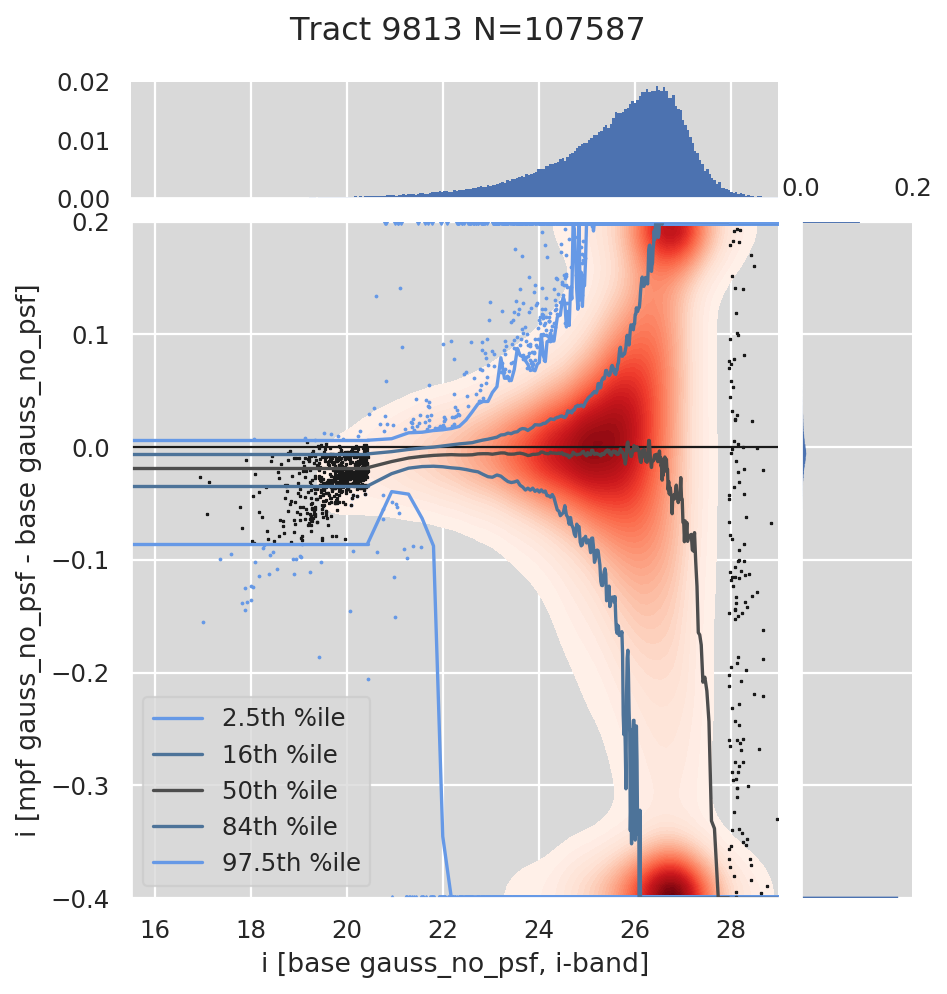

Plotting model gauss_no_psf plot mag_i_bright


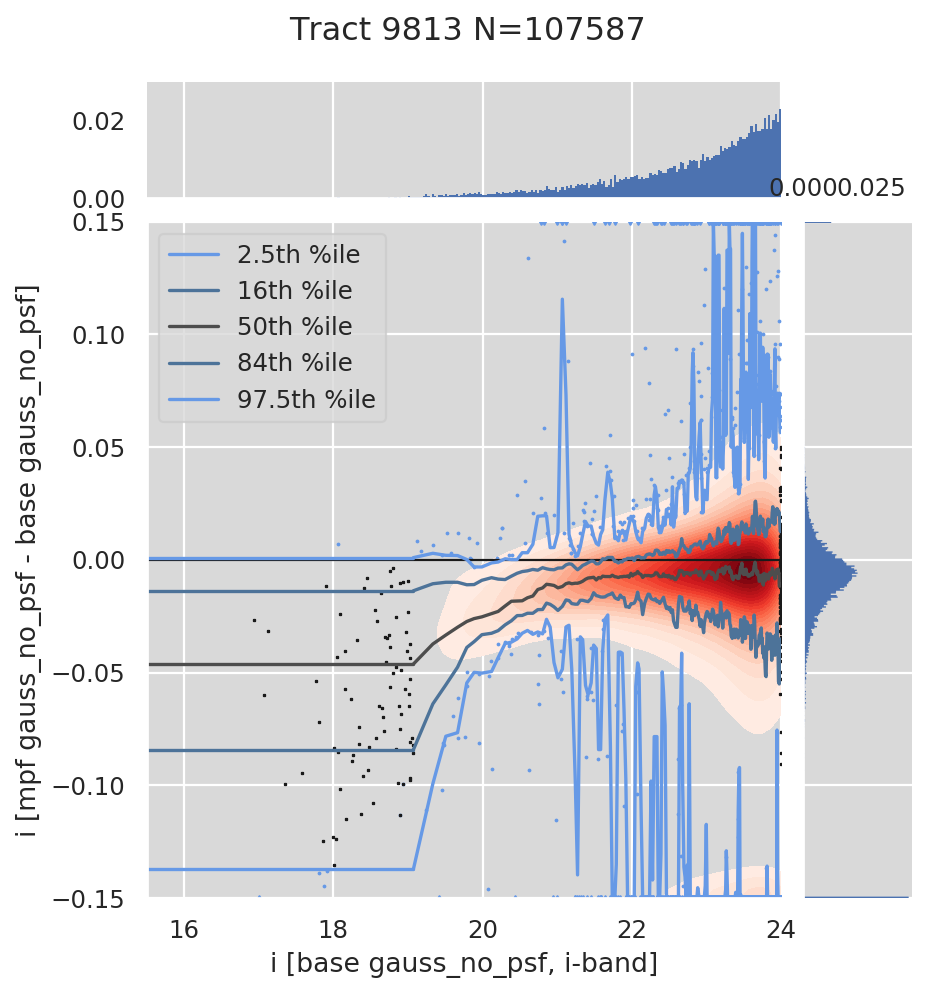

Plotting model gauss_no_psf plot reff


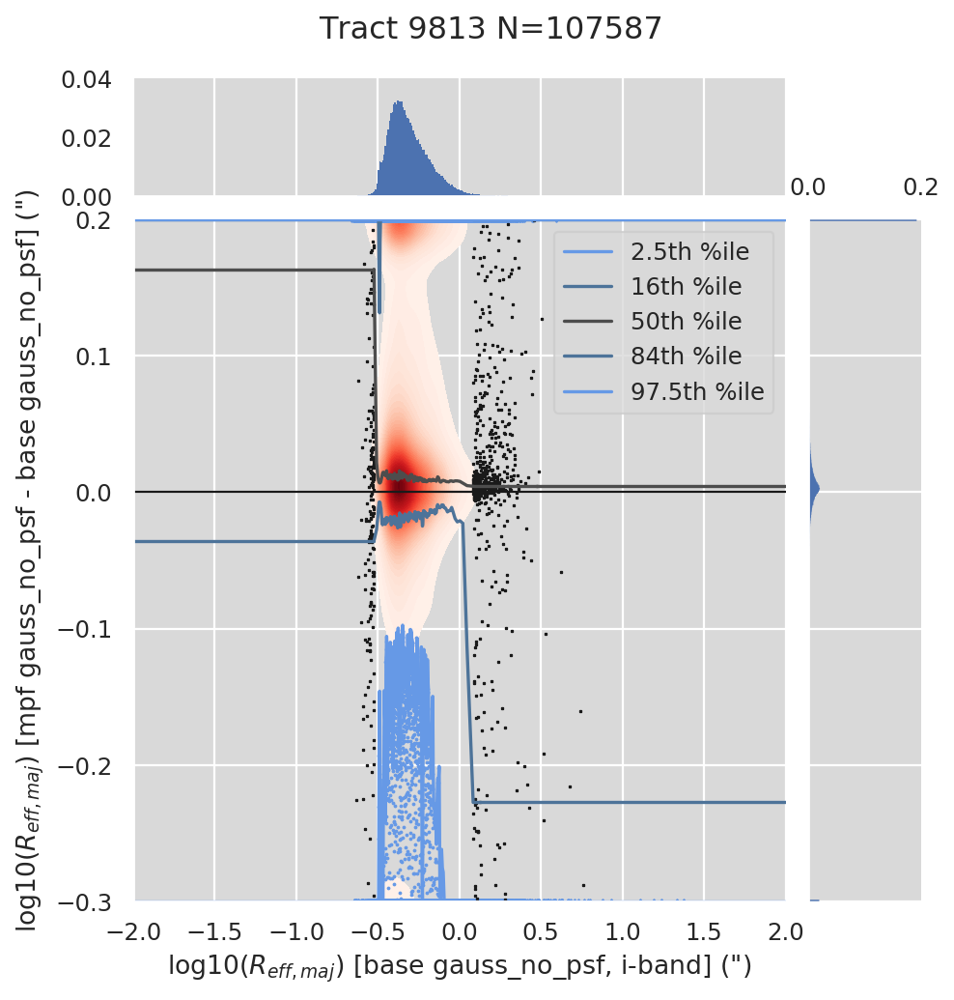

Plotting model gauss_no_psf plot mag_i_reff_mmf


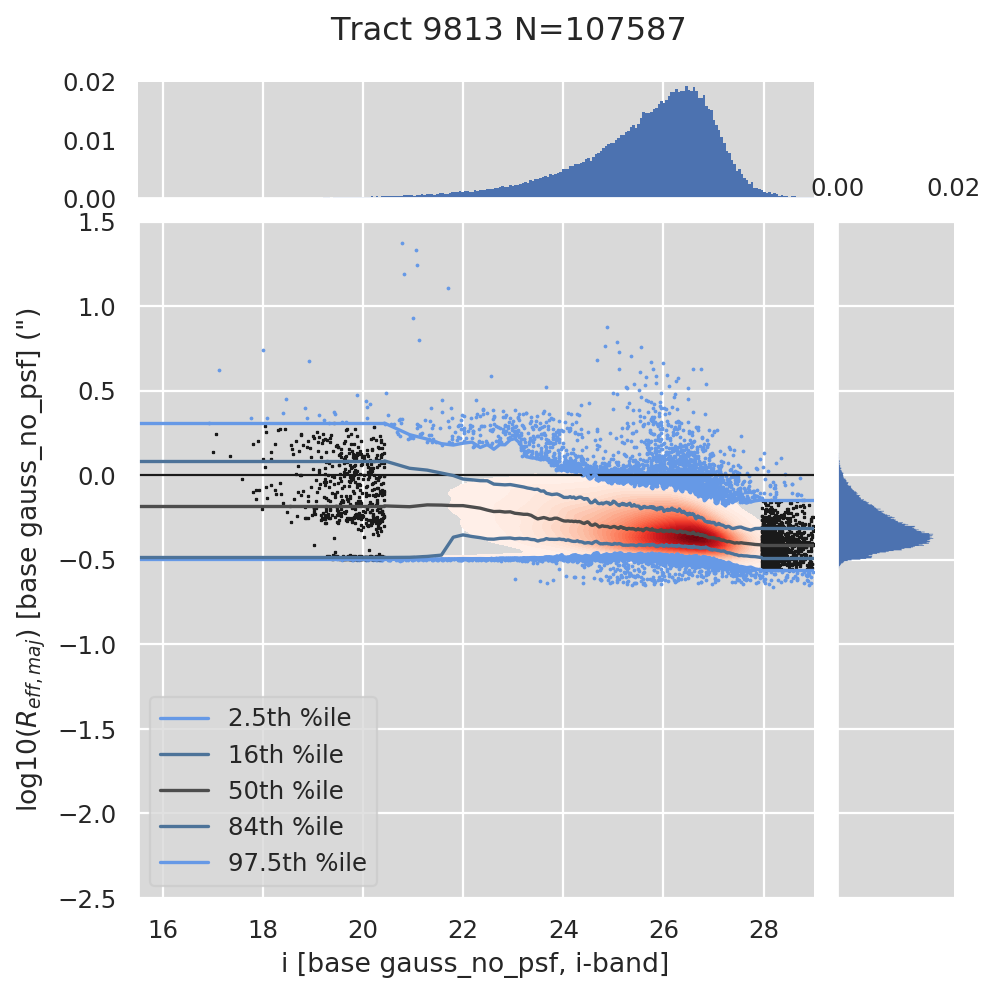

Plotting model gauss_no_psf plot mag_i_reff_mpf


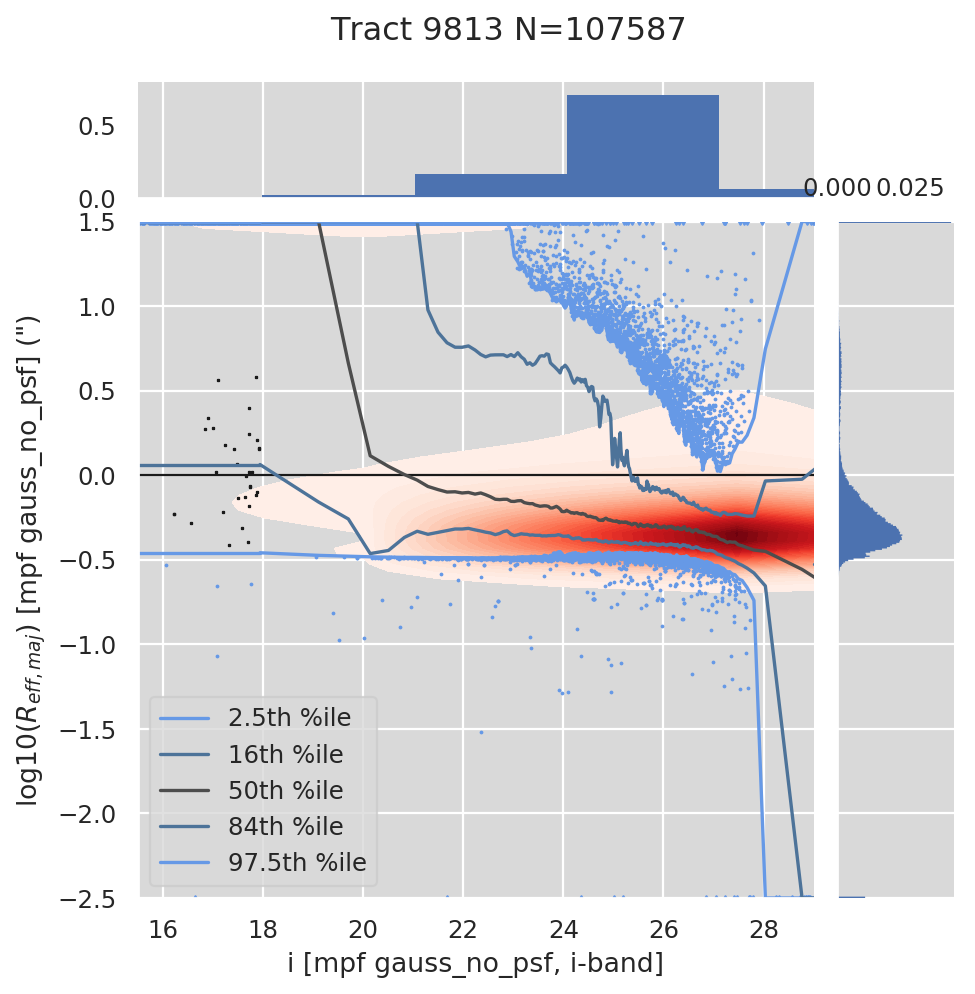

Plotting model gauss_no_psf plot mag_i_bright_reff_mmf


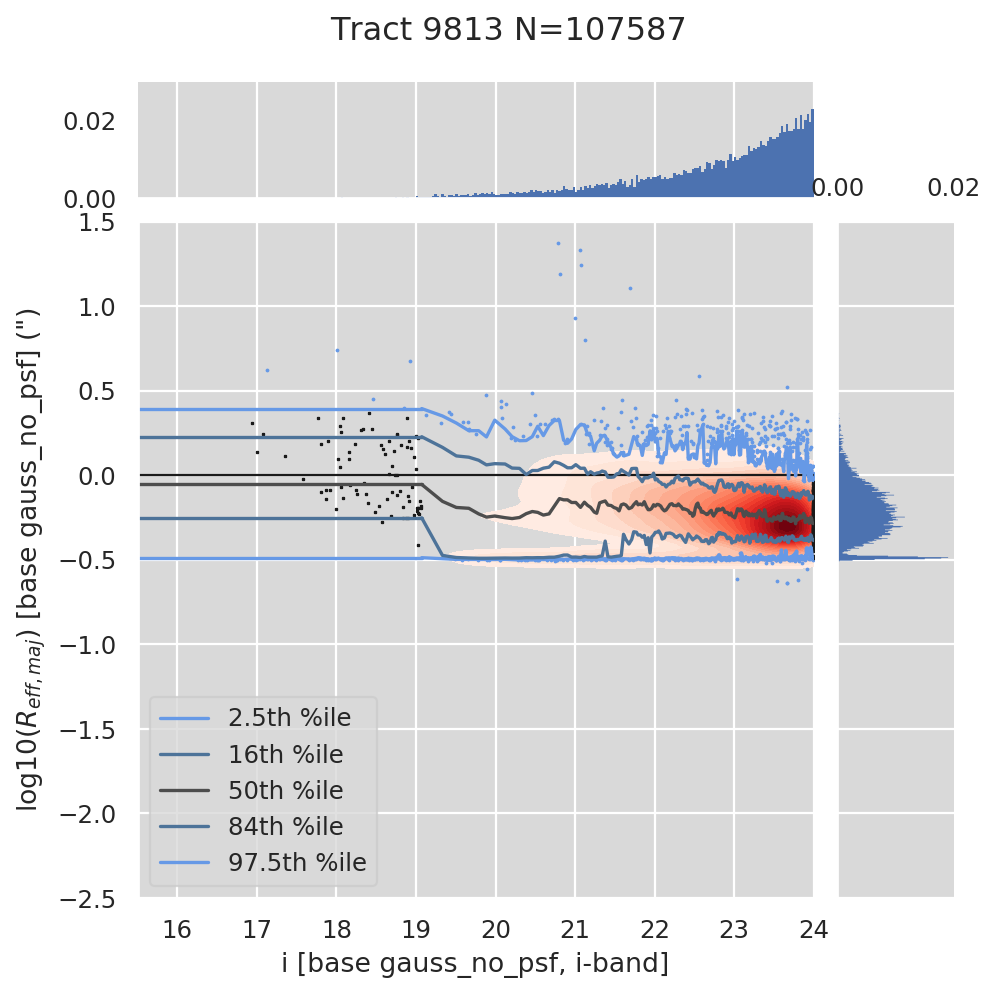

Plotting model gauss_no_psf plot mag_i_bright_reff_mpf


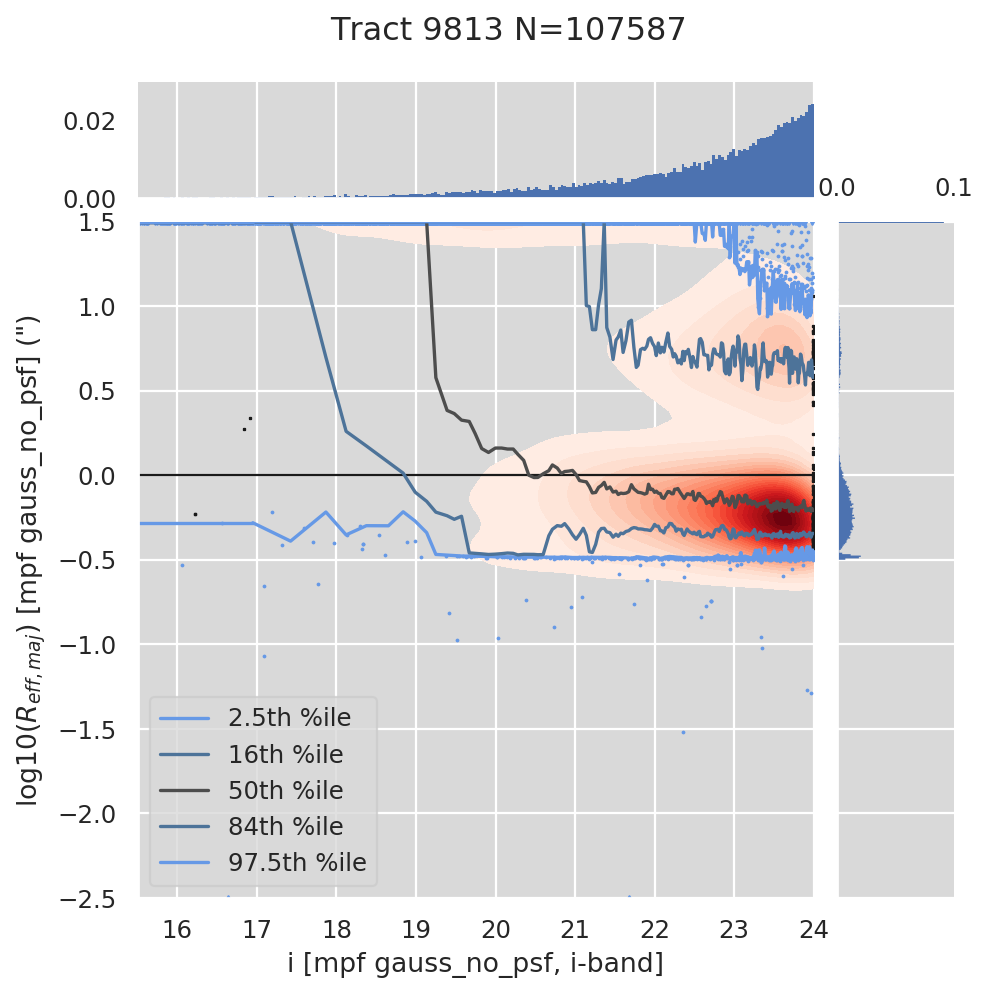

In [8]:
# Plot r-band MMF vs MPF, no PSF Gauss only (should be very consistent)
limy = columns_plot_size["reff"]["limy"]
columns_plot_size["reff"]["limy"] = (-0.3, 0.2)
plot_models(data, "i", ("base", "mpf"), columns_plot, columns_plot_size, models=['gauss_no_psf'], labels=labels, argspj=argspj)
columns_plot_size["reff"]["limy"] = limy

### i-band MMF vs MPF, exp and deV
Some interesting results to note here:
1. MultiProFit's exponential fits have better log likelihoods, almost certainly due to the free centroid since the other parameters are broadly consistent.
2. Exp fit cumulative runtime is dominated by quick fits, not slow outliers. MPF is considerably slower than MMF but has a similar shape.
3. MMF's size prior of ~4 pixels seems to dominate for low S/N galaxies, causing a pileup of galaxies with that size (especially for deV fits).
4. MMF and MPF have a problem with unreasonably large and bright galaxies; visual inspection shows them mostly to be very low S/N objects/artifacts.
The large sizes mean that these have very low surface brightnesses but a lot of flux over a large area, so possibly they occur in regions with underestimated sky.
5. MMF's size prior does work to limit the number of such overly large galaxies compared to MPF, but it isn't enough on its own.
6. deV fits are in much greater disagreement than exp, possibly due to the difference in the Gaussian mixture approximation between MPF and MMF (which is Hogg & Lang 13/Tractor's luv profile).
7. The pileup of deV fits at the size prior in MMF is more severe than for exp.
8. While still faster than MPF overall, MMF deV cumulative runtime is dominated by a small number of slow (>3s) fits.
9. CModel magnitudes are fairly consistent, probably because most galaxies have low fracDev and thus the discrepancy in deV fits is less important.

Plotting model exp plot loglike


/software/lsstsw/stack_20200922/conda/miniconda3-py37_4.8.2/envs/lsst-scipipe/lib/python3.7/site-packages/ipykernel_launcher.py:38: RuntimeWarning: invalid value encountered in subtract


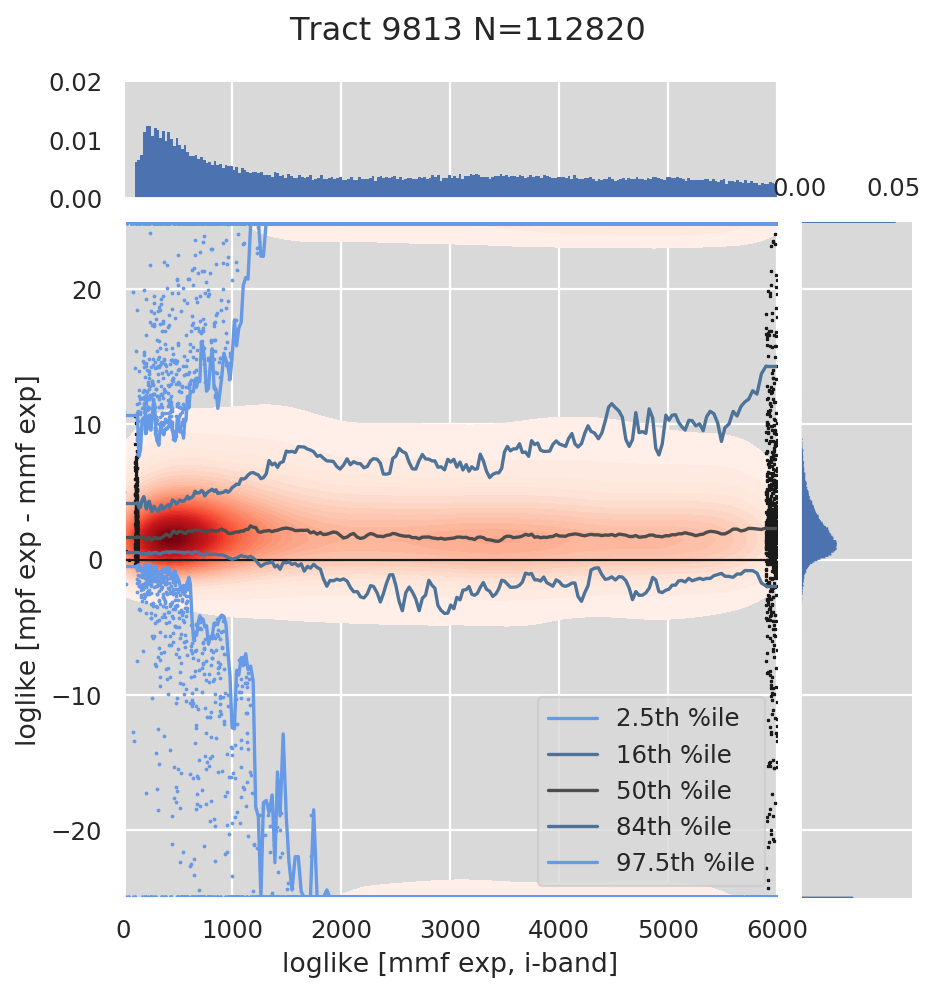

Plotting model exp plot time


/software/lsstsw/stack_20200922/conda/miniconda3-py37_4.8.2/envs/lsst-scipipe/lib/python3.7/site-packages/ipykernel_launcher.py:40: RuntimeWarning: overflow encountered in true_divide


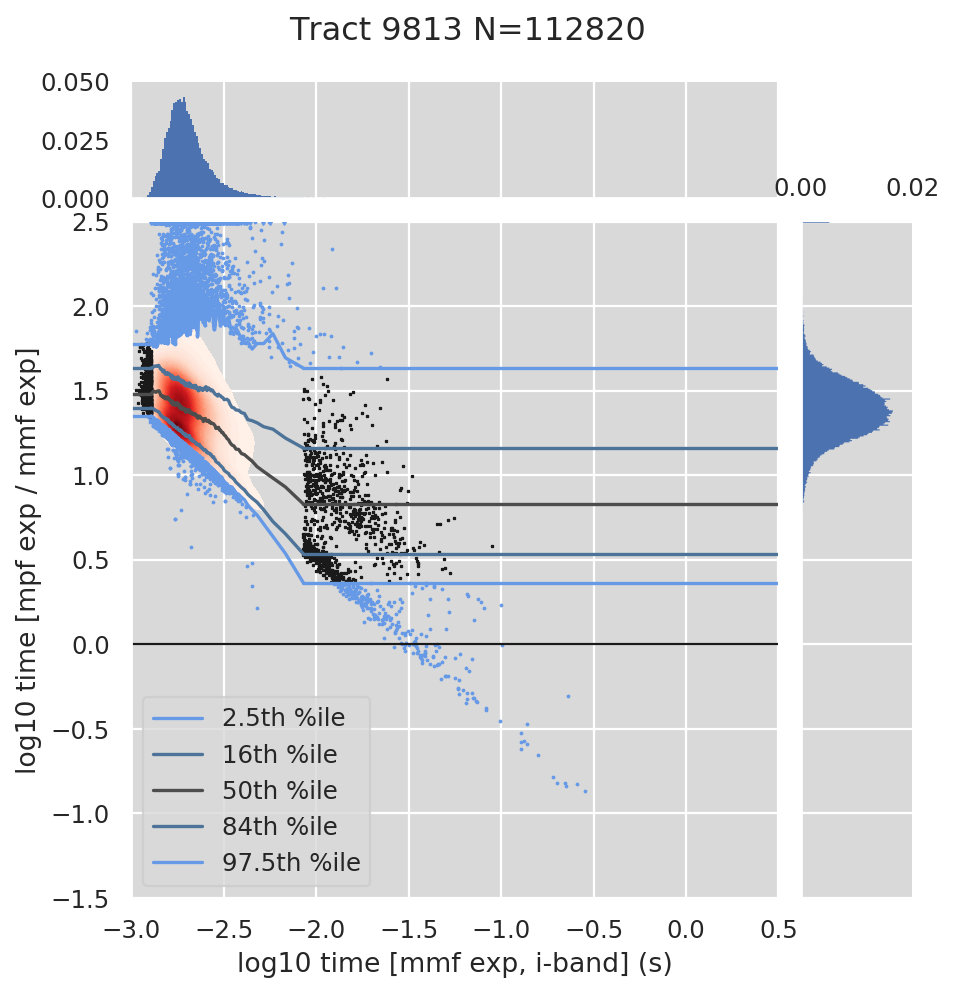

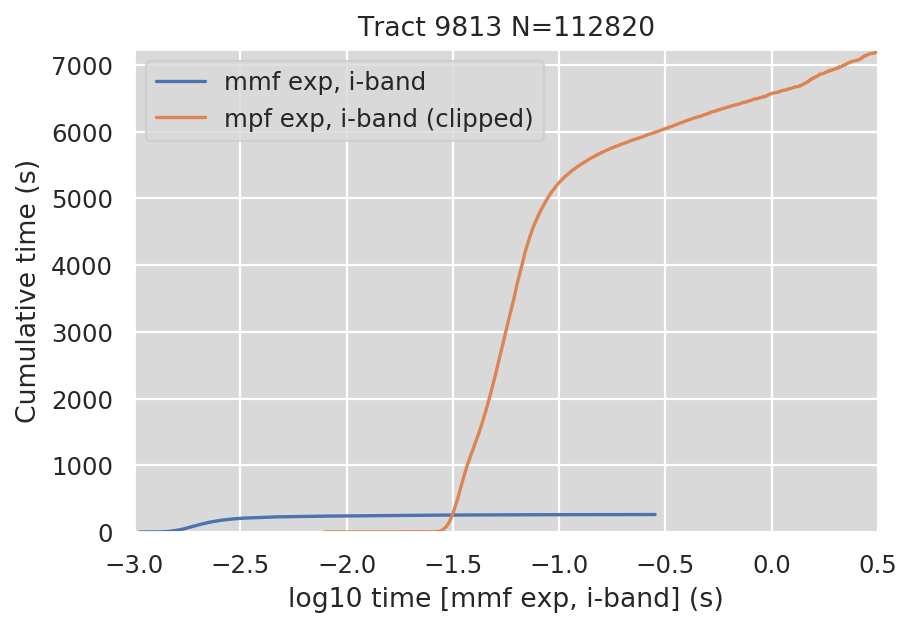

Plotting model exp plot mag_i


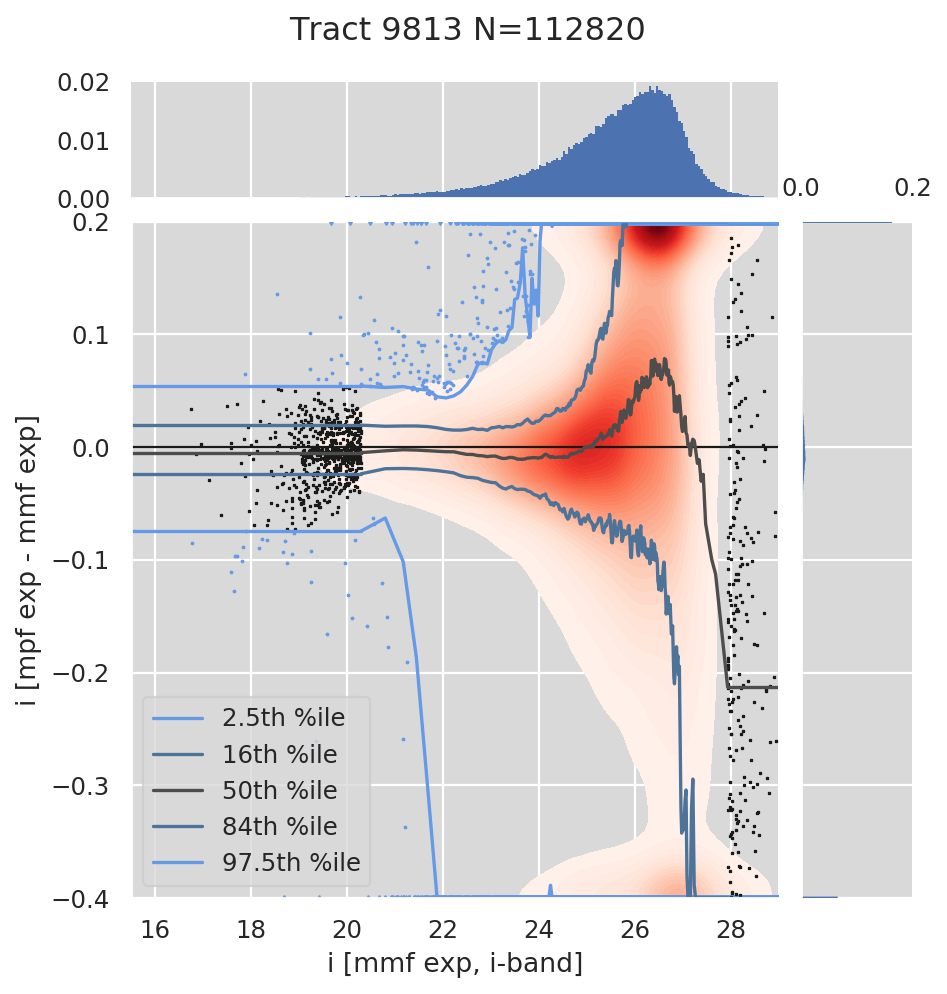

Plotting model exp plot mag_i_bright


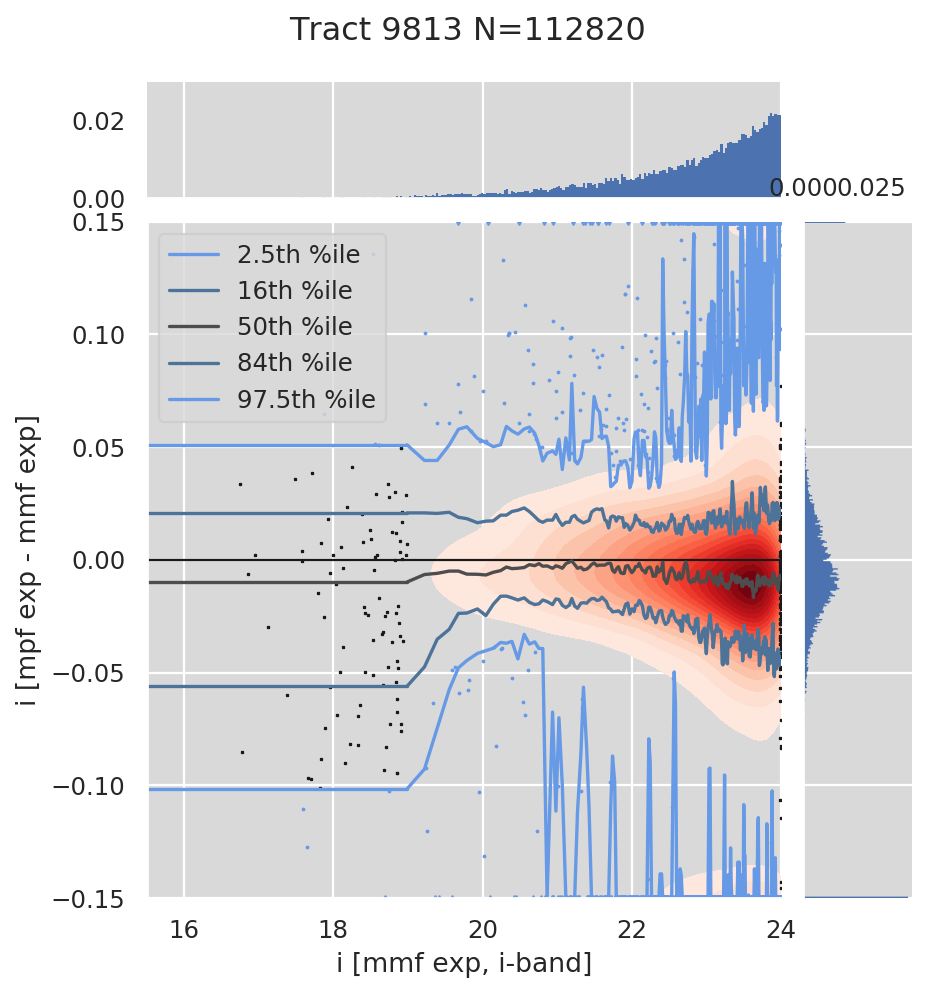

Plotting model exp plot reff


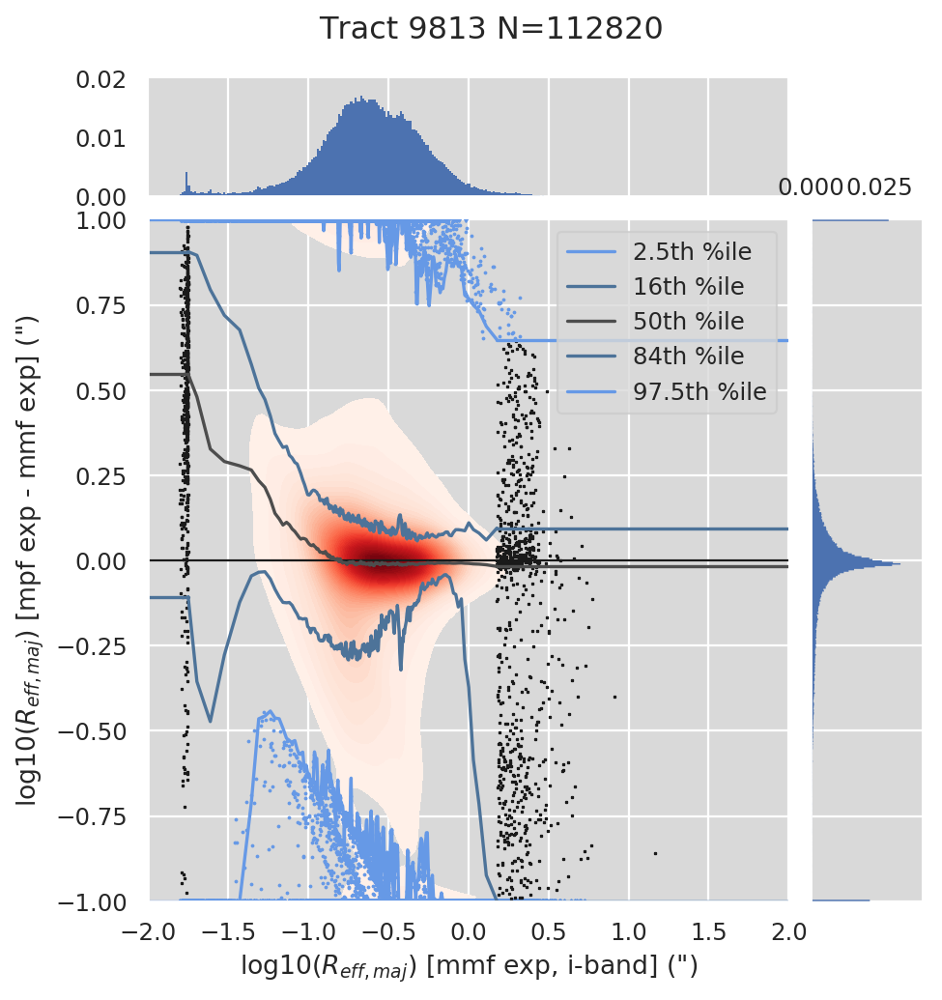

Plotting model exp plot mag_i_reff_mmf


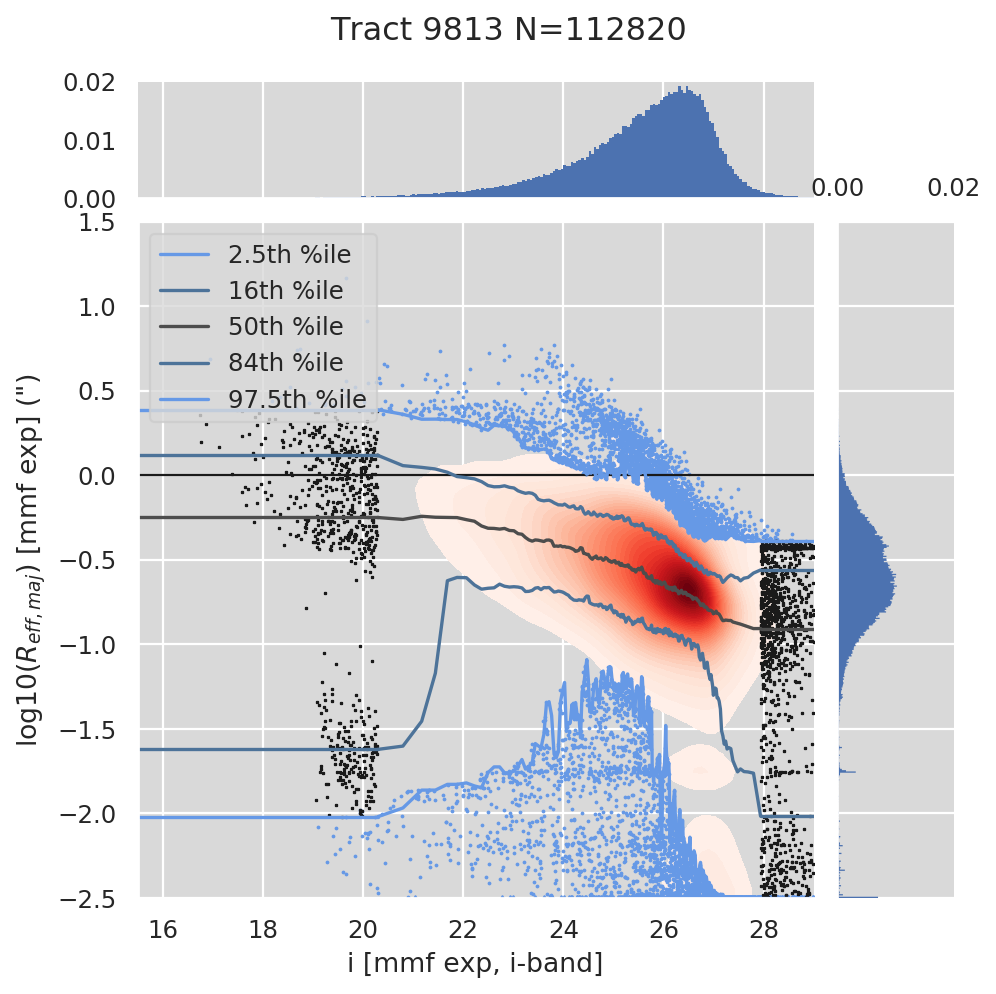

Plotting model exp plot mag_i_reff_mpf


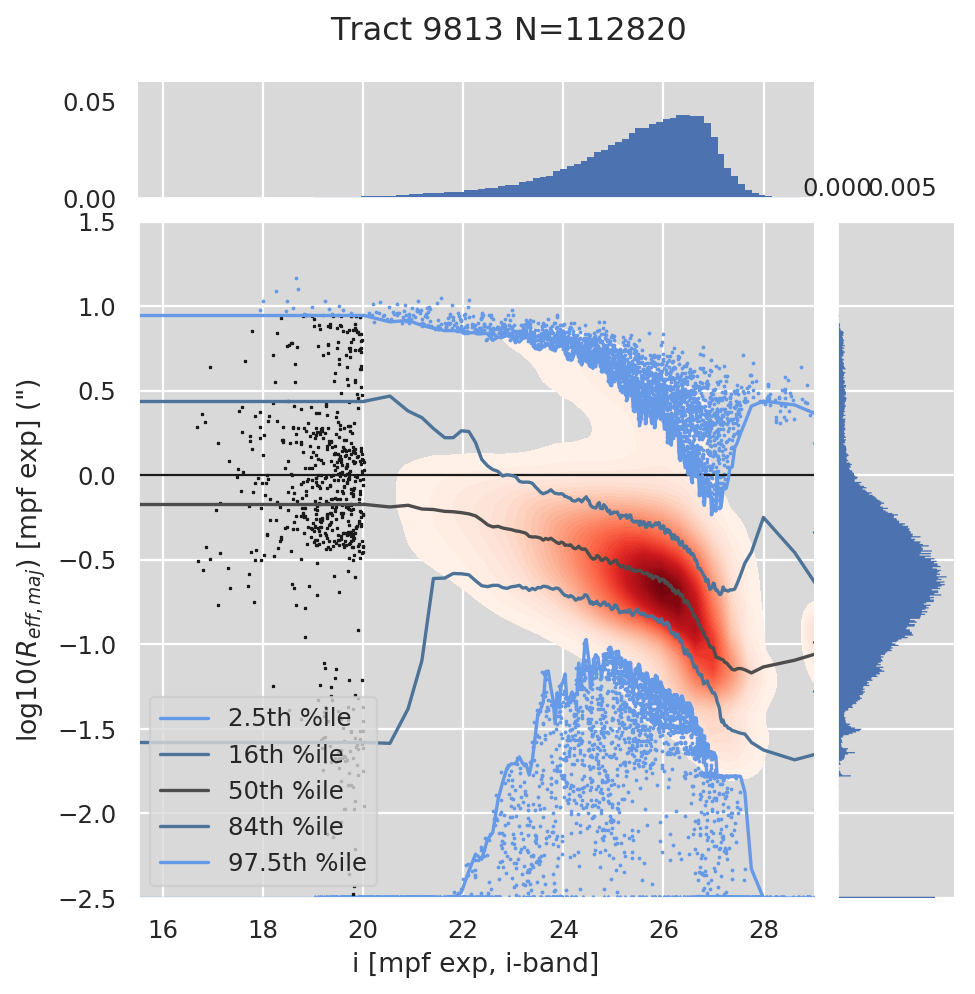

Plotting model exp plot mag_i_bright_reff_mmf


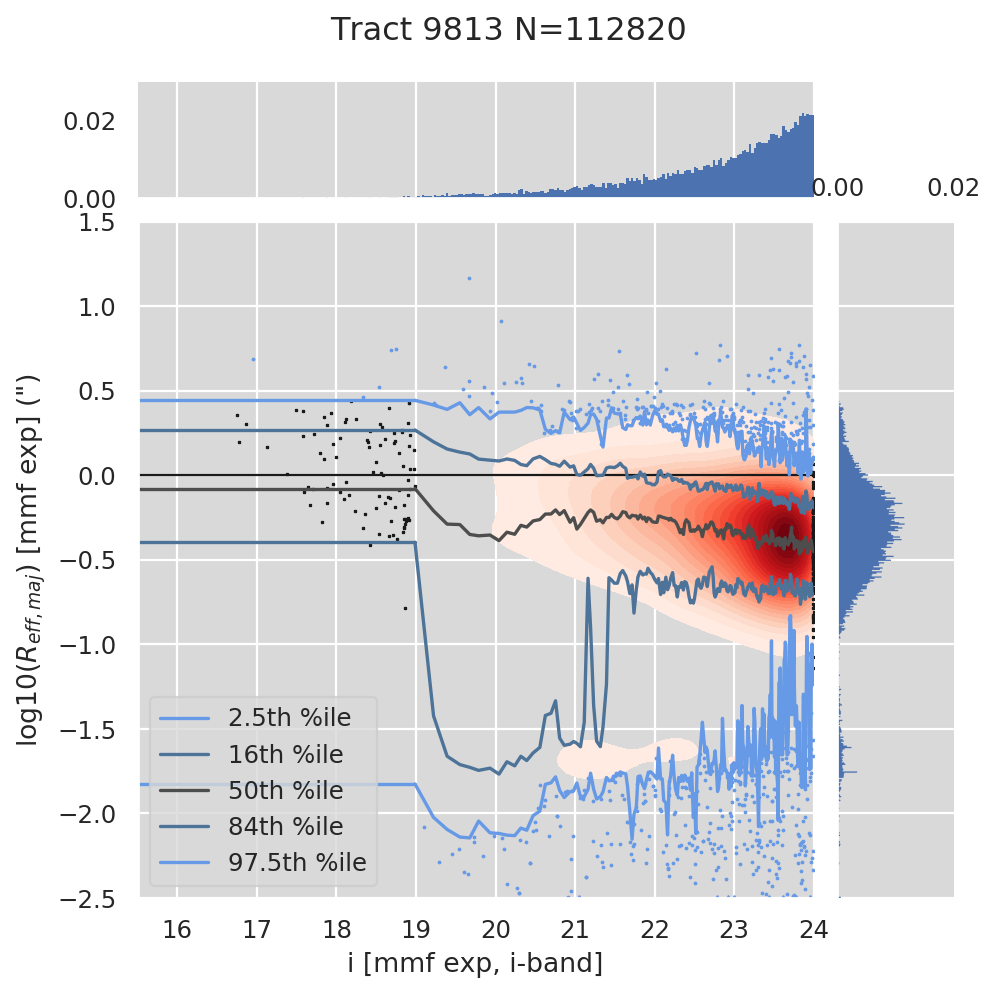

Plotting model exp plot mag_i_bright_reff_mpf


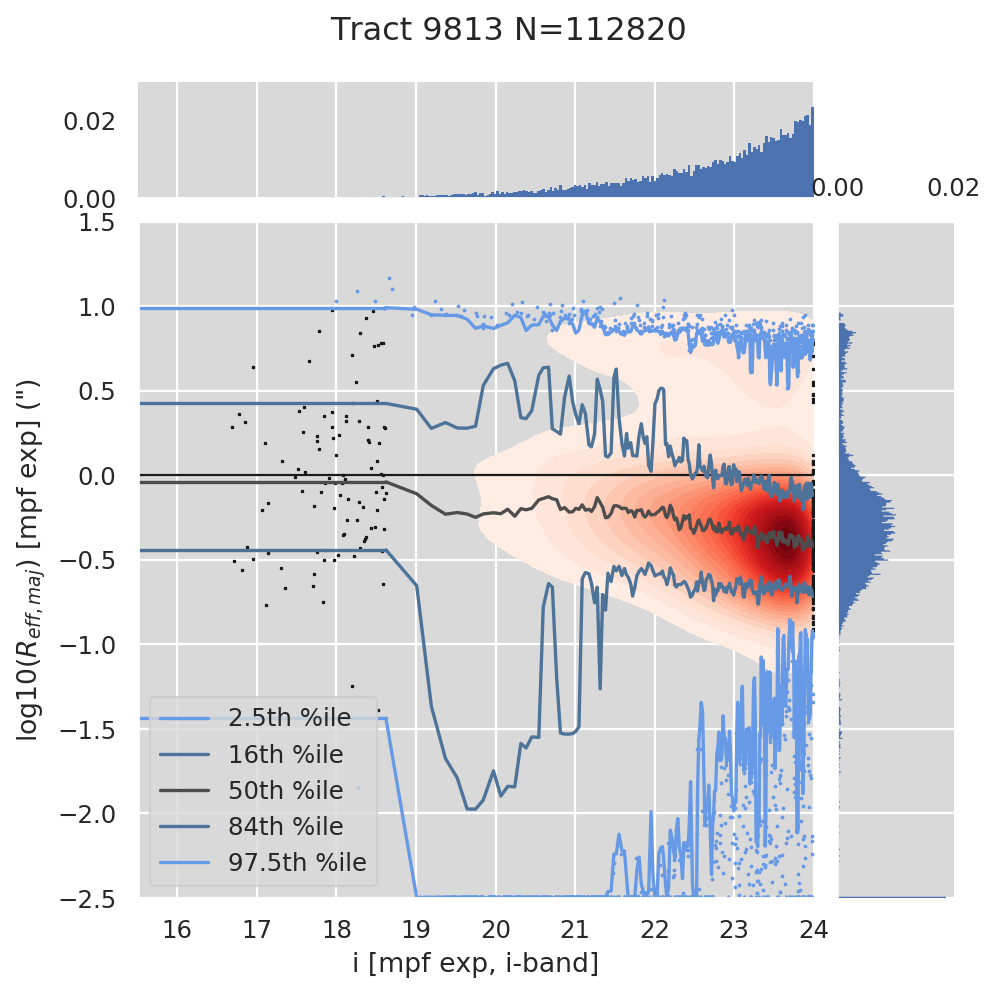

Plotting model dev plot loglike


/software/lsstsw/stack_20200922/conda/miniconda3-py37_4.8.2/envs/lsst-scipipe/lib/python3.7/site-packages/ipykernel_launcher.py:38: RuntimeWarning: invalid value encountered in subtract


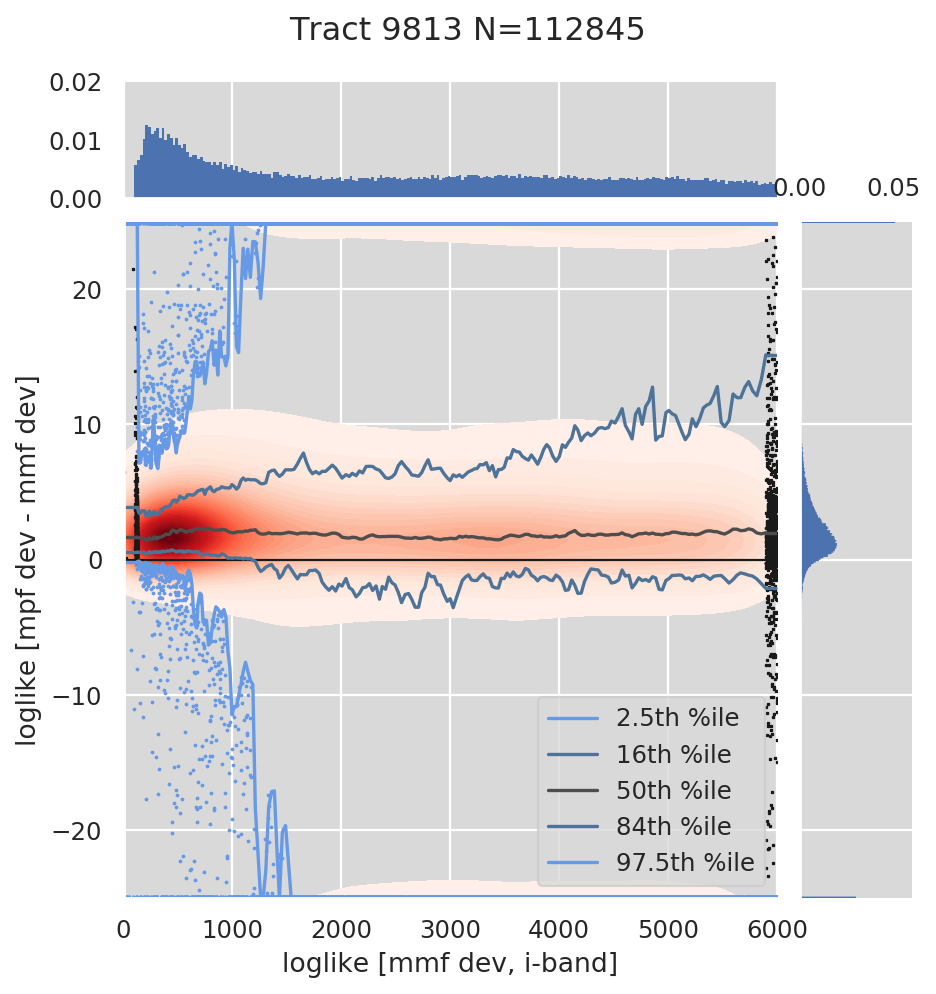

Plotting model dev plot time


/software/lsstsw/stack_20200922/conda/miniconda3-py37_4.8.2/envs/lsst-scipipe/lib/python3.7/site-packages/ipykernel_launcher.py:40: RuntimeWarning: overflow encountered in true_divide


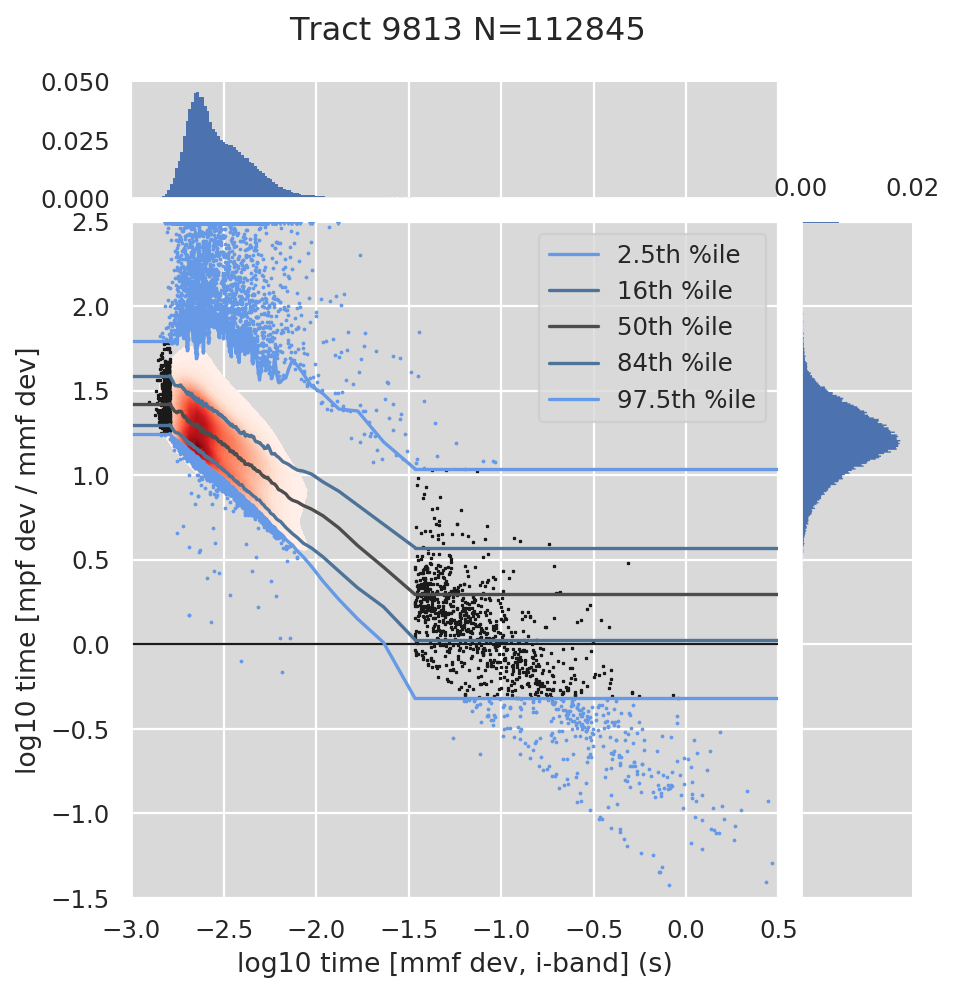

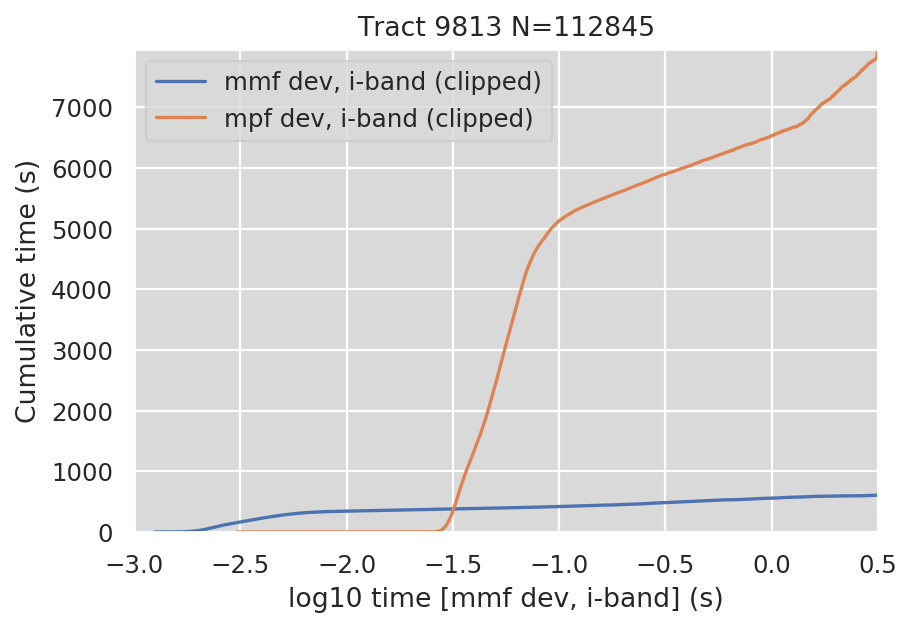

Plotting model dev plot mag_i


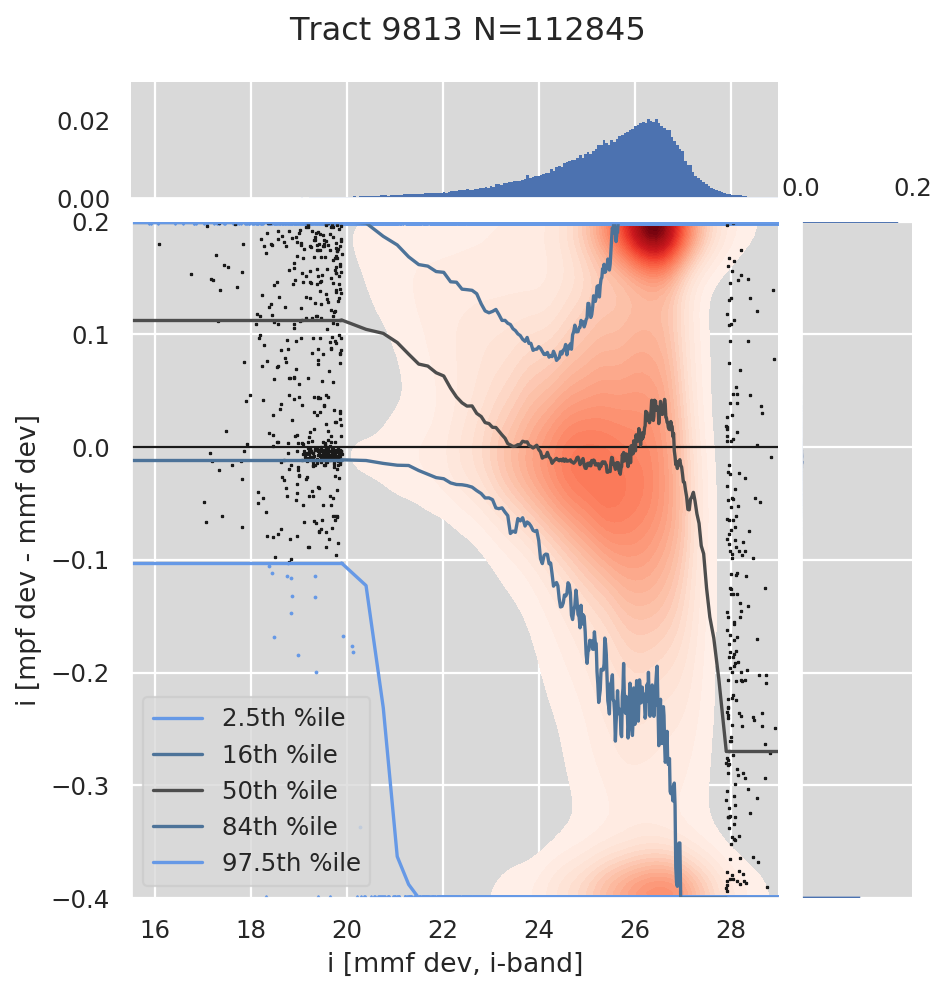

Plotting model dev plot mag_i_bright


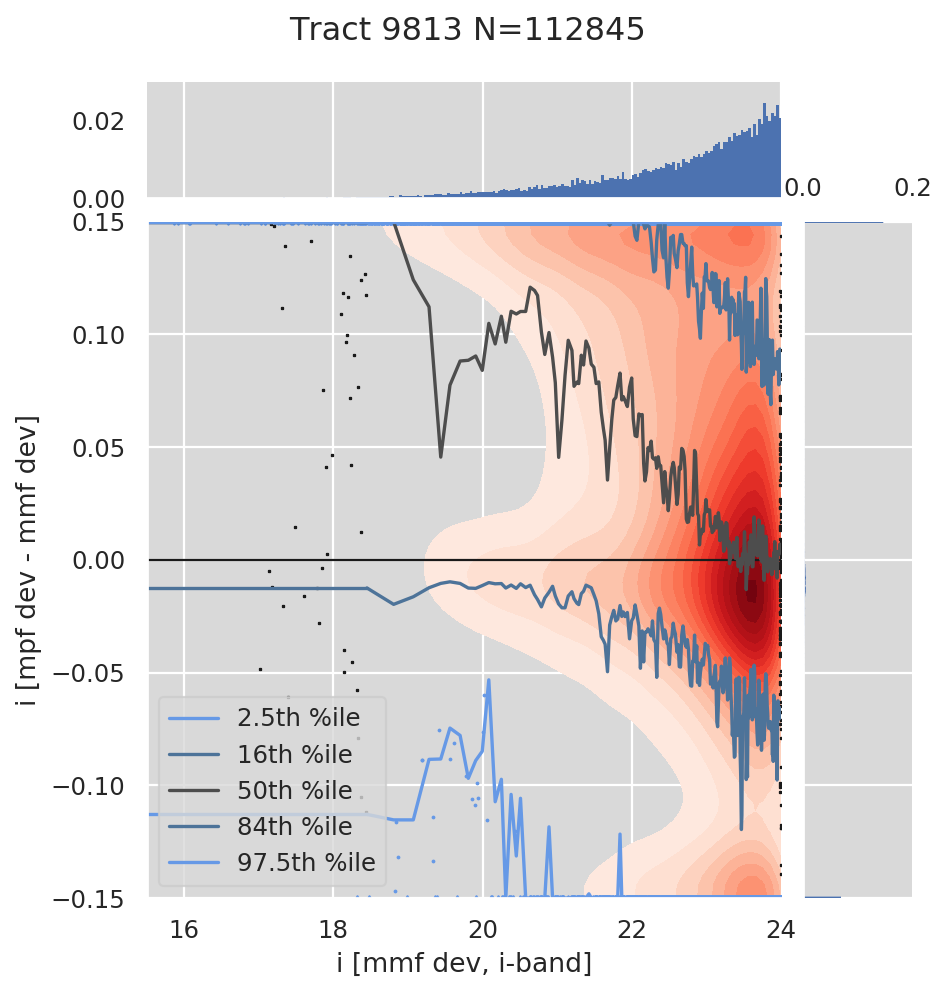

Plotting model dev plot reff


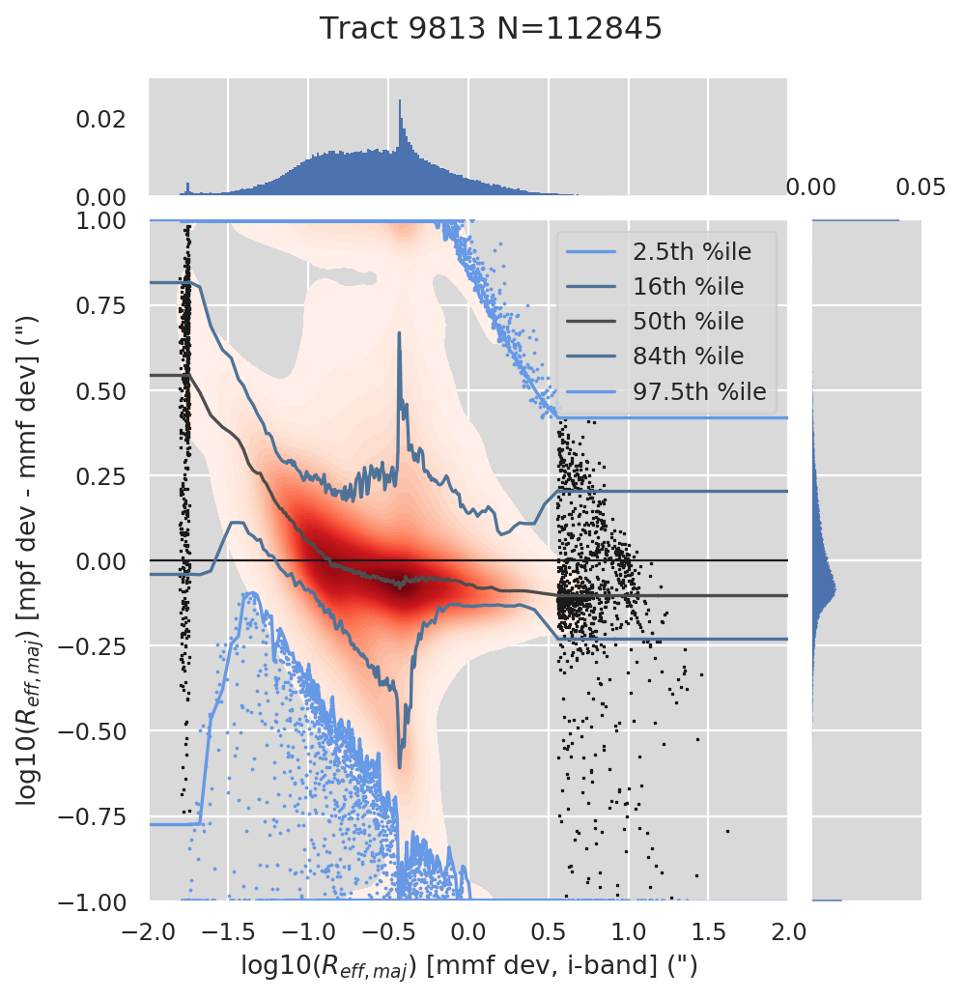

Plotting model dev plot mag_i_reff_mmf


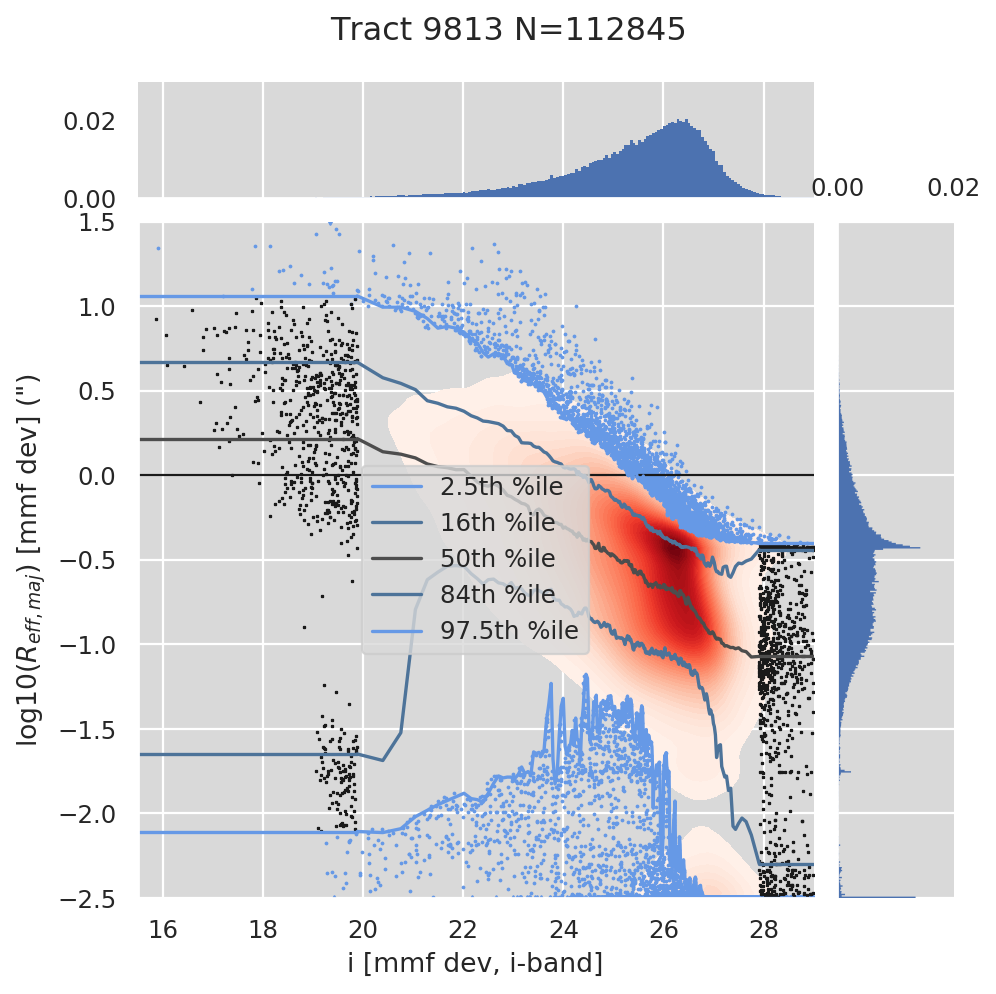

Plotting model dev plot mag_i_reff_mpf


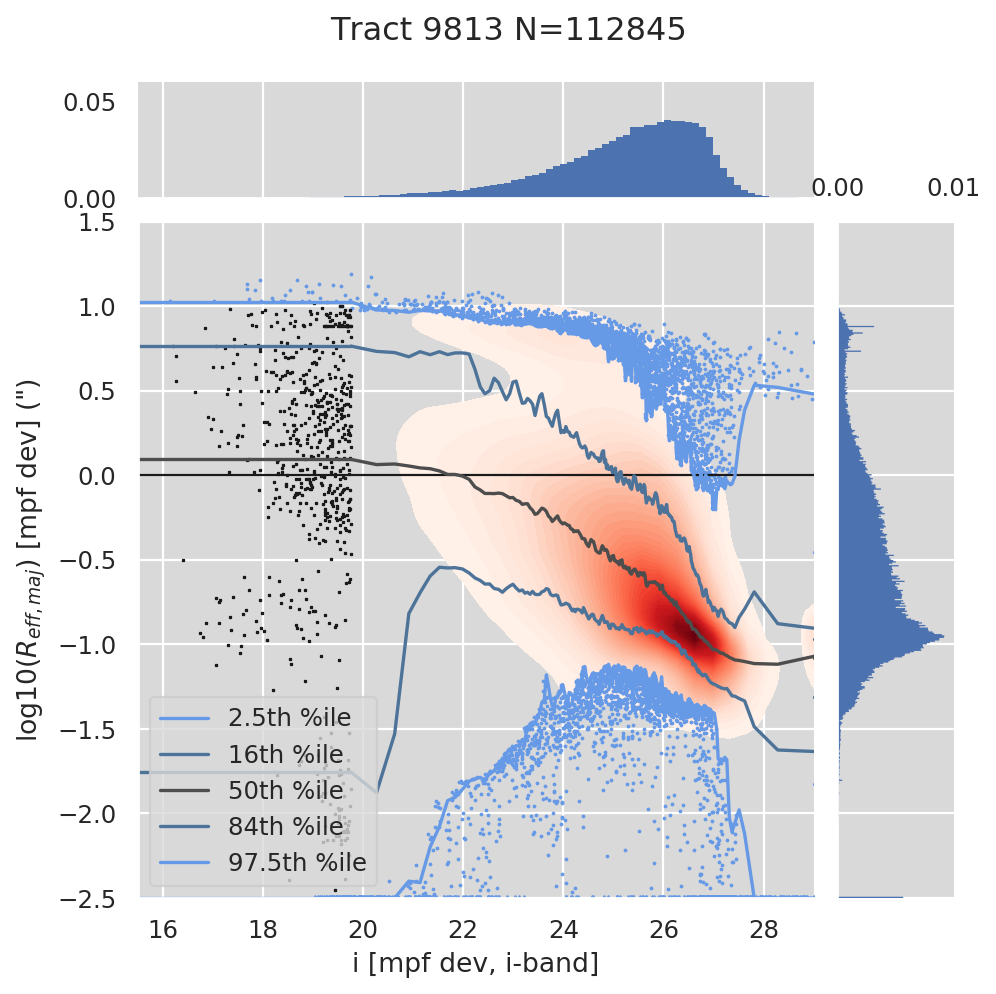

Plotting model dev plot mag_i_bright_reff_mmf


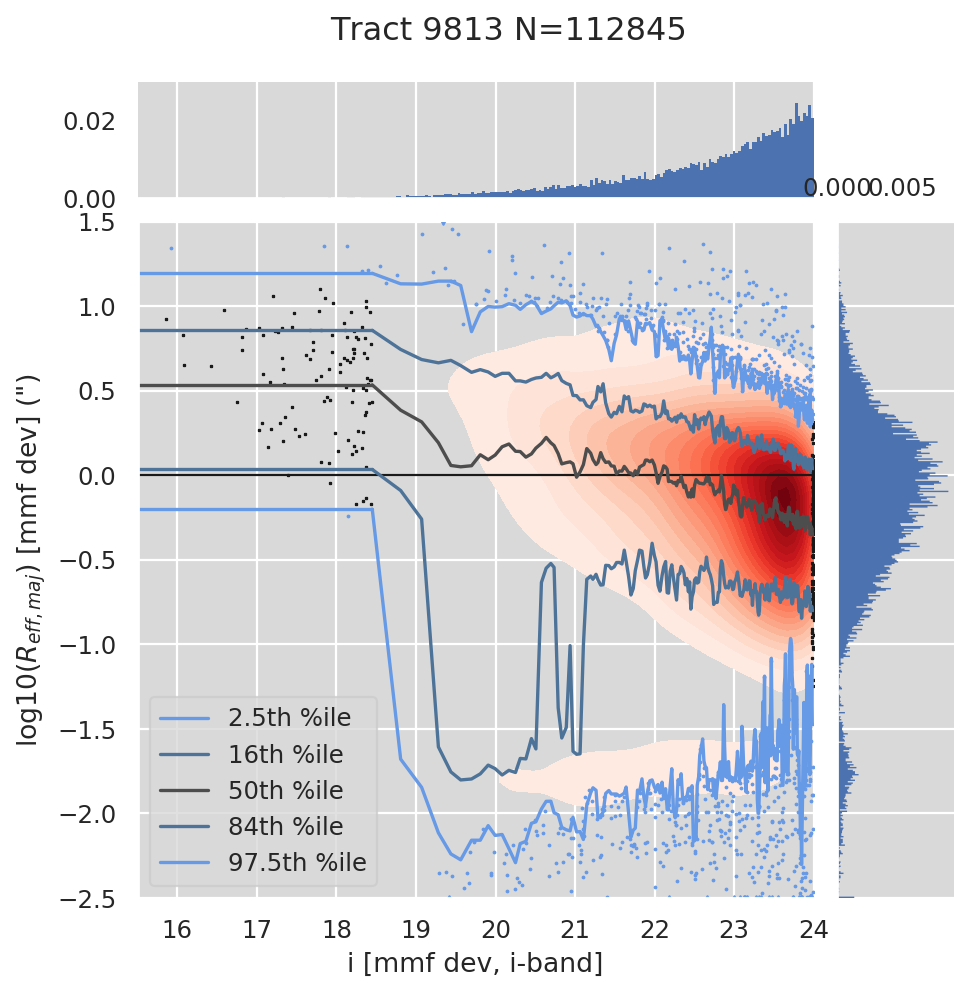

Plotting model dev plot mag_i_bright_reff_mpf


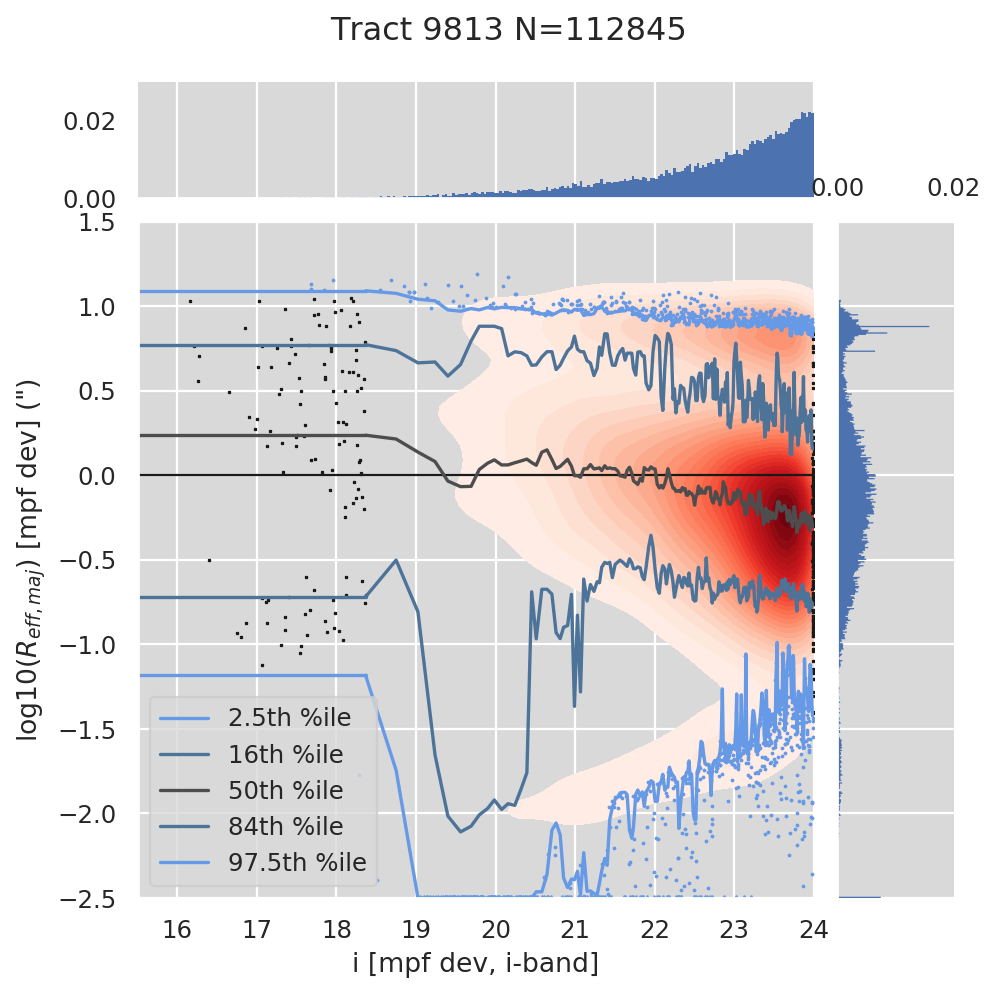

Plotting model cmodel plot loglike


/software/lsstsw/stack_20200922/conda/miniconda3-py37_4.8.2/envs/lsst-scipipe/lib/python3.7/site-packages/ipykernel_launcher.py:38: RuntimeWarning: invalid value encountered in subtract


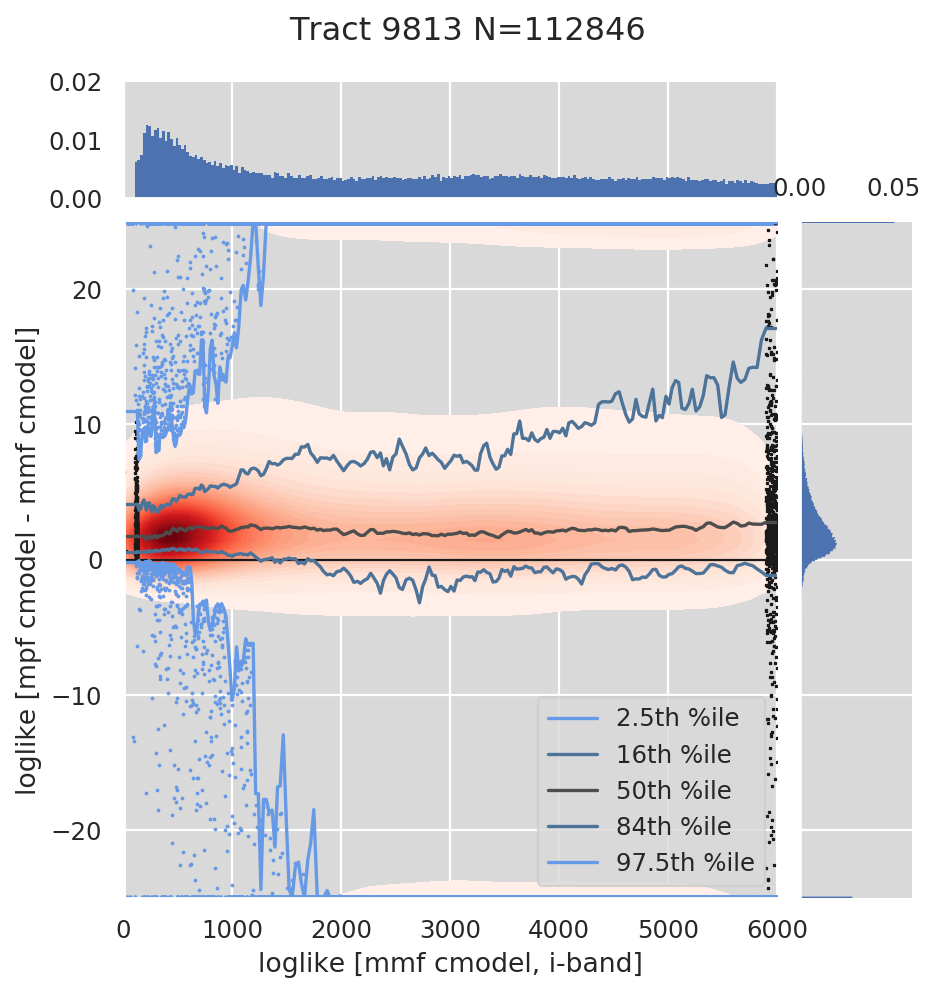

Plotting model cmodel plot time


/software/lsstsw/stack_20200922/conda/miniconda3-py37_4.8.2/envs/lsst-scipipe/lib/python3.7/site-packages/ipykernel_launcher.py:40: RuntimeWarning: overflow encountered in true_divide


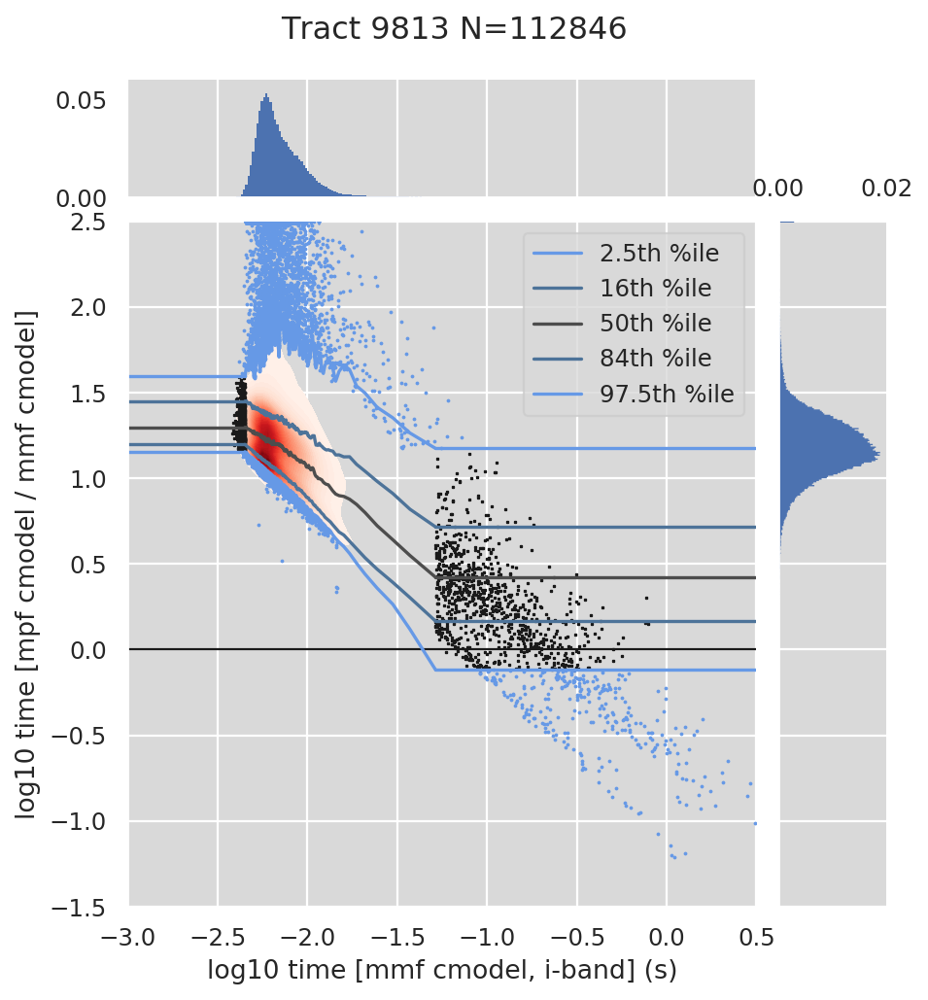

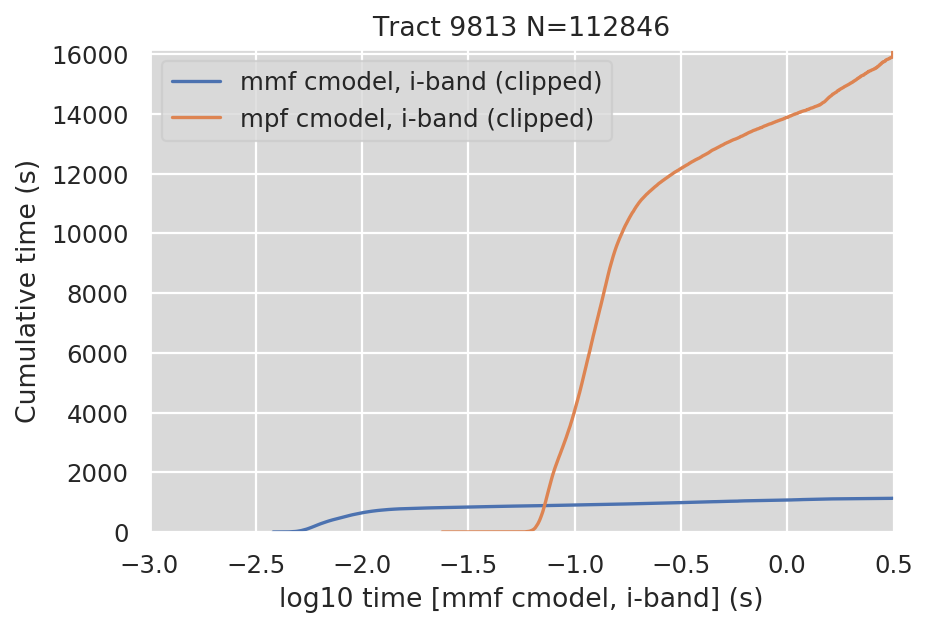

Plotting model cmodel plot mag_i


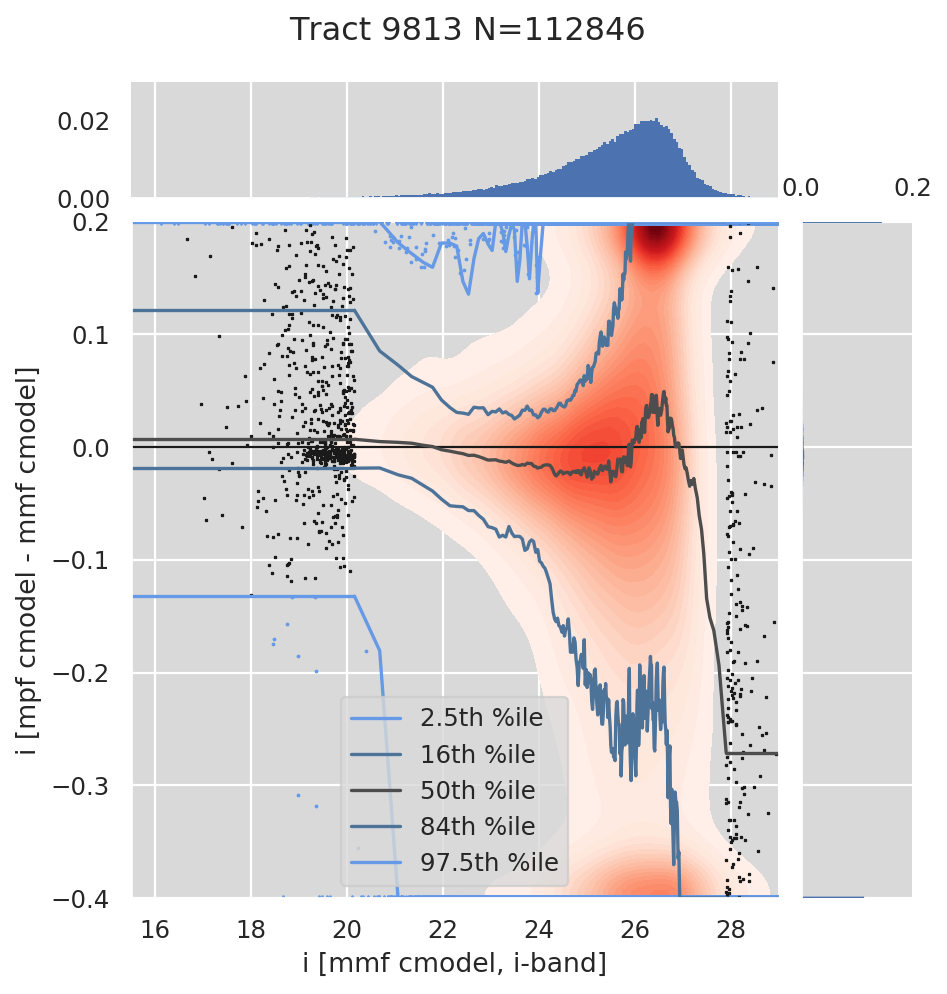

Plotting model cmodel plot mag_i_bright


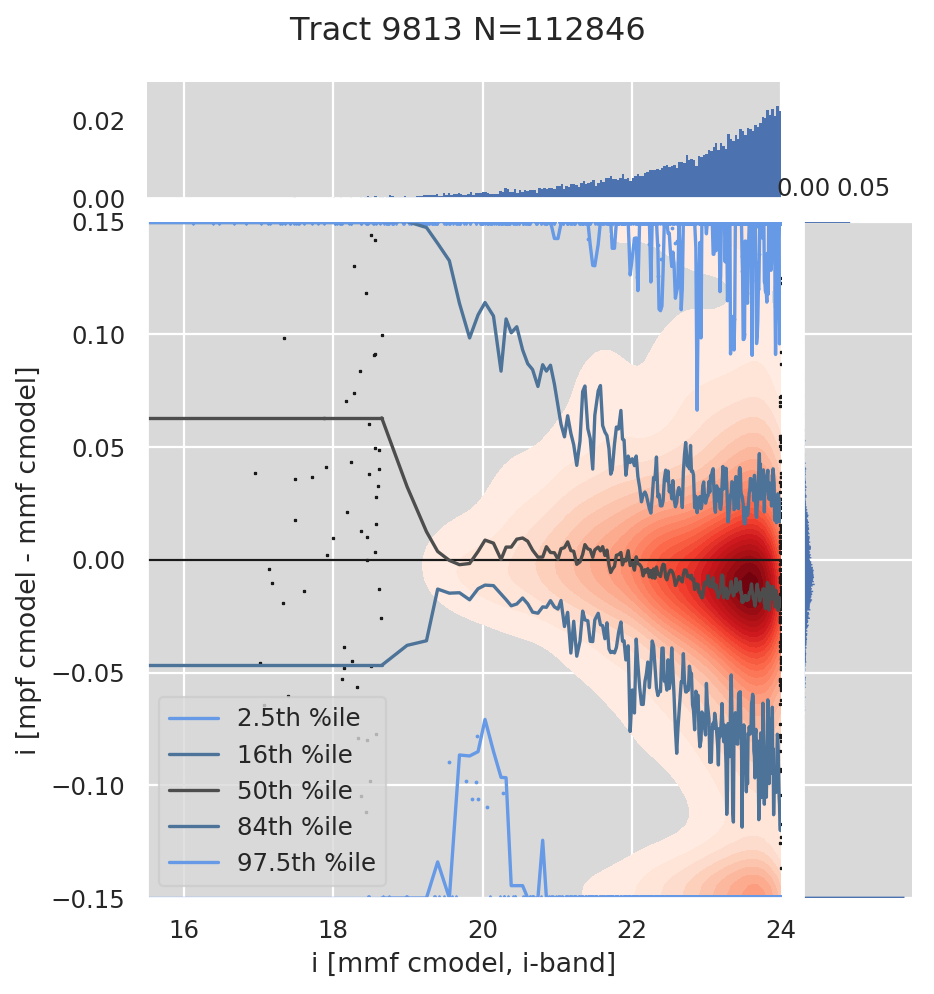

In [9]:
# Plot i-band MMF vs MPF
plot_models(data, "i", ("mmf", "mpf"), columns_plot, columns_plot_size, labels=labels, argspj=argspj)

## Comparing i-band meas_modelfit vs MultiProFit multiband

To be clear, these are comparing only the i-band parameters from the MultiProFit griz simultaneous fit. Some structural parameters are shared across bands (all of them for single Sersic fits). meas_modelfit is i-band only as before.

Right now the log likelihood plots are sadly useless because they include all bands for MultiProFit but only i-band for meas_modelfit.

The plots and conclusions therefrom are fairly similar to i-band only. Combined with the fact that the runtime scaling is close to optimal (slightly sub-linear with number of bands), this is an encouraging sign that multiband fits are practical.

Plotting model exp plot loglike


/software/lsstsw/stack_20200922/conda/miniconda3-py37_4.8.2/envs/lsst-scipipe/lib/python3.7/site-packages/ipykernel_launcher.py:38: RuntimeWarning: invalid value encountered in subtract


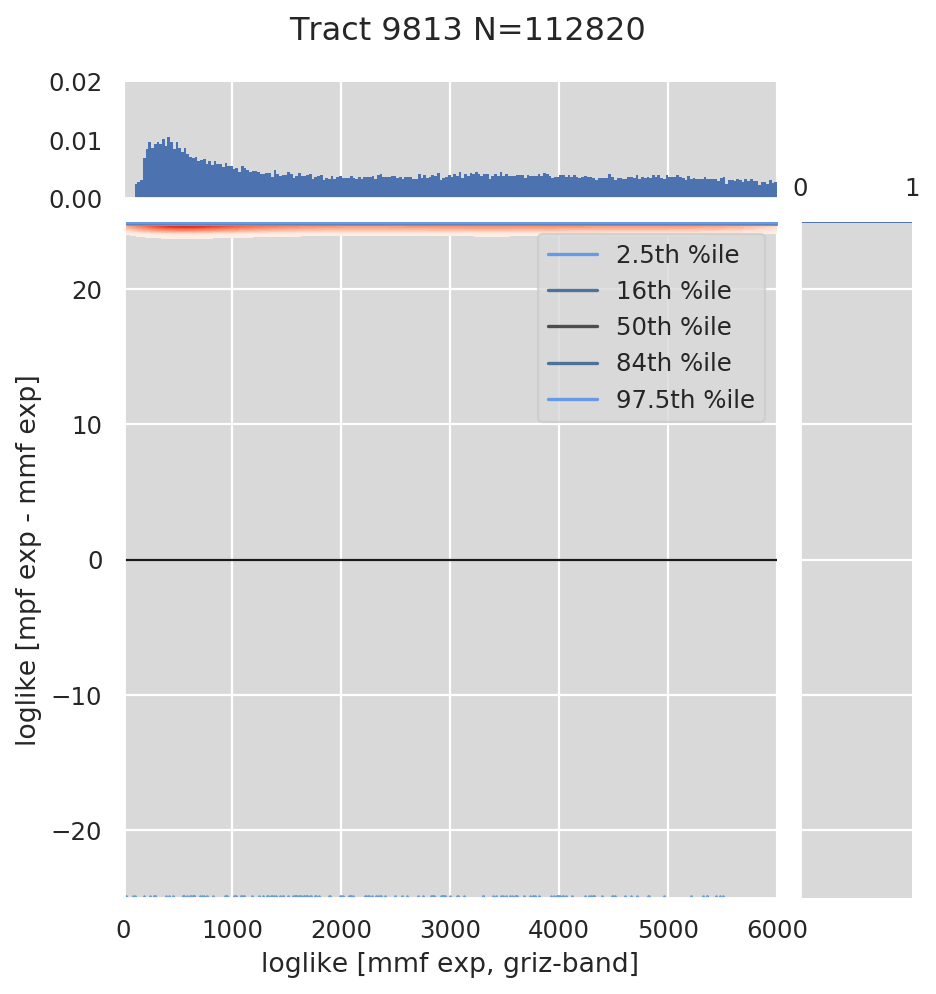

Plotting model exp plot time


/software/lsstsw/stack_20200922/conda/miniconda3-py37_4.8.2/envs/lsst-scipipe/lib/python3.7/site-packages/ipykernel_launcher.py:40: RuntimeWarning: overflow encountered in true_divide


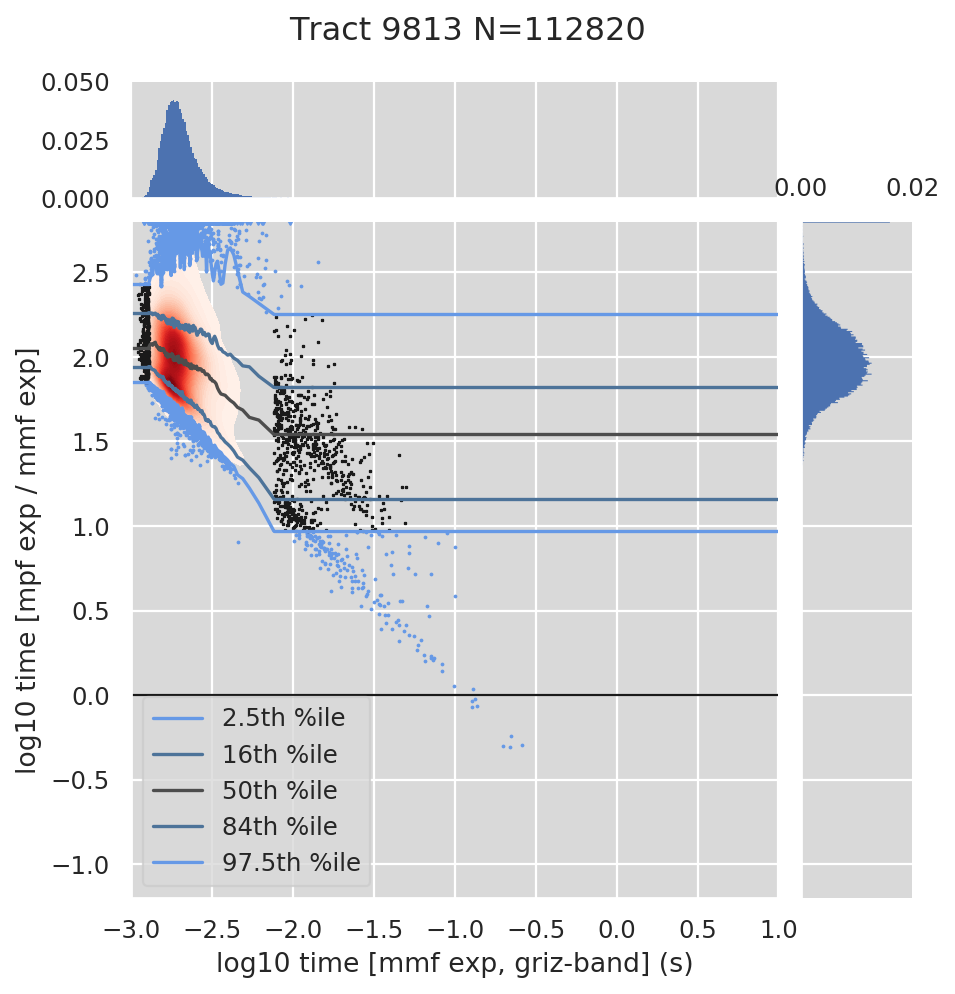

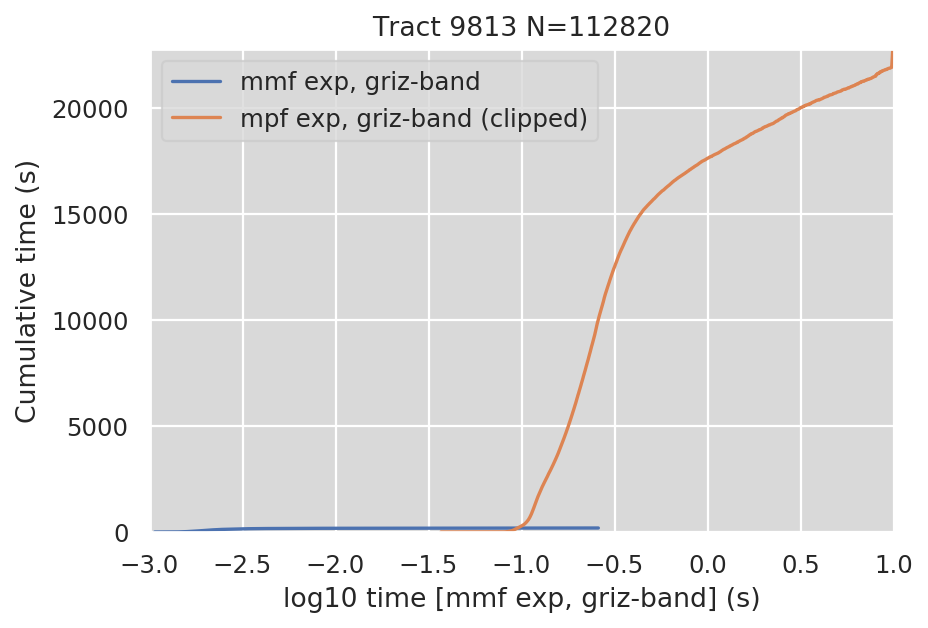

Plotting model exp plot mag_i


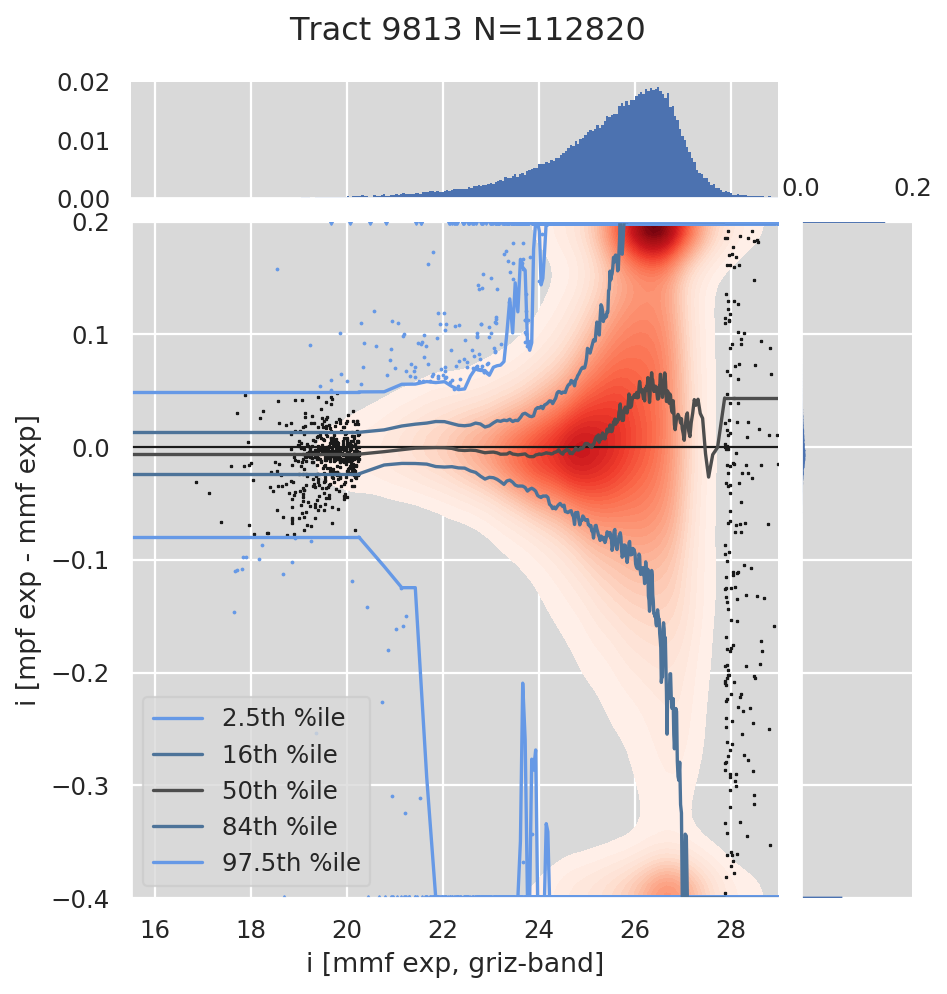

Plotting model exp plot mag_i_bright


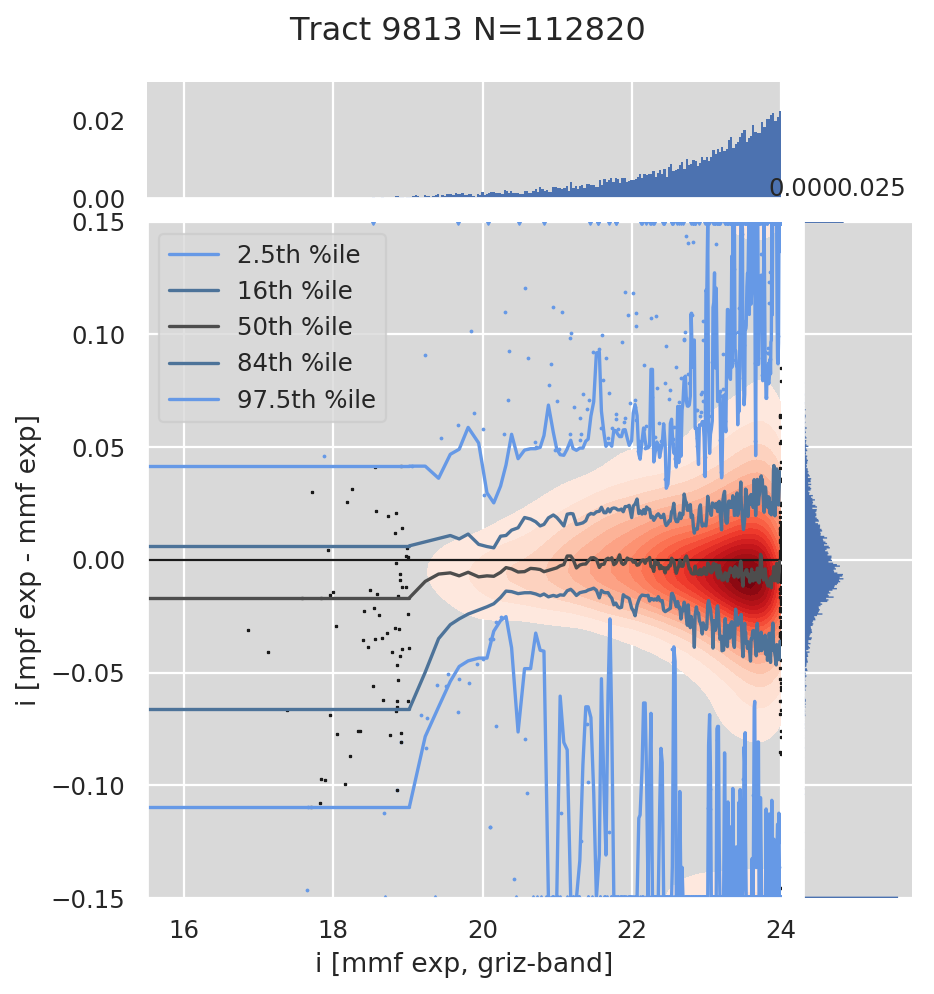

Plotting model exp plot reff


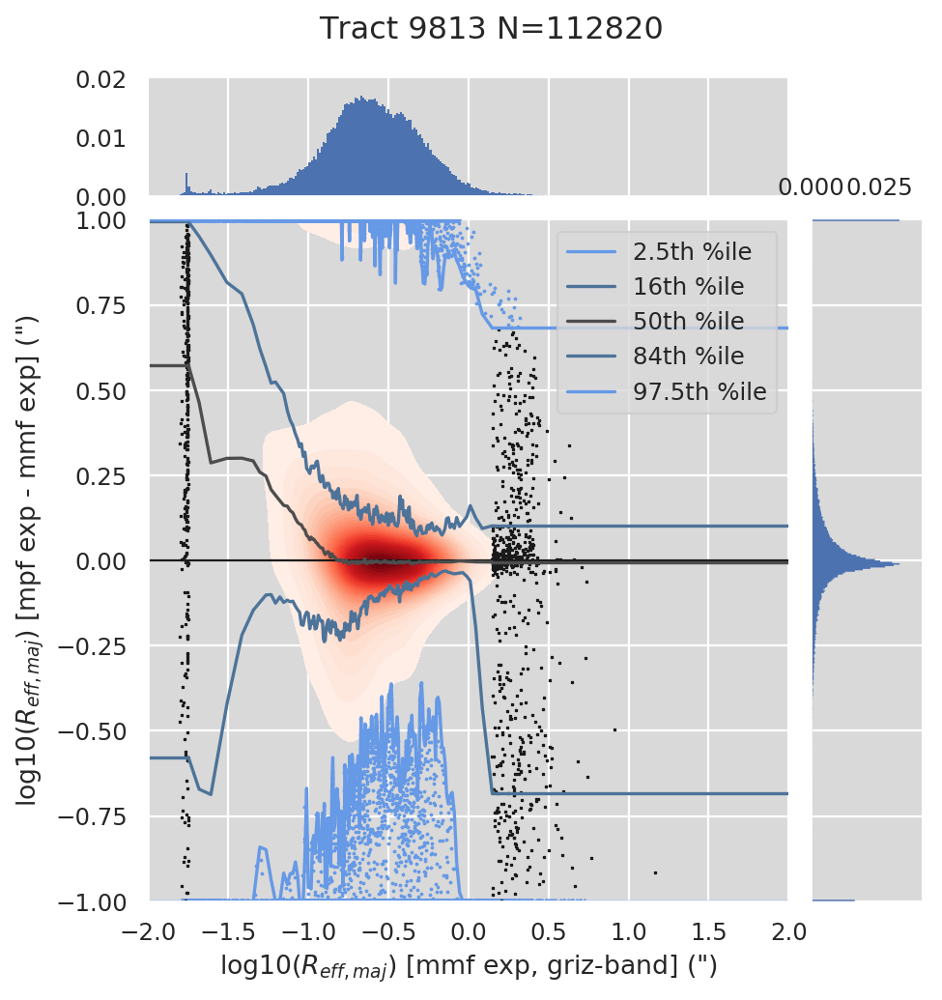

Plotting model exp plot mag_i_reff_mmf


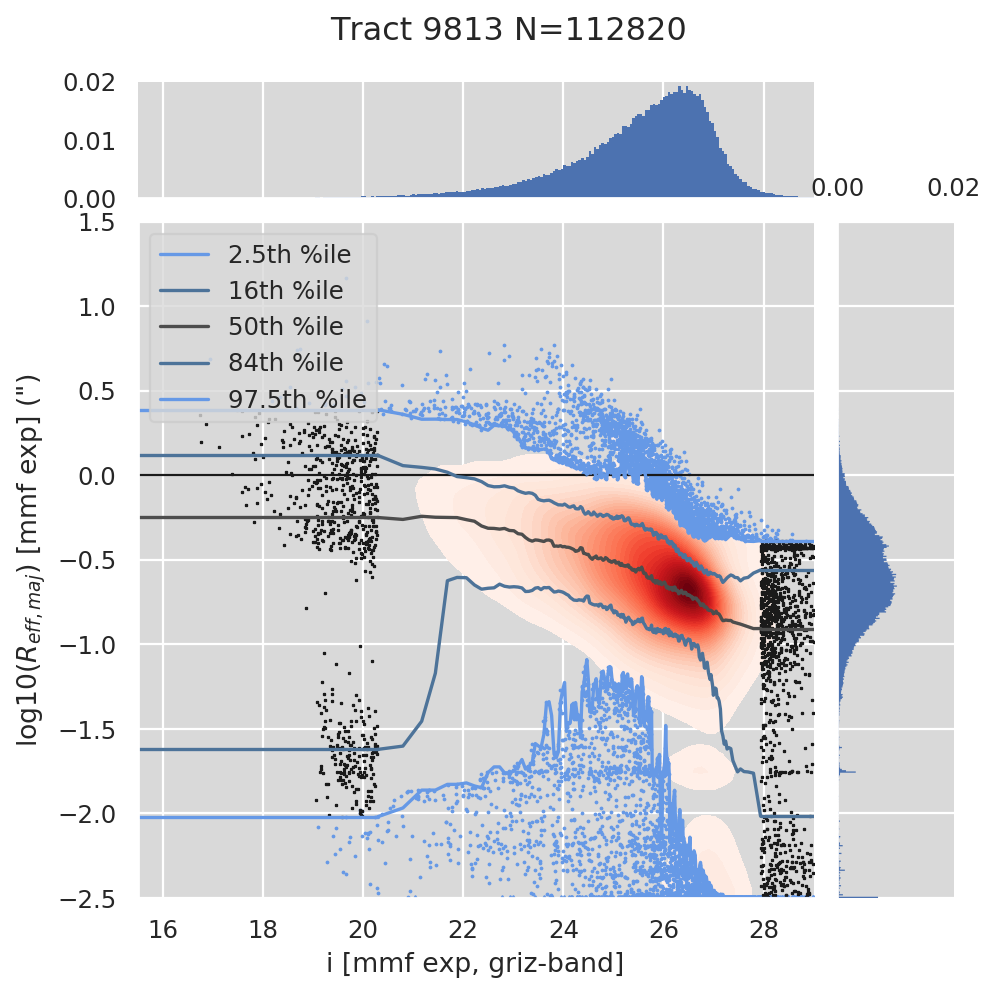

Plotting model exp plot mag_i_reff_mpf


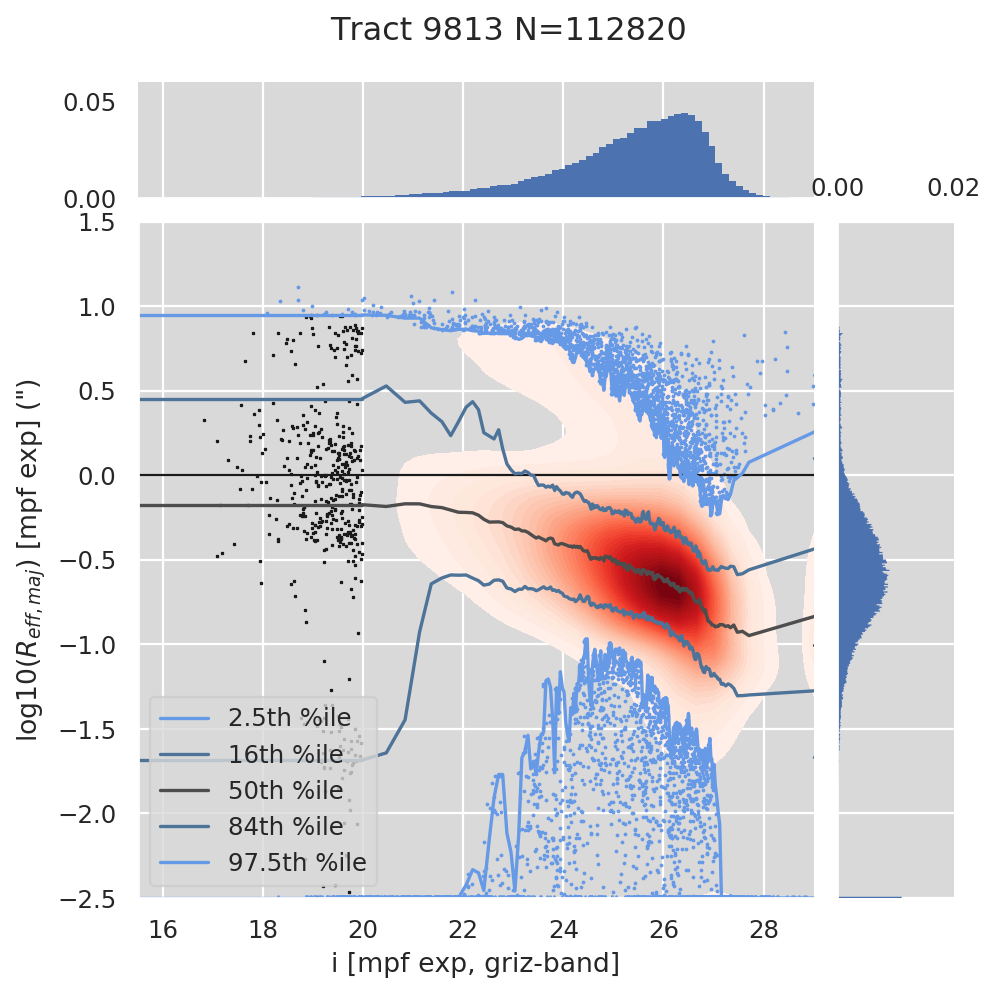

Plotting model exp plot mag_i_bright_reff_mmf


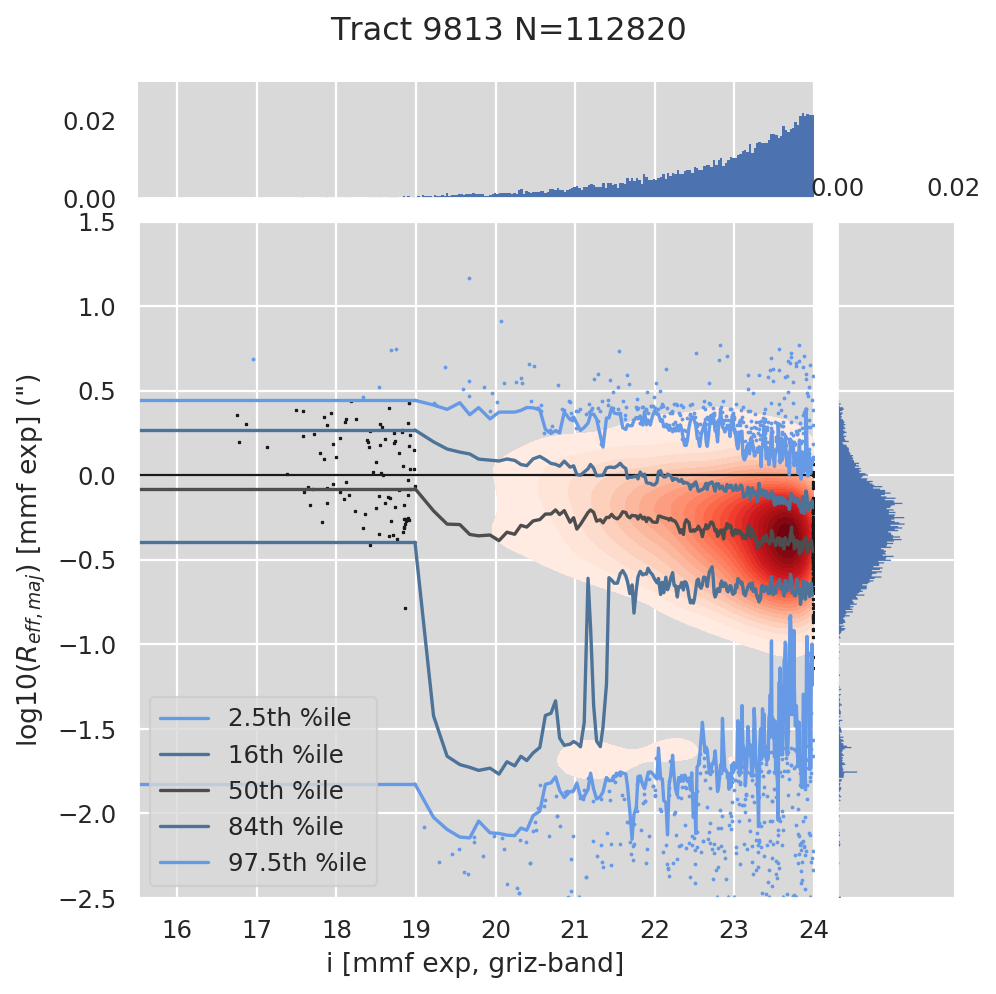

Plotting model exp plot mag_i_bright_reff_mpf


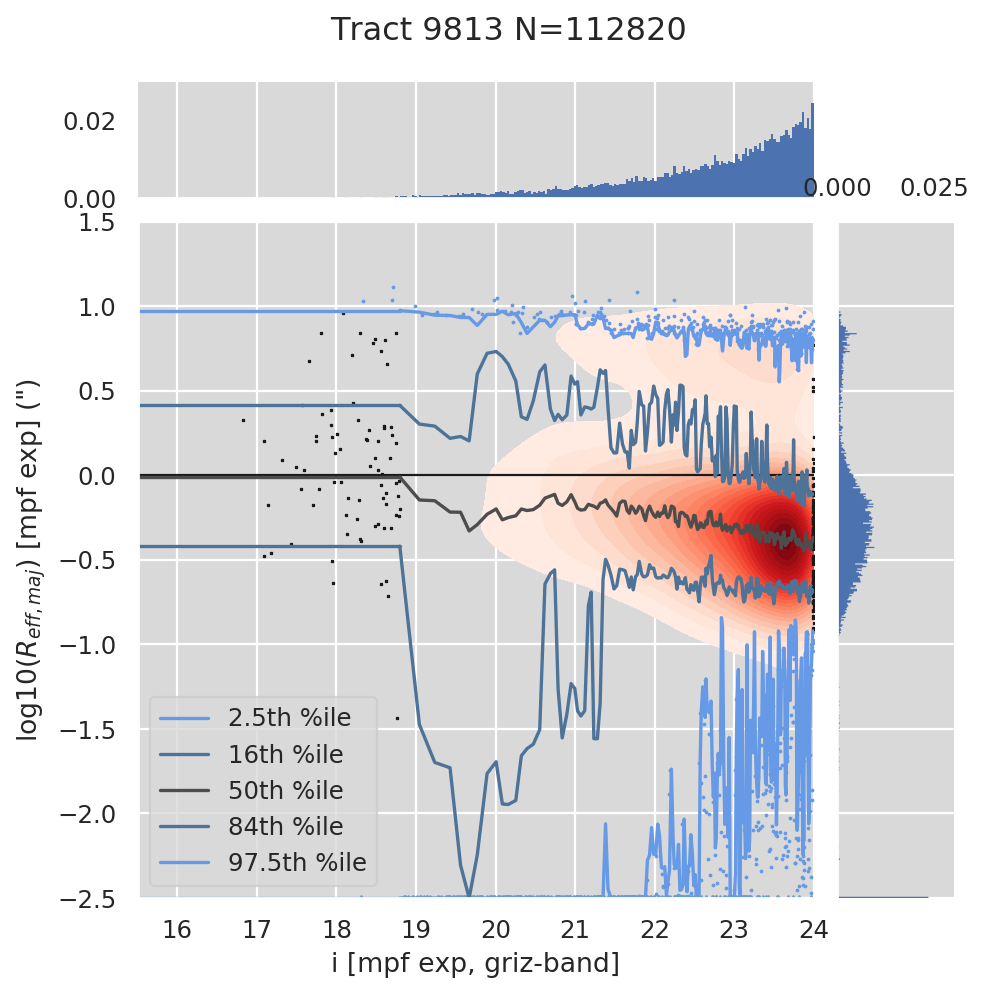

Plotting model dev plot loglike


/software/lsstsw/stack_20200922/conda/miniconda3-py37_4.8.2/envs/lsst-scipipe/lib/python3.7/site-packages/ipykernel_launcher.py:38: RuntimeWarning: invalid value encountered in subtract


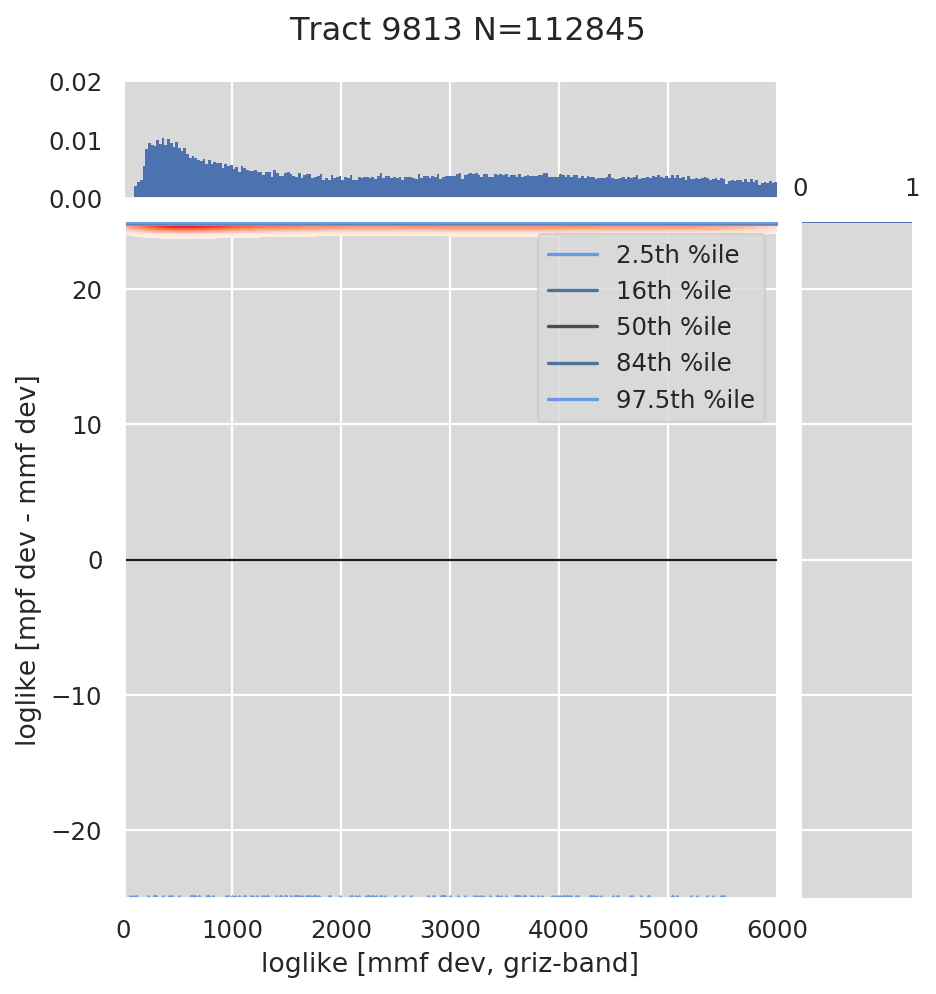

Plotting model dev plot time


/software/lsstsw/stack_20200922/conda/miniconda3-py37_4.8.2/envs/lsst-scipipe/lib/python3.7/site-packages/ipykernel_launcher.py:40: RuntimeWarning: overflow encountered in true_divide


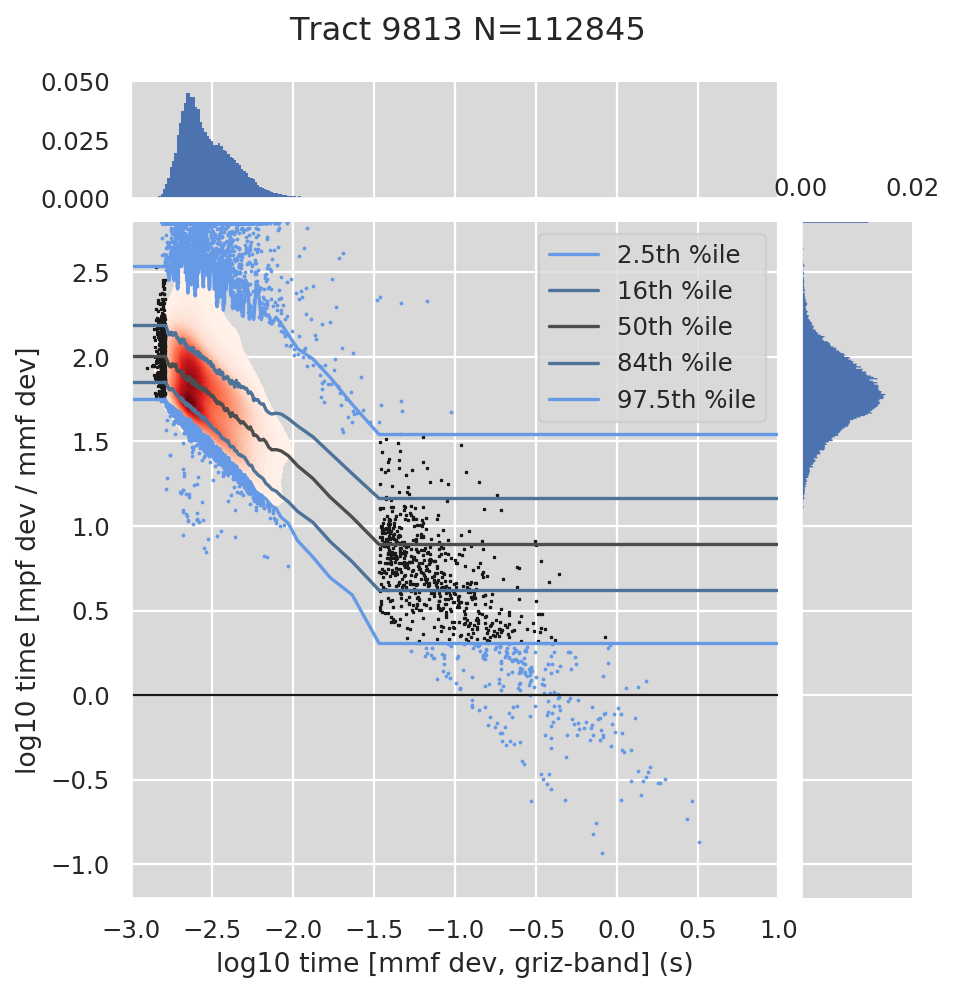

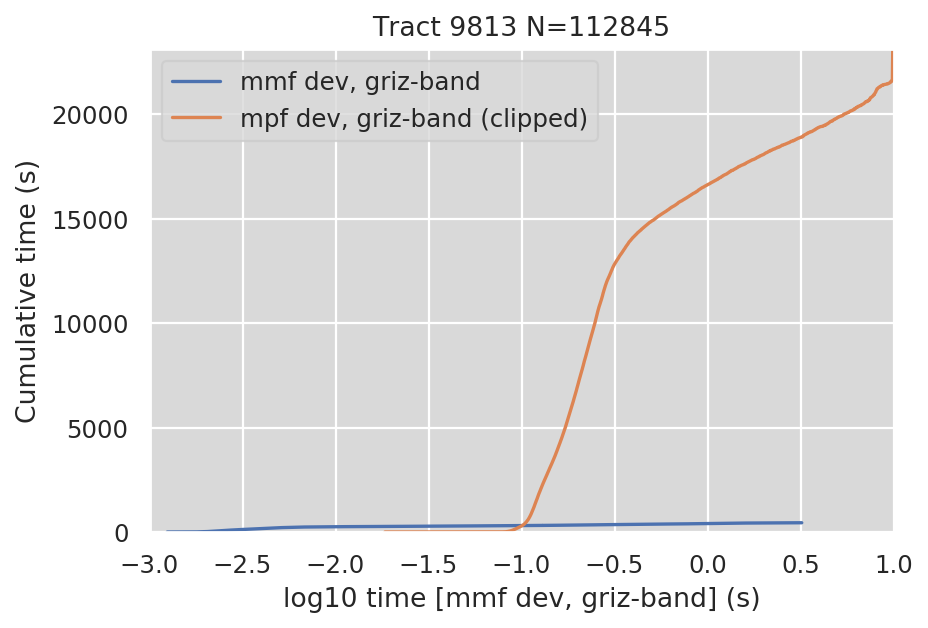

Plotting model dev plot mag_i


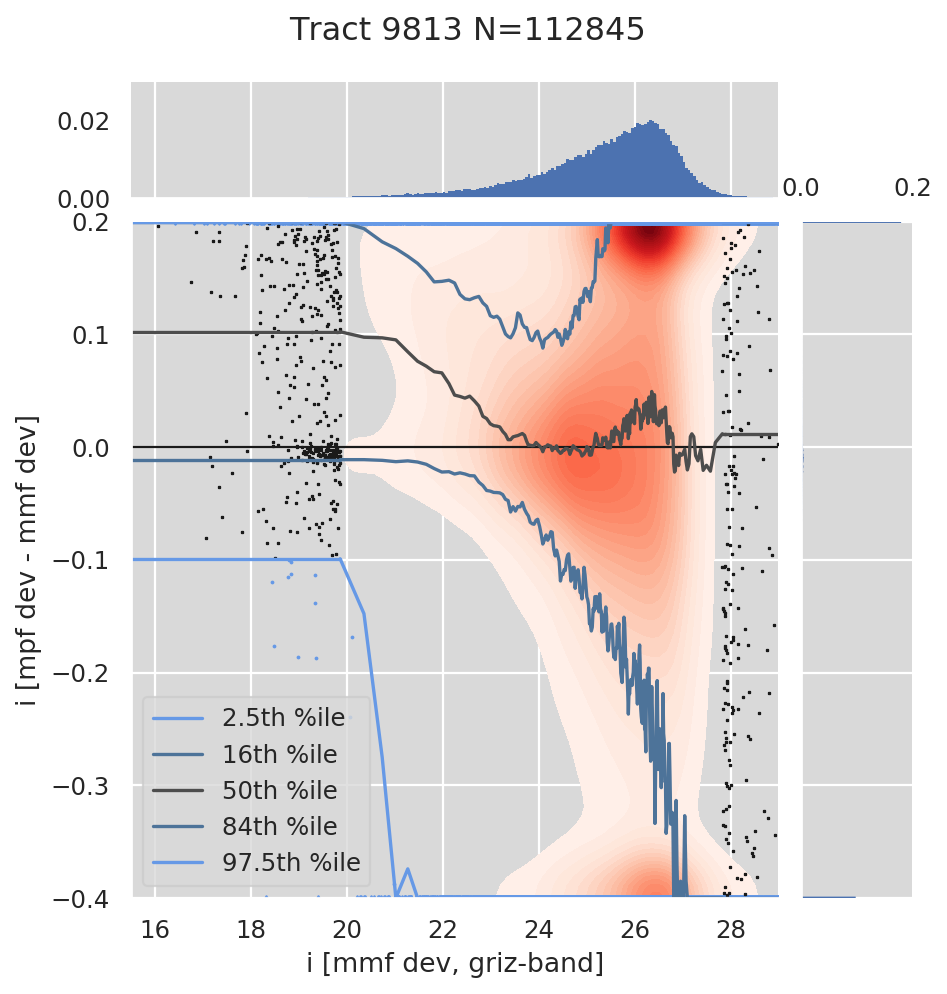

Plotting model dev plot mag_i_bright


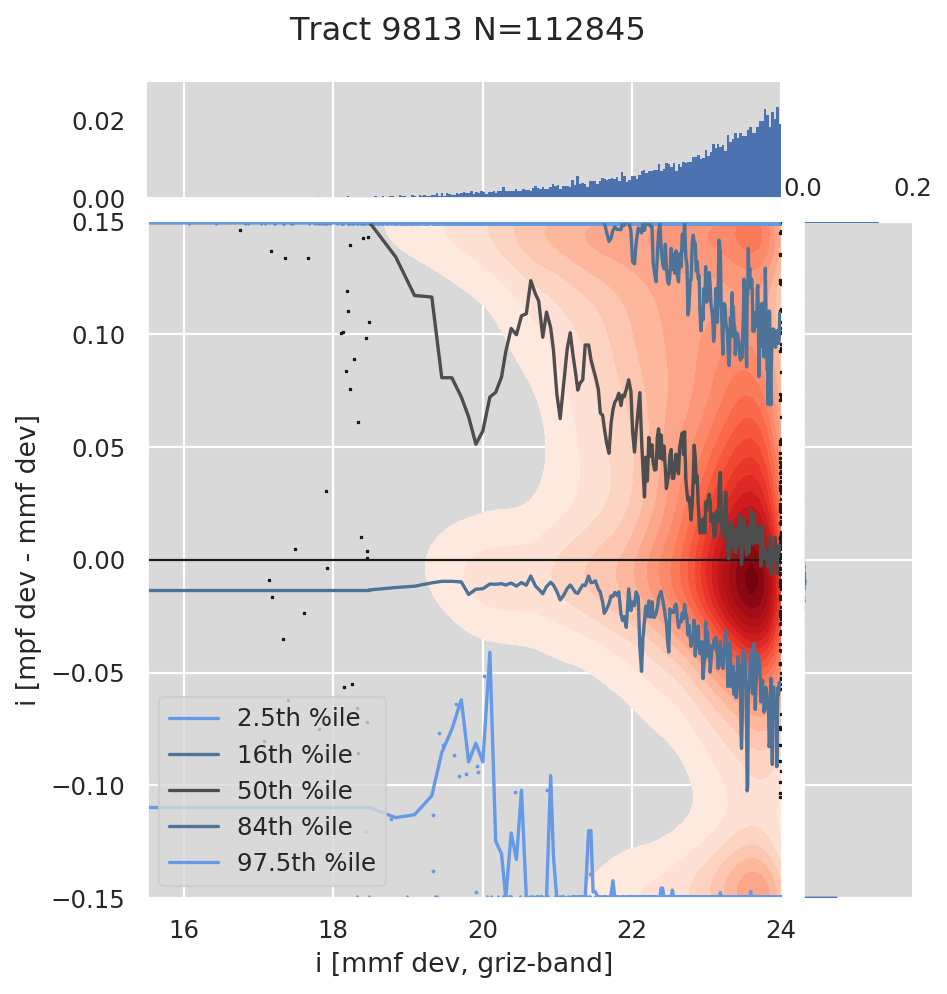

Plotting model dev plot reff


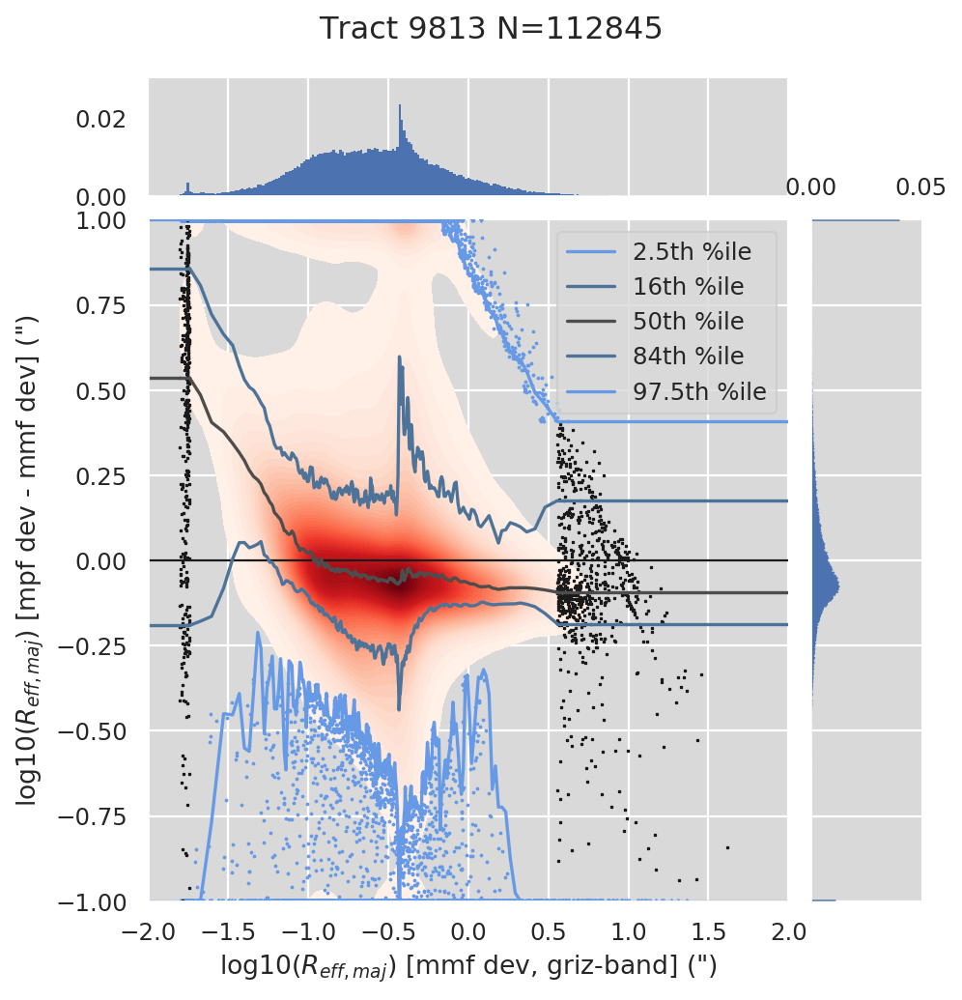

Plotting model dev plot mag_i_reff_mmf


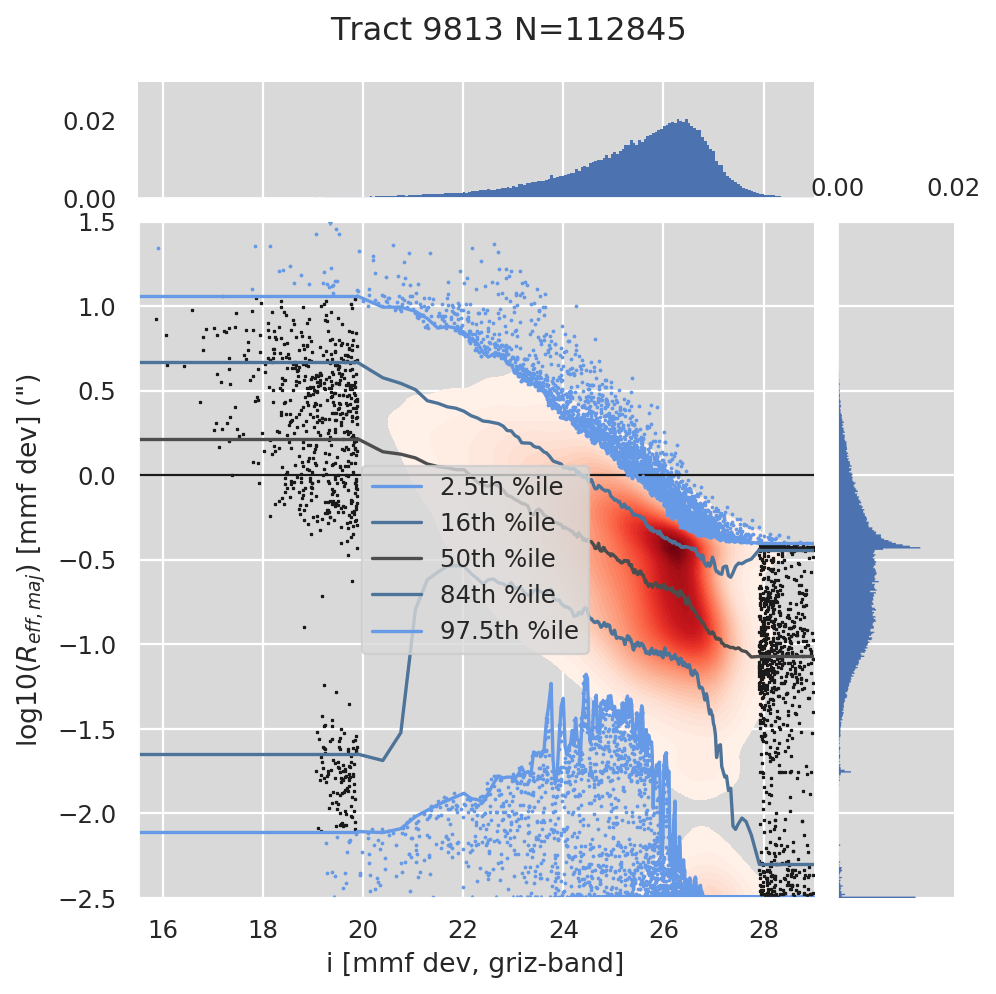

Plotting model dev plot mag_i_reff_mpf


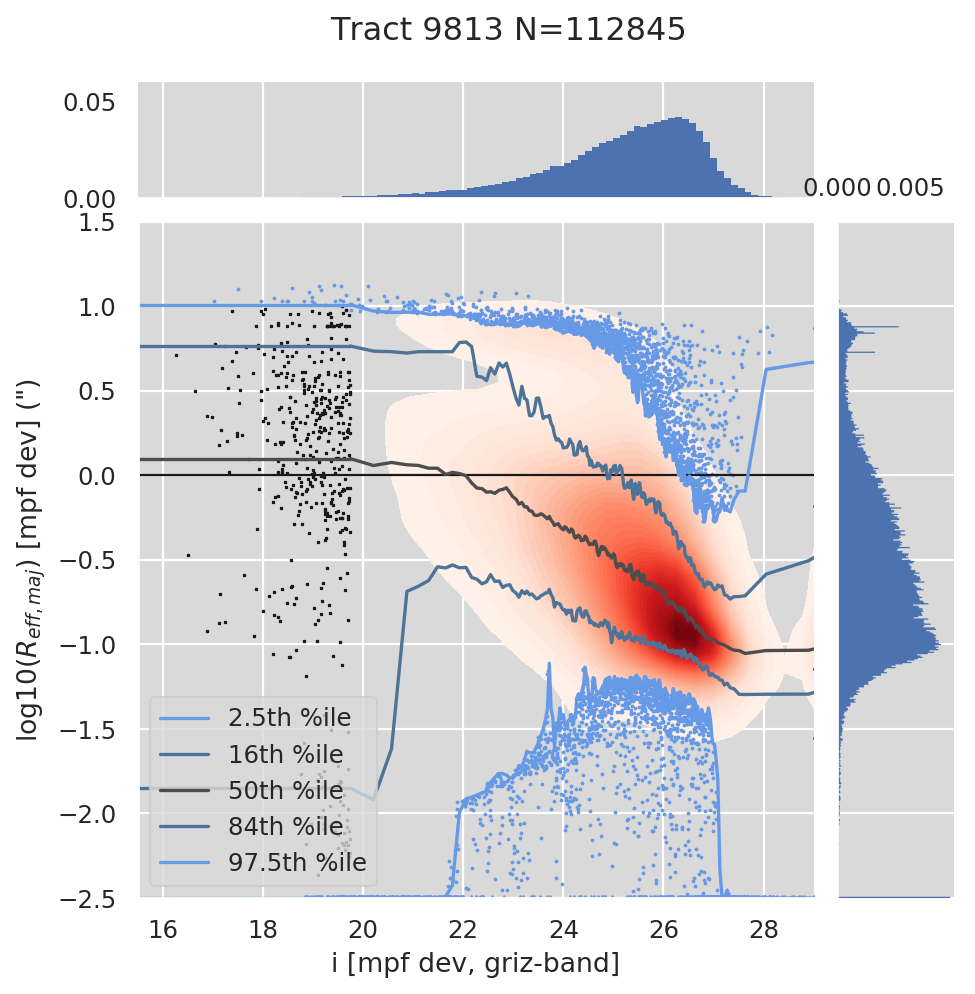

Plotting model dev plot mag_i_bright_reff_mmf


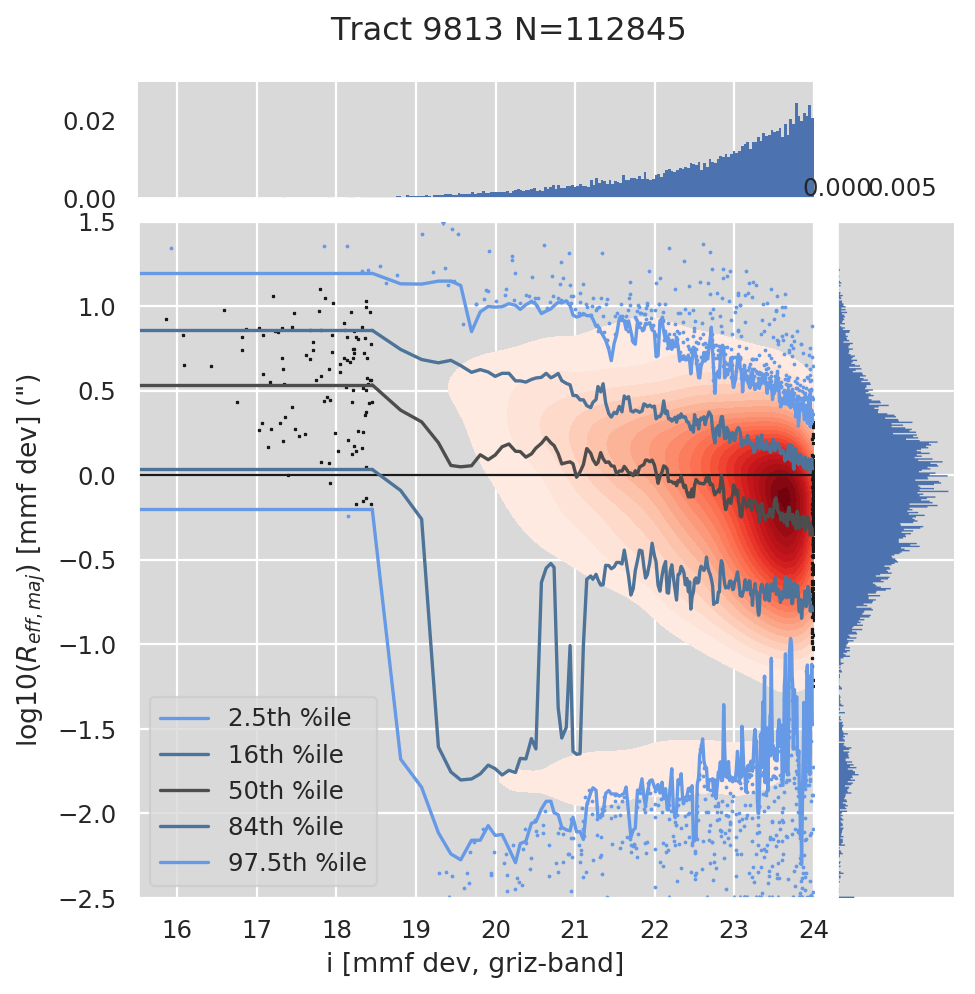

Plotting model dev plot mag_i_bright_reff_mpf


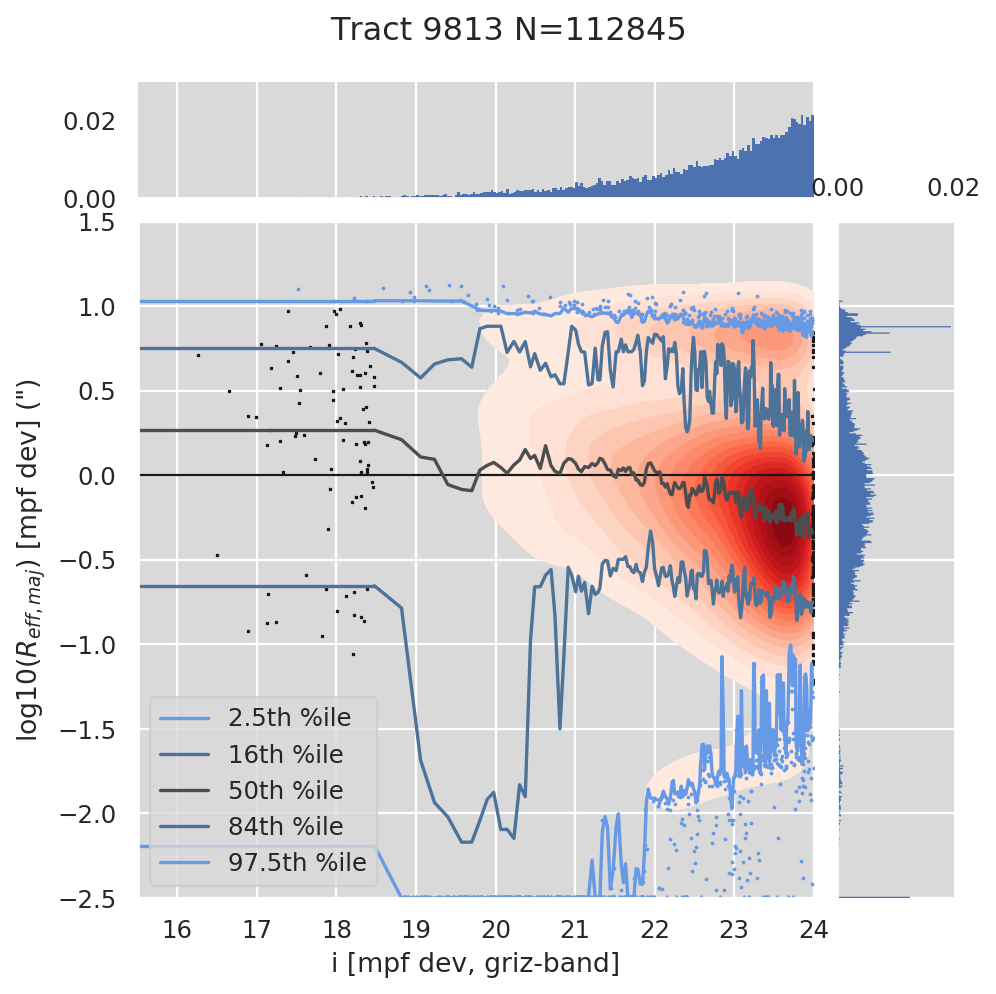

Plotting model cmodel plot loglike


/software/lsstsw/stack_20200922/conda/miniconda3-py37_4.8.2/envs/lsst-scipipe/lib/python3.7/site-packages/ipykernel_launcher.py:38: RuntimeWarning: invalid value encountered in subtract


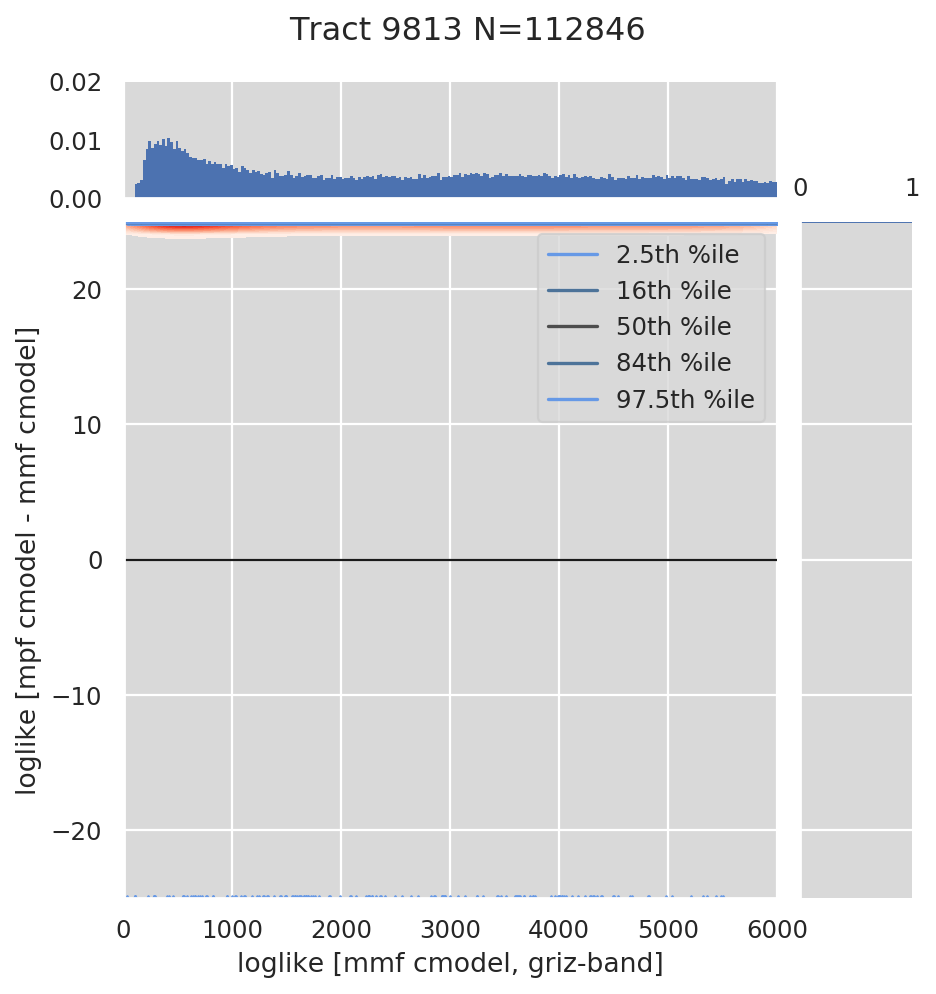

Plotting model cmodel plot time


/software/lsstsw/stack_20200922/conda/miniconda3-py37_4.8.2/envs/lsst-scipipe/lib/python3.7/site-packages/ipykernel_launcher.py:40: RuntimeWarning: overflow encountered in true_divide


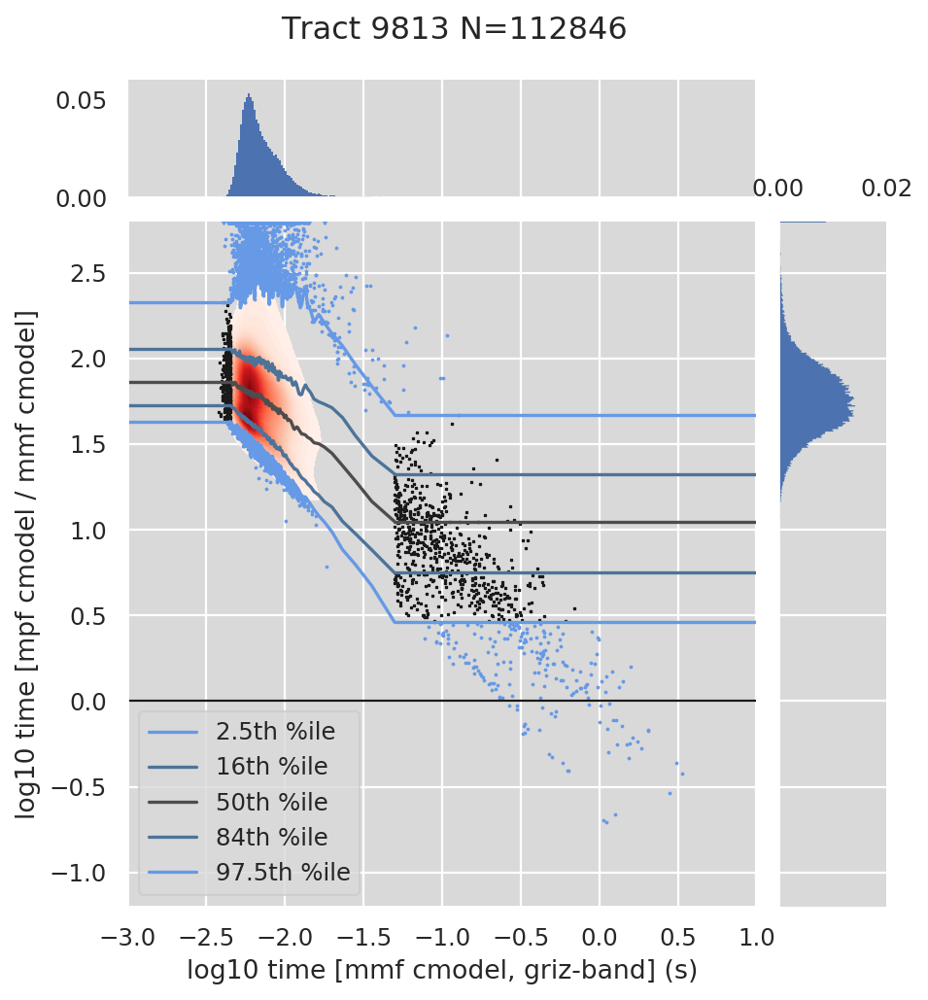

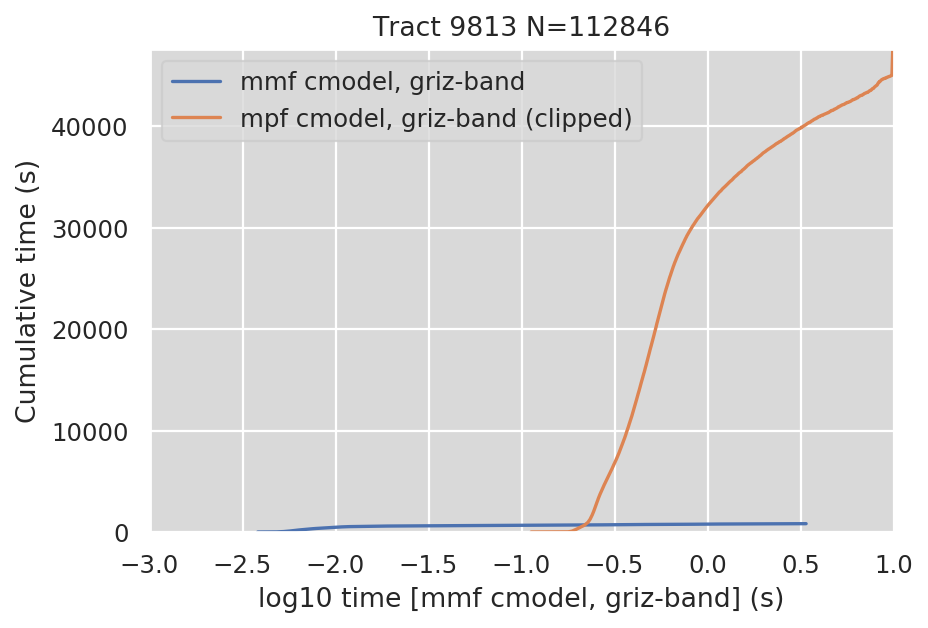

Plotting model cmodel plot mag_i


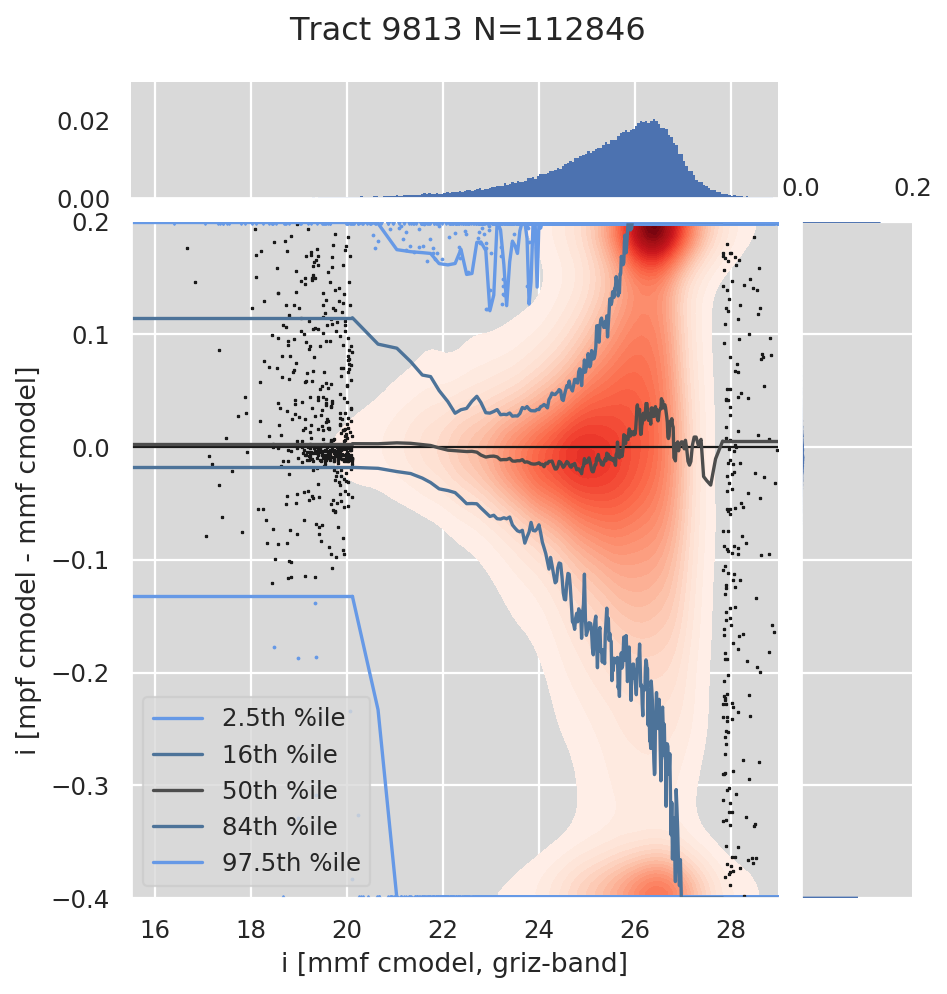

Plotting model cmodel plot mag_i_bright


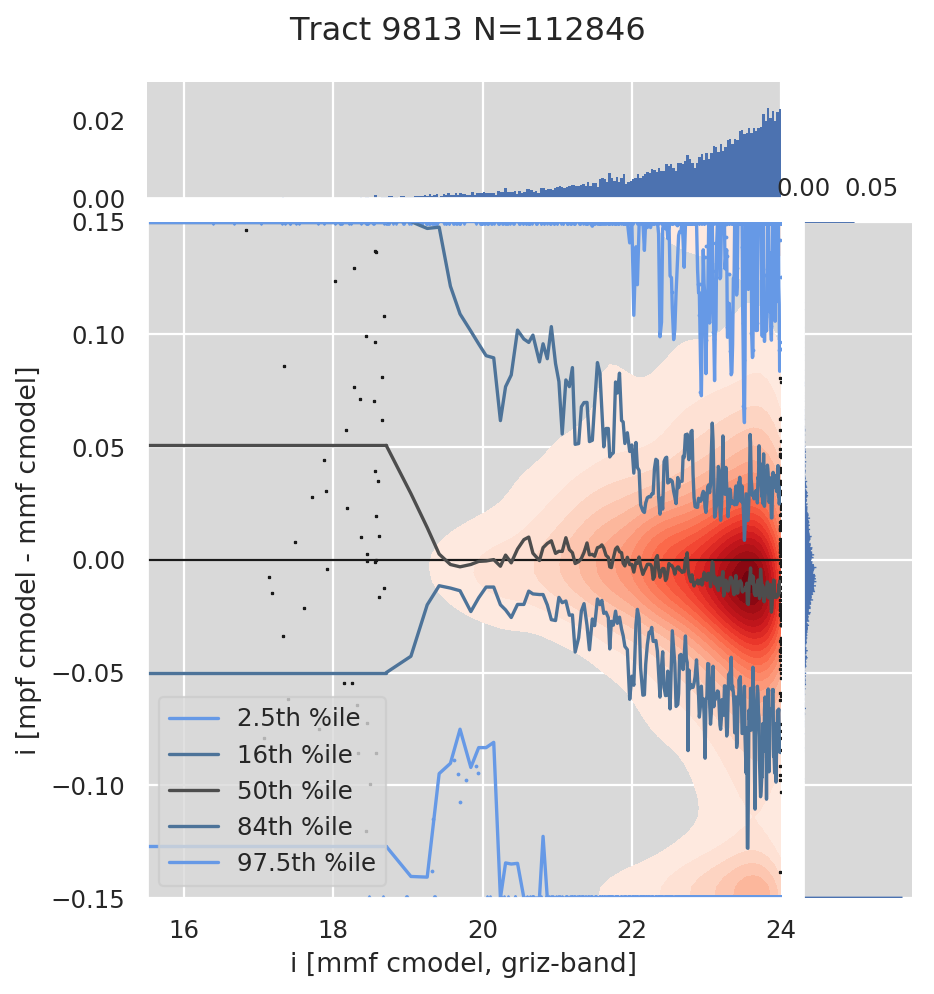

In [10]:
# Plot i-band MMF vs MPF (griz fit)
columns_plot['time']['limx'] = (-3., 1)
columns_plot['time']['limy'] = (-0.8, 3.2)
columns_plot_size['time']['limx'] = (-3., 1)
columns_plot_size['time']['limy'] = (-1.2, 2.8)
plot_models(data, "griz", ("mmf", "mpf"), columns_plot, columns_plot_size, labels=labels, argspj=argspj)

## Comparing griz-band MultiProFit CModel vs MG Sersic fits

As before, these are comparing only the i-band parameters, although griz are fit simultaneously. The main conclusions:

1. Sersic fits aren't necessarily a clear winner over CModel. The median delta log likelihood is positive but fairly small. However, the 1-sigma contours are not symmetric in the Sersic model's favour, i.e. there are more galaxies where the Sersic is significantly better than CModel than vice versa.
2. There are small but non-zero systematic offsets between Sersic and CModel mags, especially at the bright end.

In [11]:
# Update some of the plot limits
columns_plot['time']['limx'] = (-1.5, 2)
columns_plot['time']['limy'] = (-0.2, 1.0)
columns_plot_size_algo = columns_plot.copy()
columns_plot_size_algo["reff"] = dict(log=False, difference=True, limx=(-1, 2), limy=(-1, 1))
for prefix in ("mag_i_reff", "mag_i_bright_reff"):
    columns_plot_size_algo[prefix] = columns_plot_size[f"{prefix}_mpf"].copy()
    del columns_plot_size_algo[prefix]["datum_idx_x"]

Plotting models ('cmodel', 'mg8serb') plot loglike


/software/lsstsw/stack_20200922/conda/miniconda3-py37_4.8.2/envs/lsst-scipipe/lib/python3.7/site-packages/ipykernel_launcher.py:38: RuntimeWarning: invalid value encountered in subtract


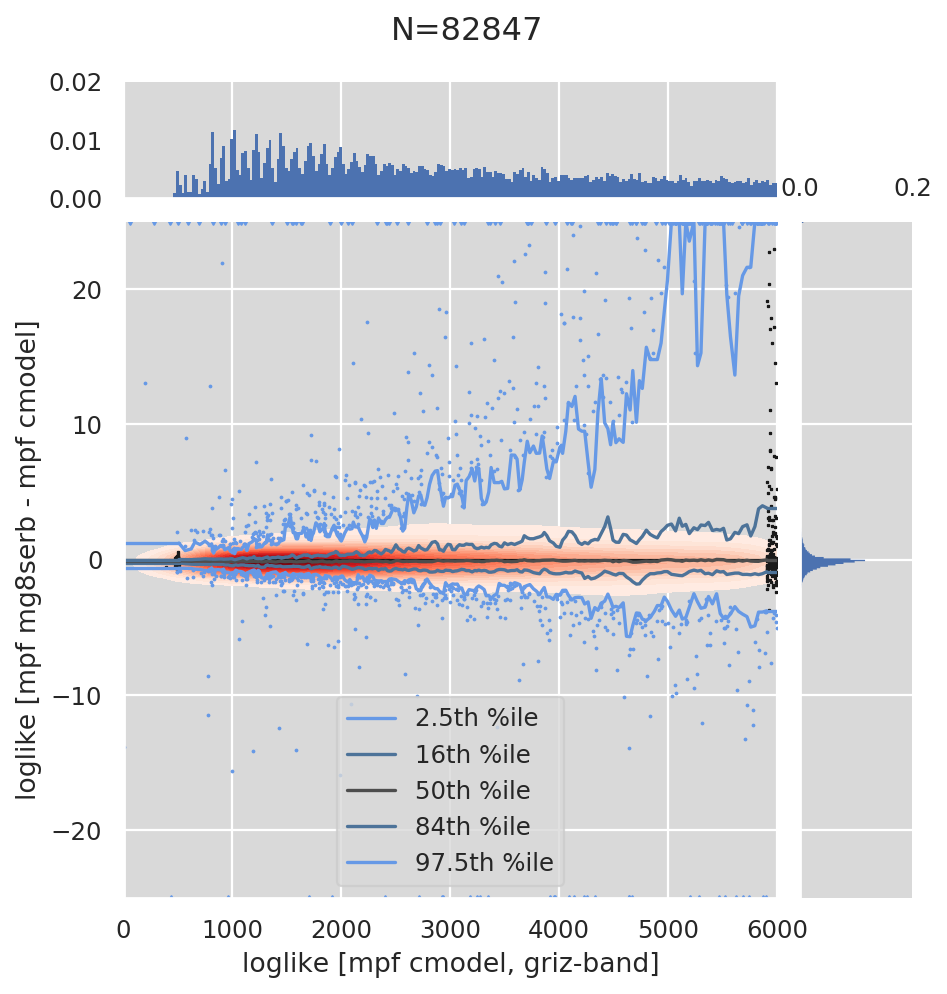

Plotting models ('cmodel', 'mg8serb') plot time


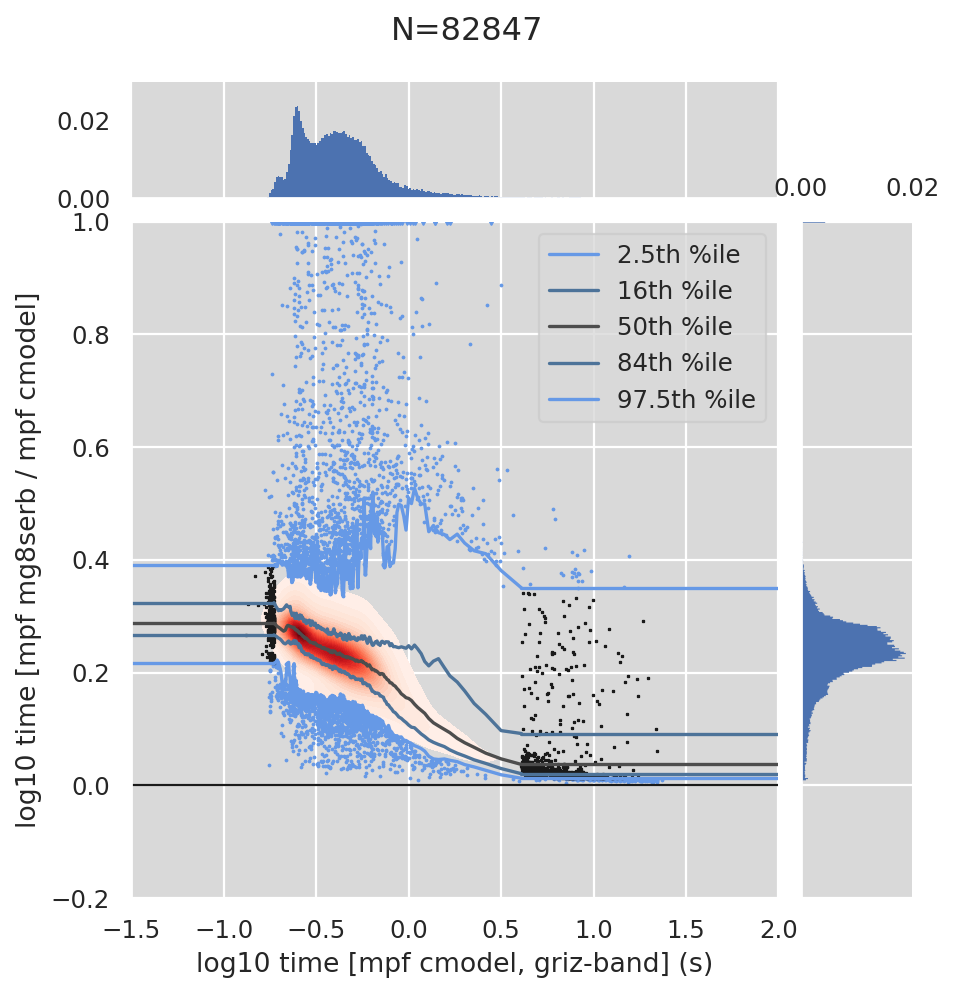

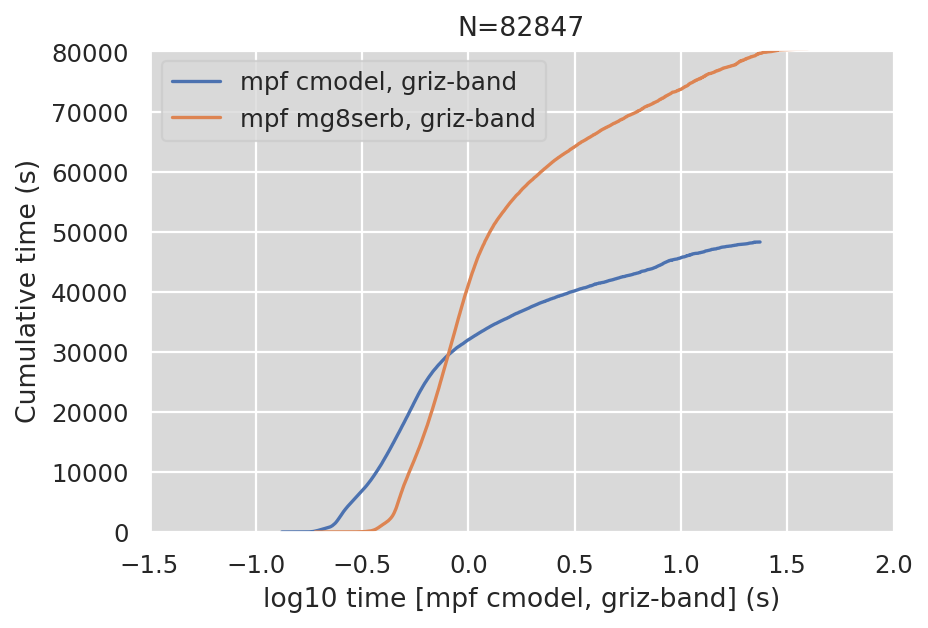

Plotting models ('cmodel', 'mg8serb') plot mag_i


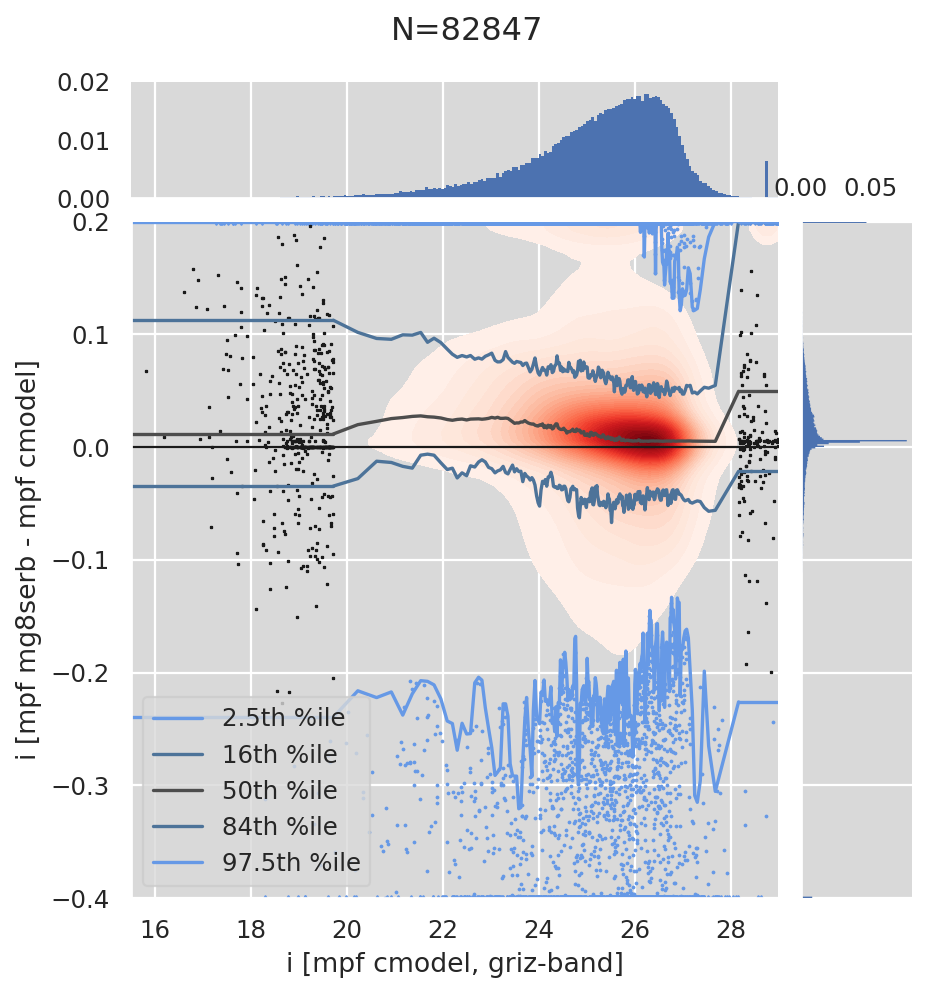

Plotting models ('cmodel', 'mg8serb') plot mag_i_bright


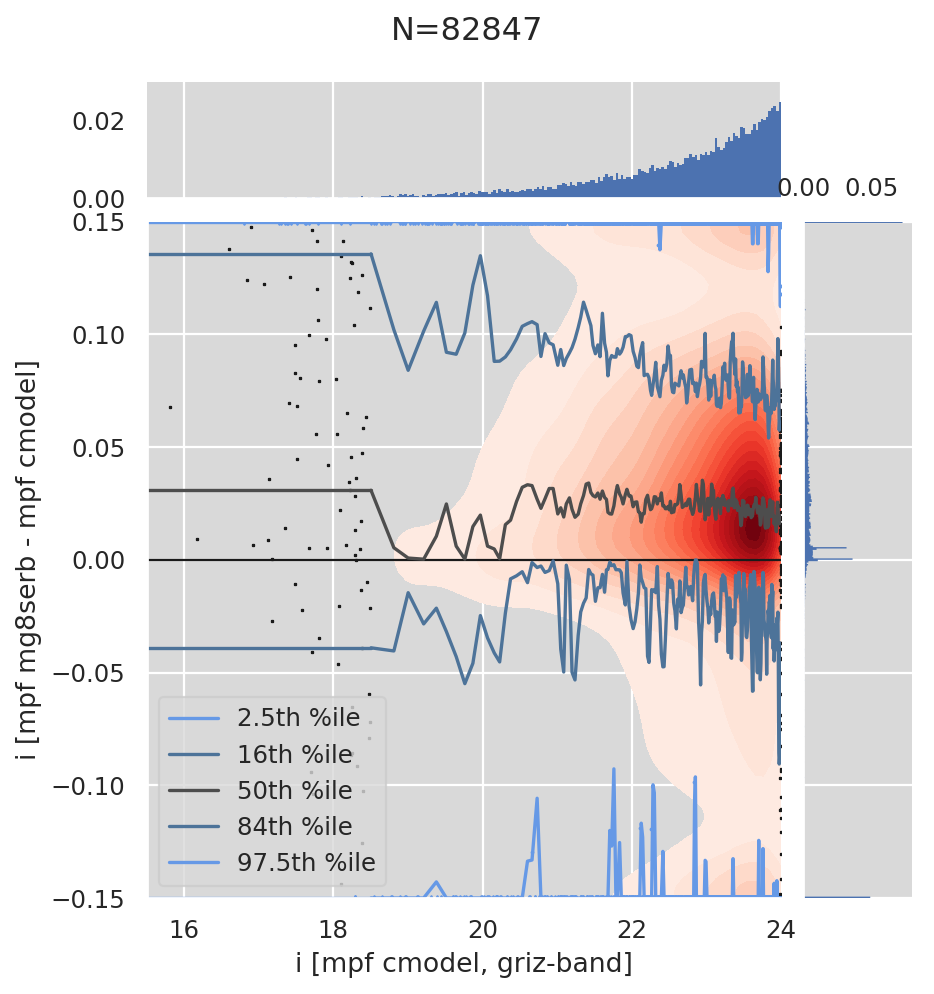

In [12]:
# Plot MPF CModel vs Sersic (griz)
plot_models_algo(data, "griz", "mpf", ("cmodel", "mg8serb"), columns_plot, columns_plot_size_algo, labels=labels, argspj=argspj)

## Comparing griz-band MultiProFit MG Sersic initialization methods

As before, these are comparing only the i-band parameters, although griz are fit simultaneously.
mg8serb is initialized from the best fit out of the gauss, exp. and dev. fits, which are prerequisites for CModel.
mg8serm is initialized directly from the moments with n_ser=1 (exp.). This could be improved.

This is to test whether it is possible to initialize Sersic fits directly from the moments without having run any fixed-n fits (i.e. without running CModel).
The answer is yes, it can, but it takes a lot longer and sometimes converges to a worse fit - it turns out that many more galaxies hit the default max number of iterations of 100 per free parameter without converging.

Plotting models ('mg8serb', 'mg8serm') plot loglike


/software/lsstsw/stack_20200922/conda/miniconda3-py37_4.8.2/envs/lsst-scipipe/lib/python3.7/site-packages/ipykernel_launcher.py:38: RuntimeWarning: invalid value encountered in subtract


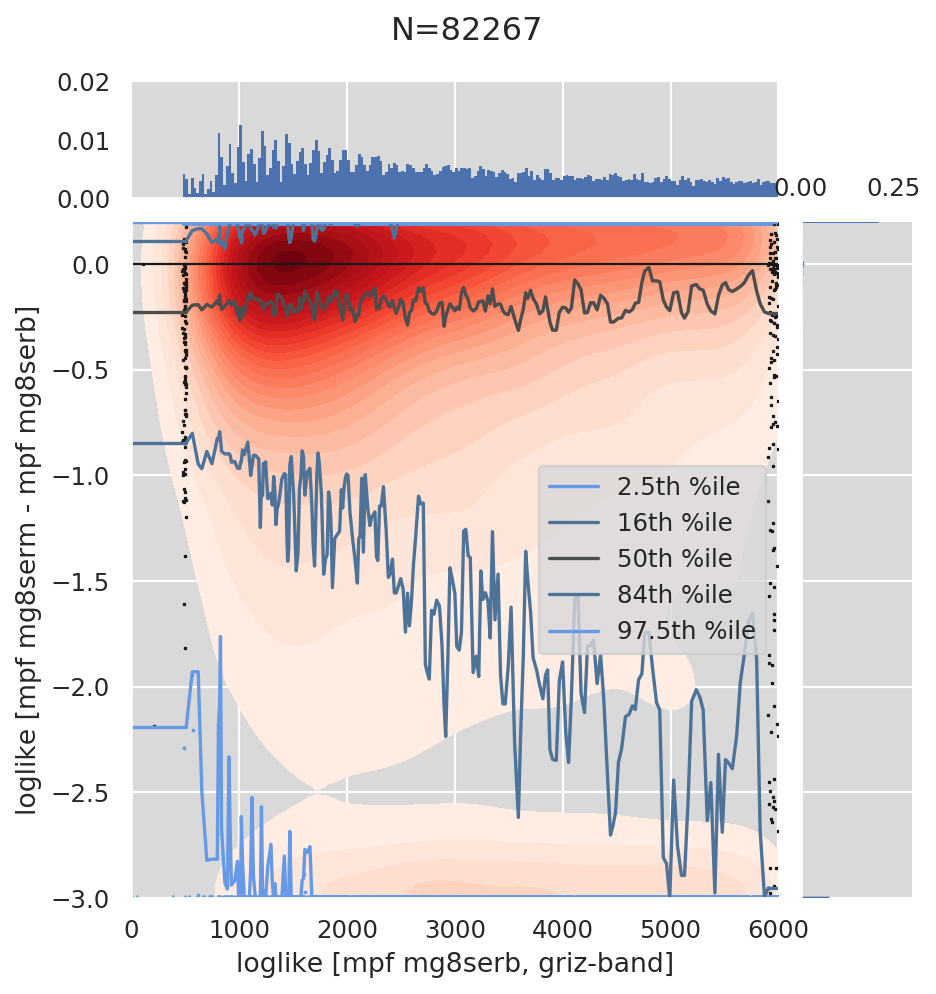

Plotting models ('mg8serb', 'mg8serm') plot time


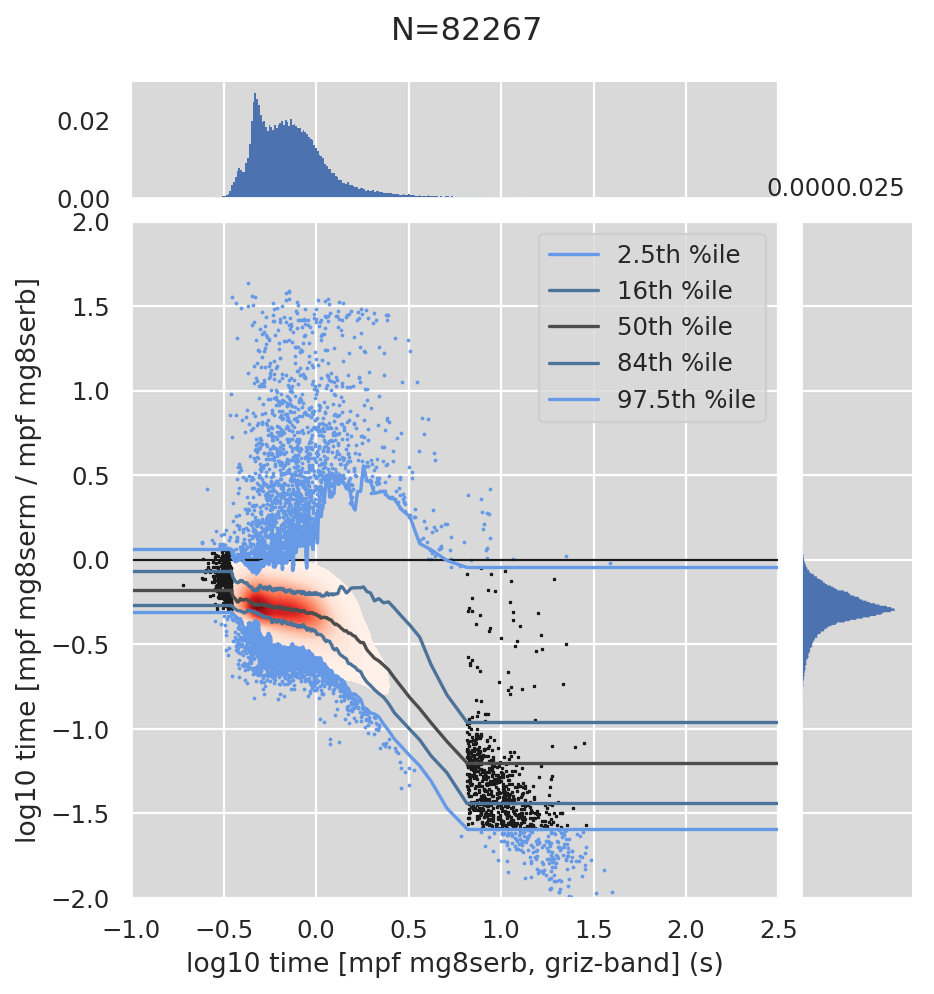

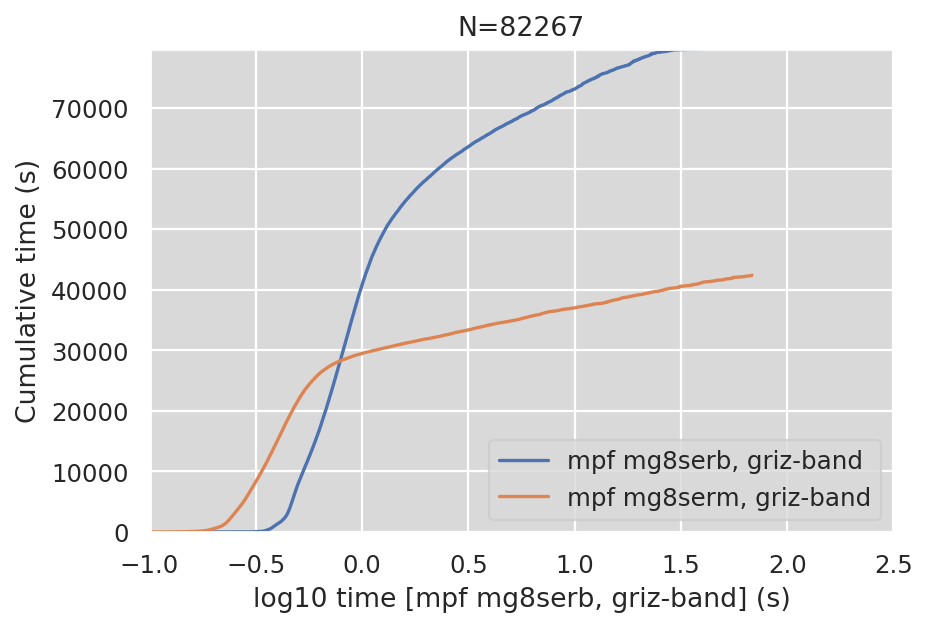

Plotting models ('mg8serb', 'mg8serm') plot mag_i


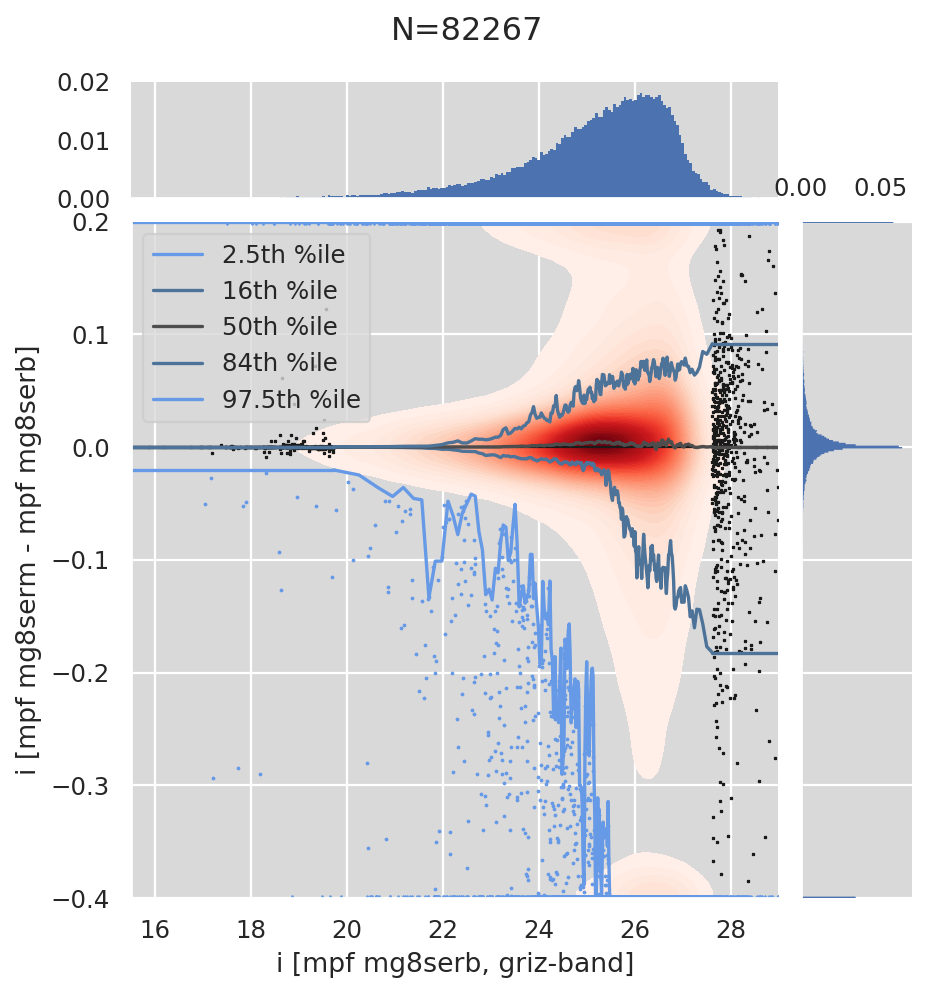

Plotting models ('mg8serb', 'mg8serm') plot mag_i_bright


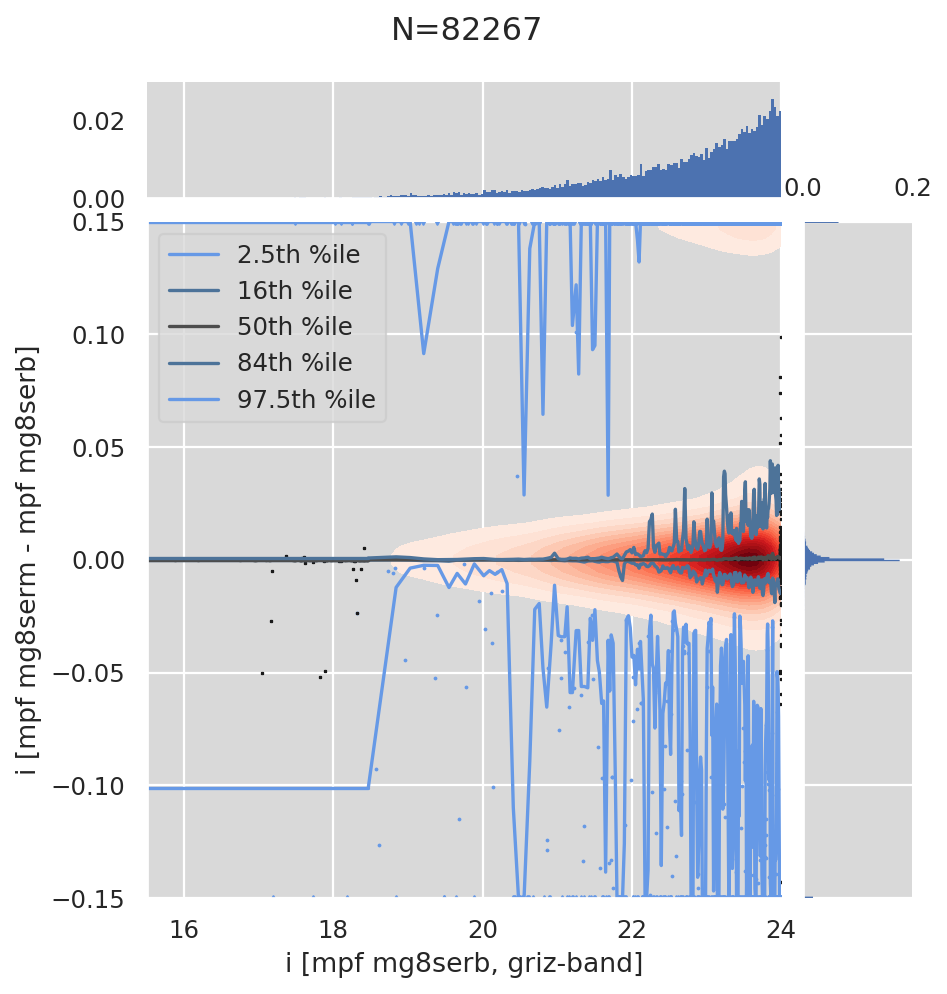

Plotting models ('mg8serb', 'mg8serm') plot reff


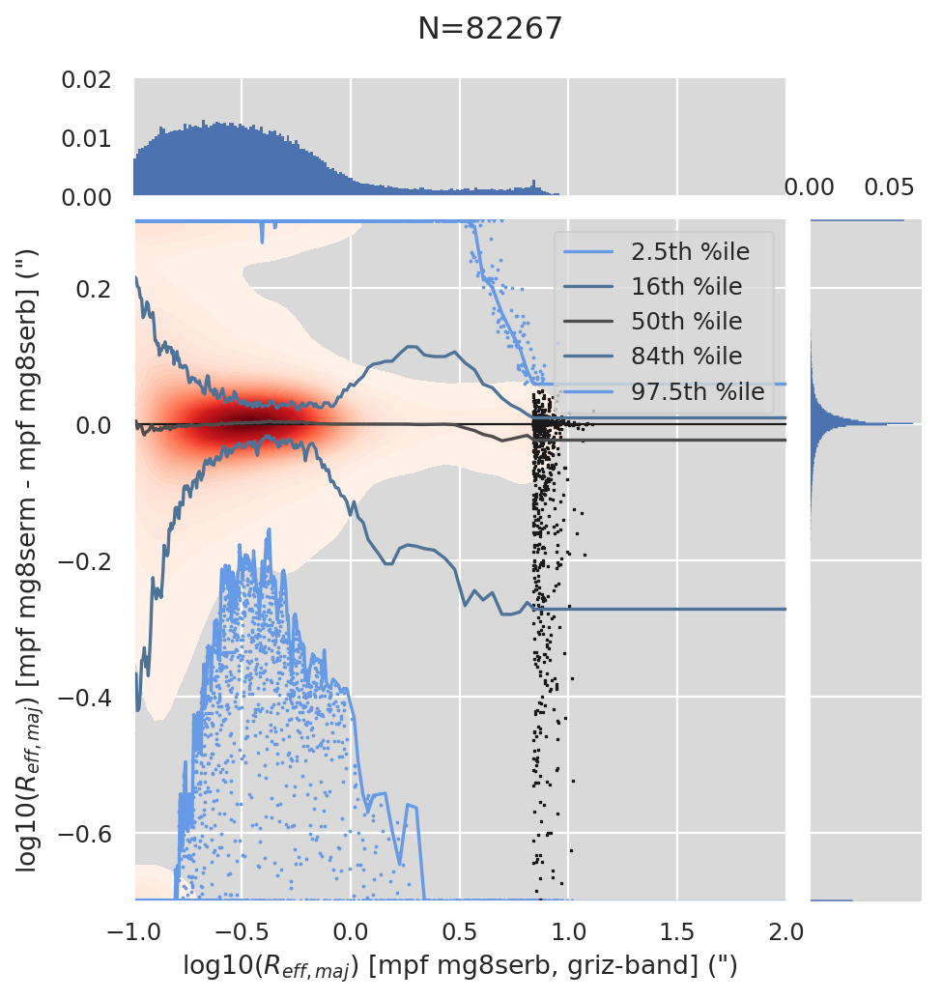

Plotting models ('mg8serb', 'mg8serm') plot mag_i_reff


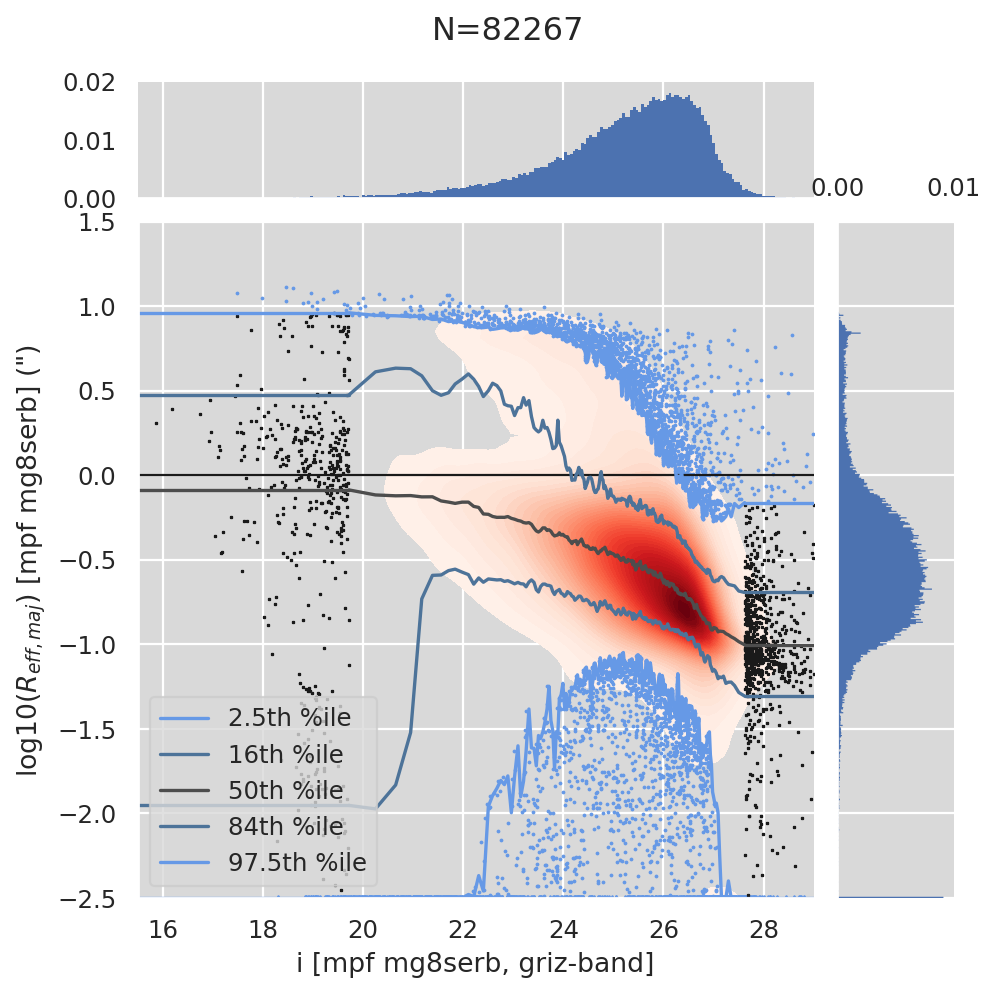

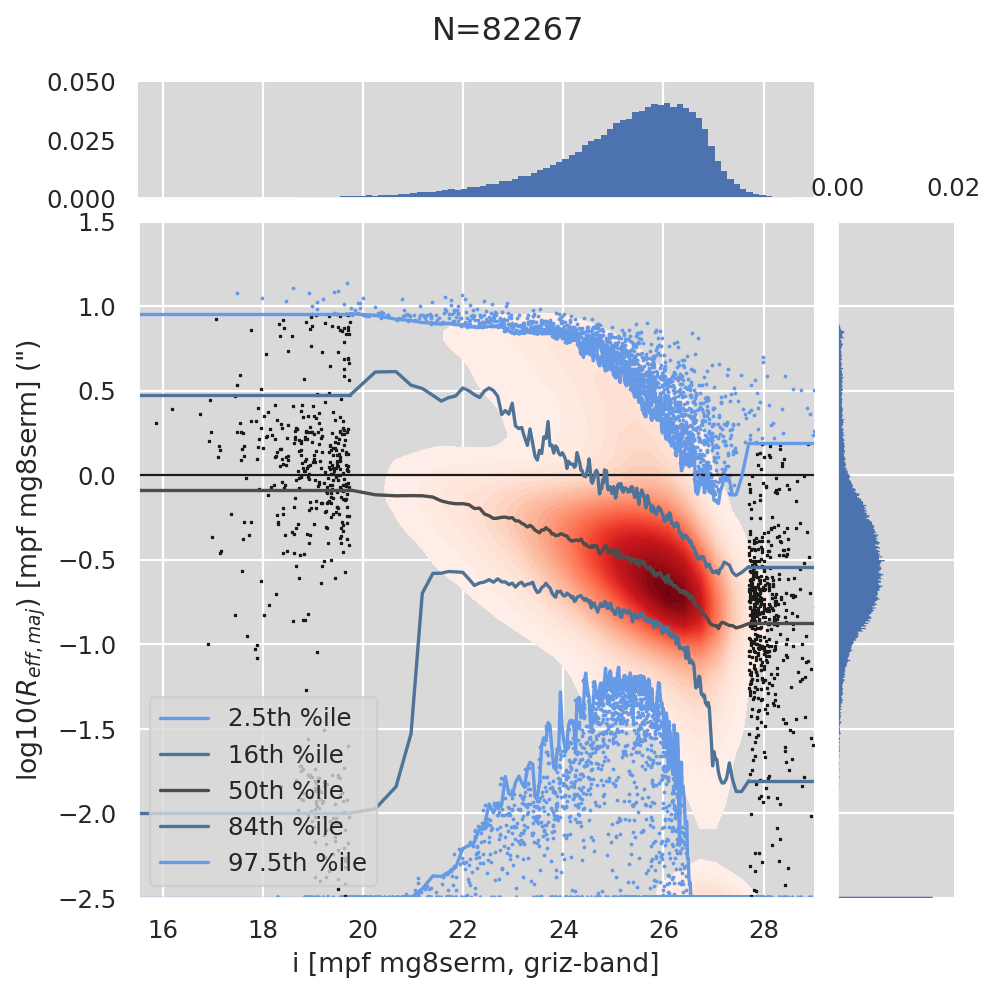

Plotting models ('mg8serb', 'mg8serm') plot mag_i_bright_reff


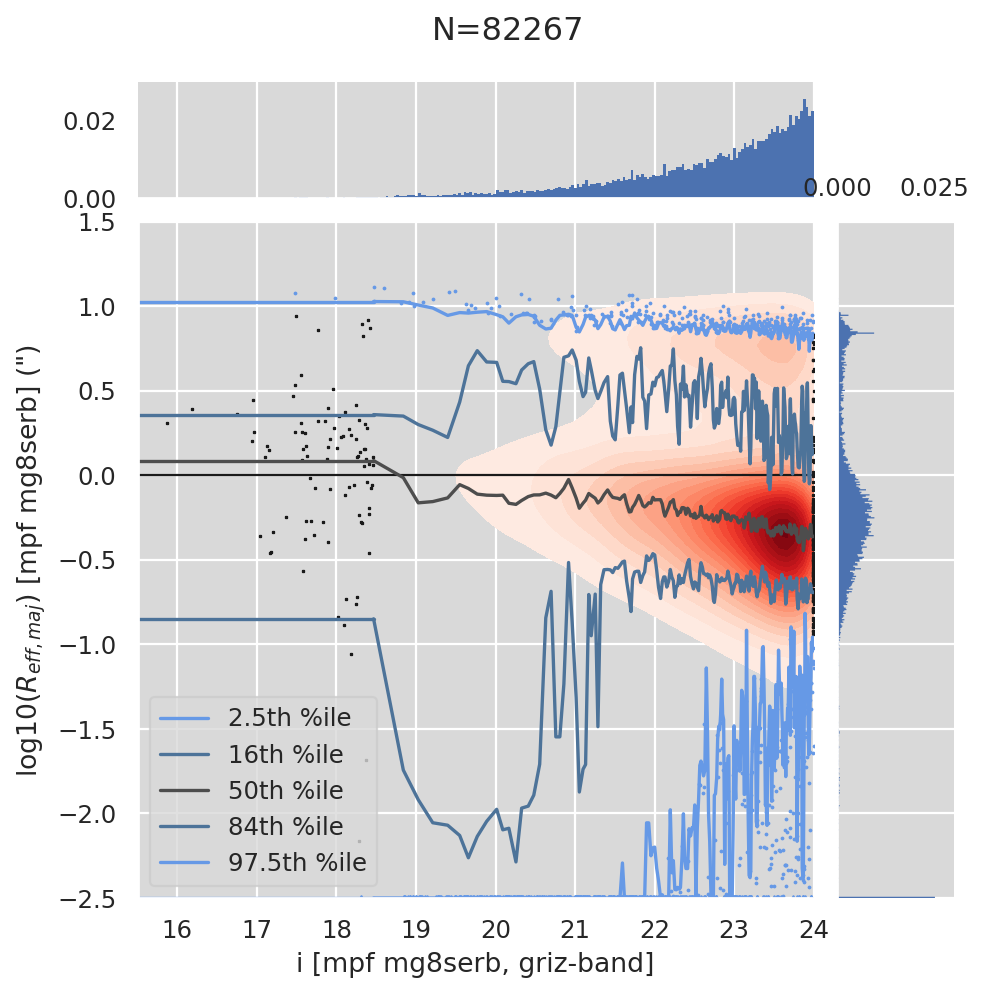

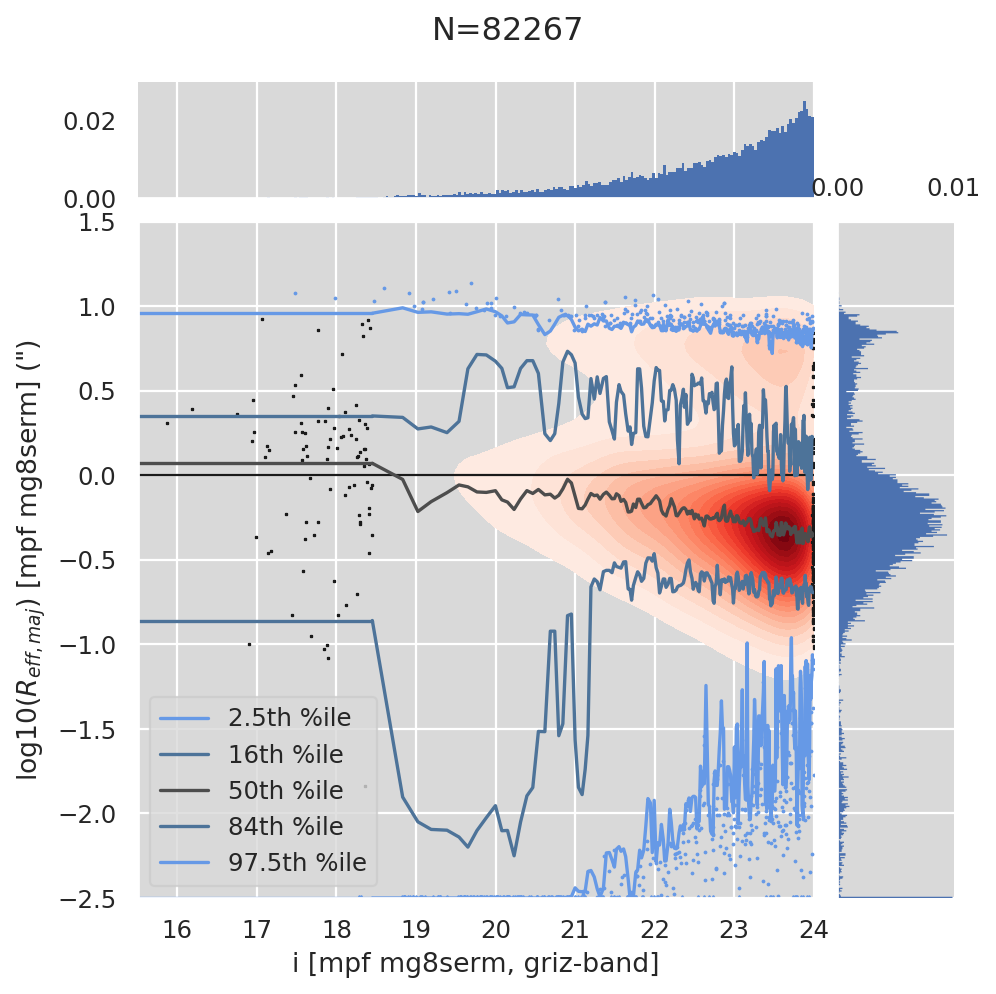

Plotting models ('mg8serb', 'mg8serg') plot loglike


/software/lsstsw/stack_20200922/conda/miniconda3-py37_4.8.2/envs/lsst-scipipe/lib/python3.7/site-packages/ipykernel_launcher.py:38: RuntimeWarning: invalid value encountered in subtract


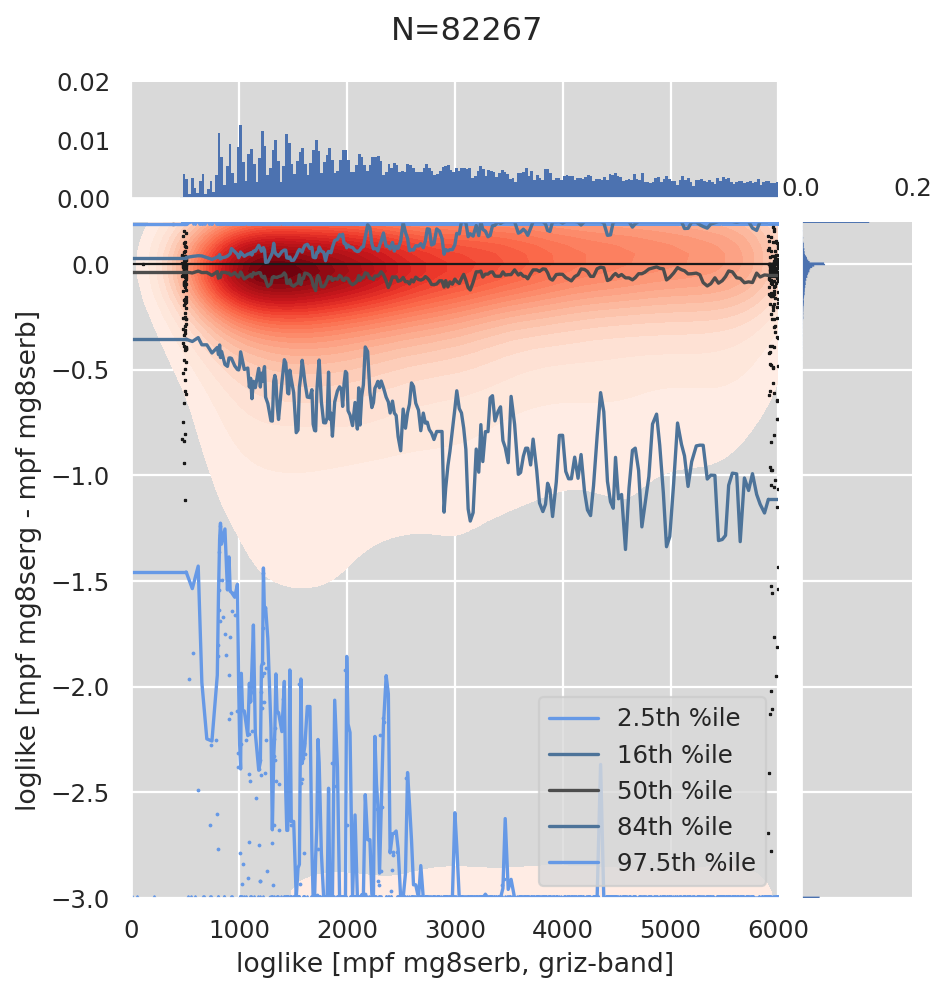

Plotting models ('mg8serb', 'mg8serg') plot time


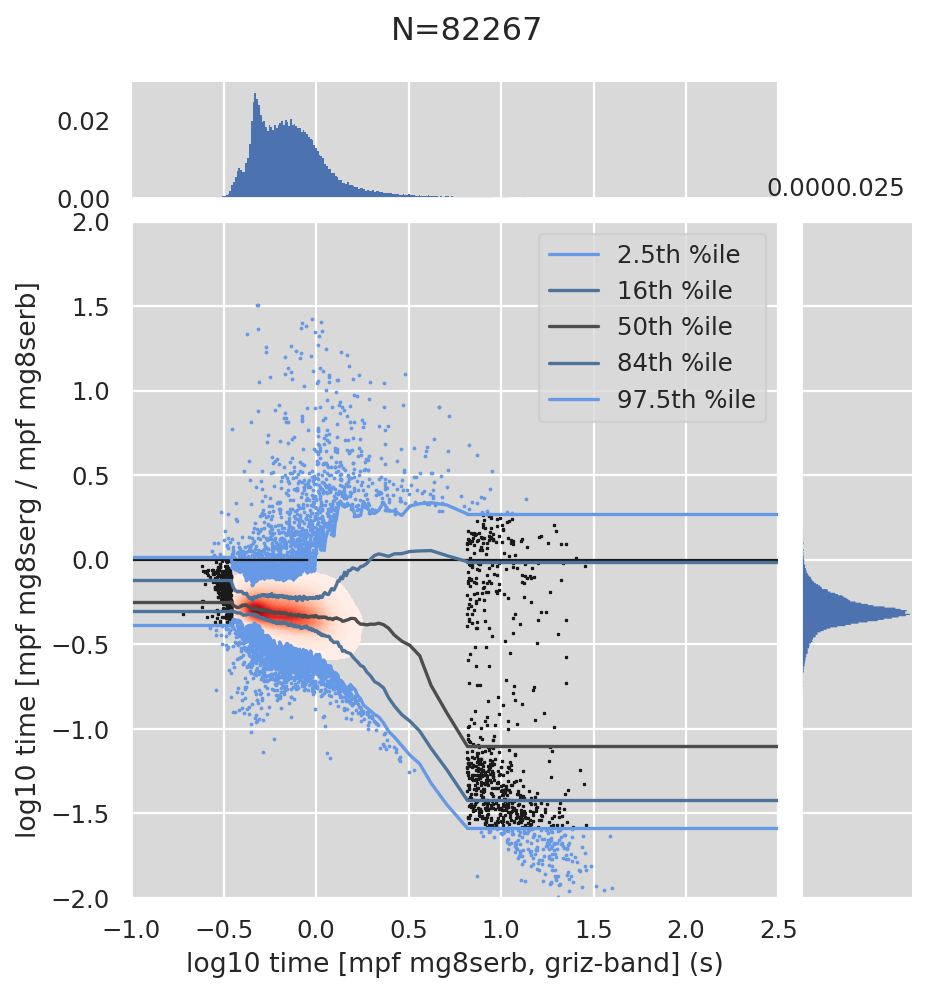

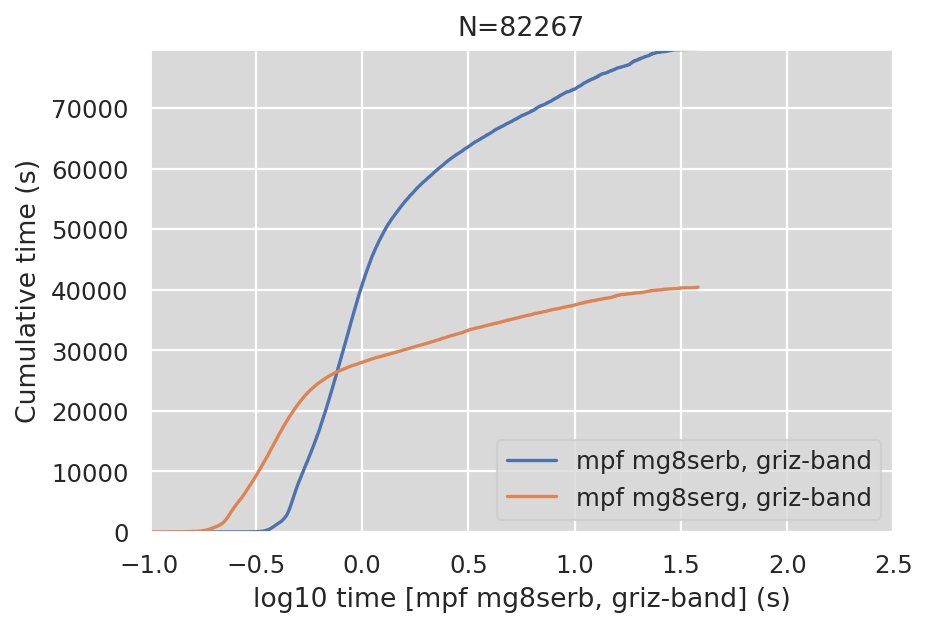

Plotting models ('mg8serb', 'mg8serg') plot mag_i


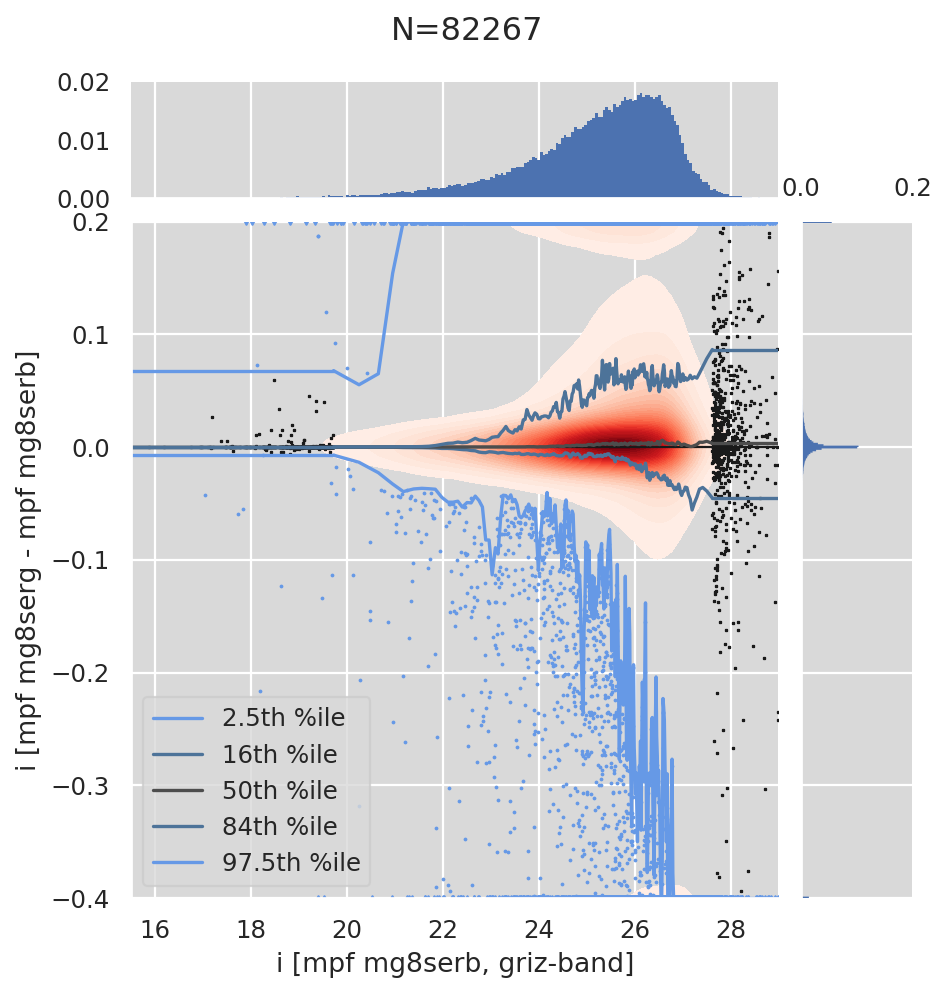

Plotting models ('mg8serb', 'mg8serg') plot mag_i_bright


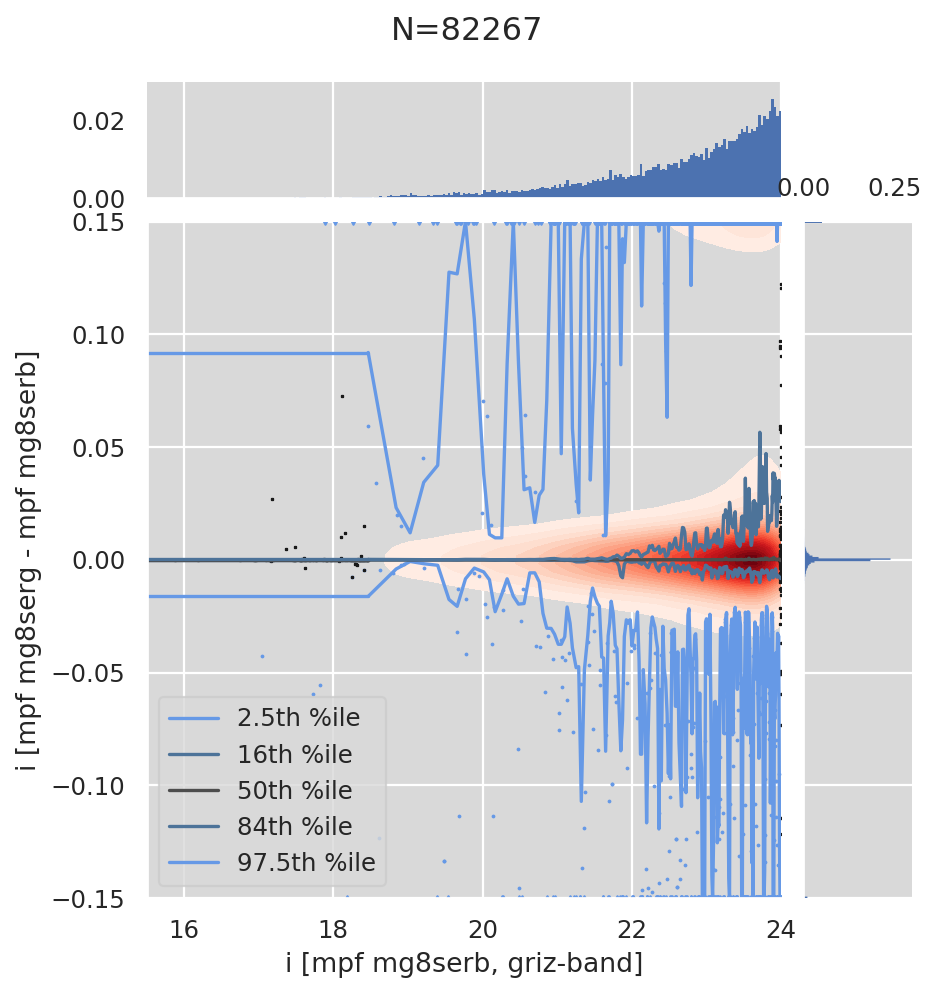

Plotting models ('mg8serb', 'mg8serg') plot reff


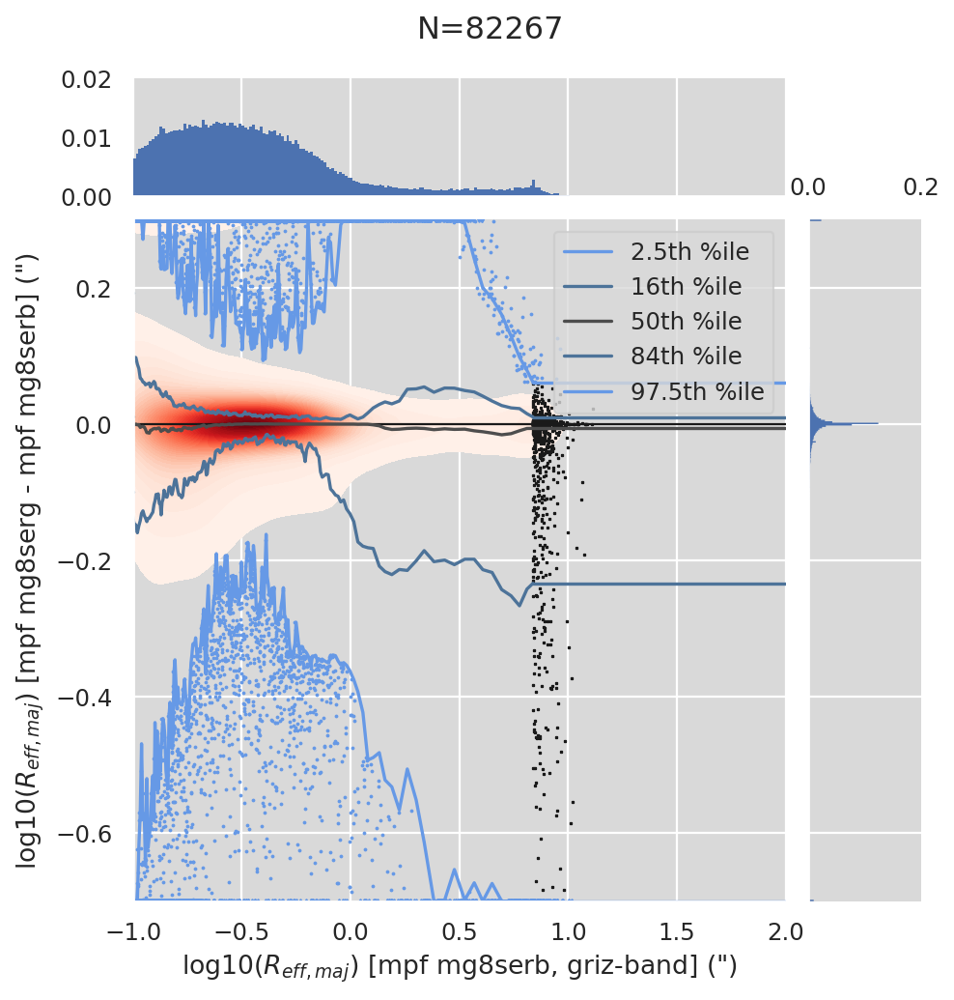

Plotting models ('mg8serb', 'mg8serg') plot mag_i_reff


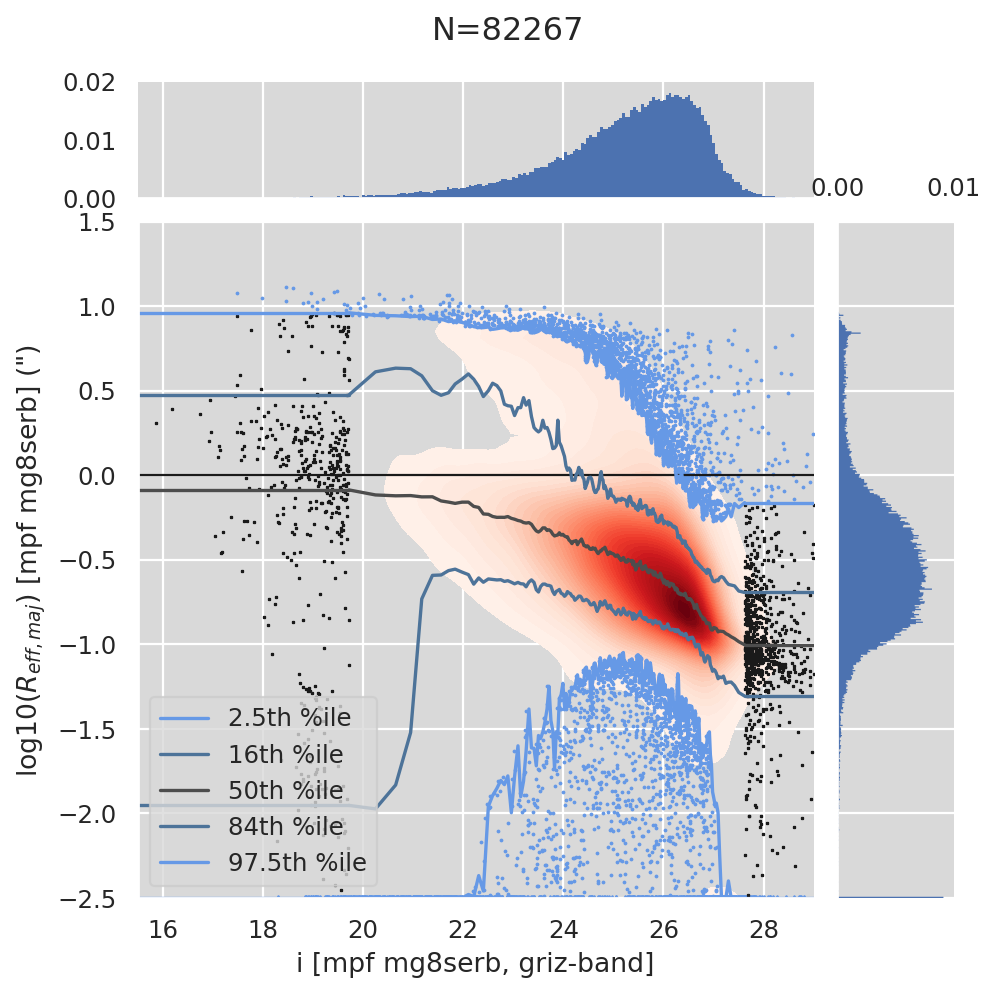

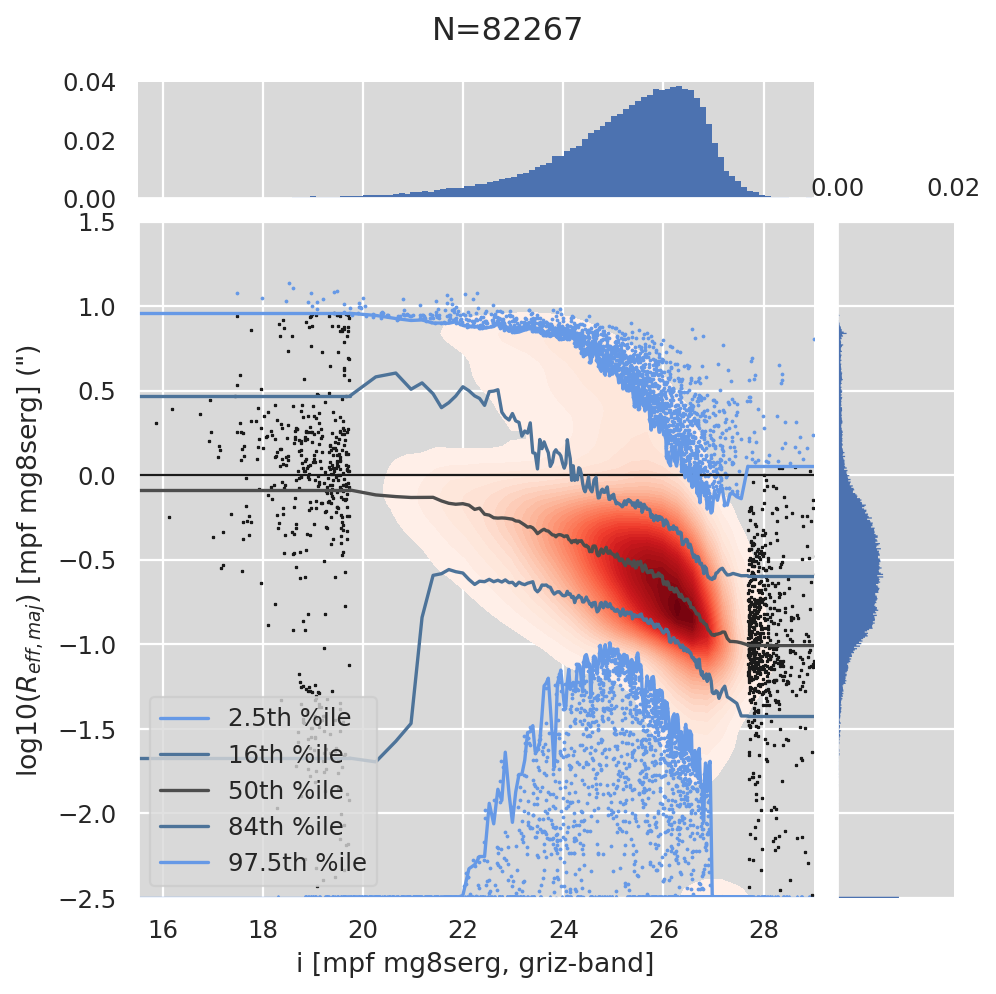

Plotting models ('mg8serb', 'mg8serg') plot mag_i_bright_reff


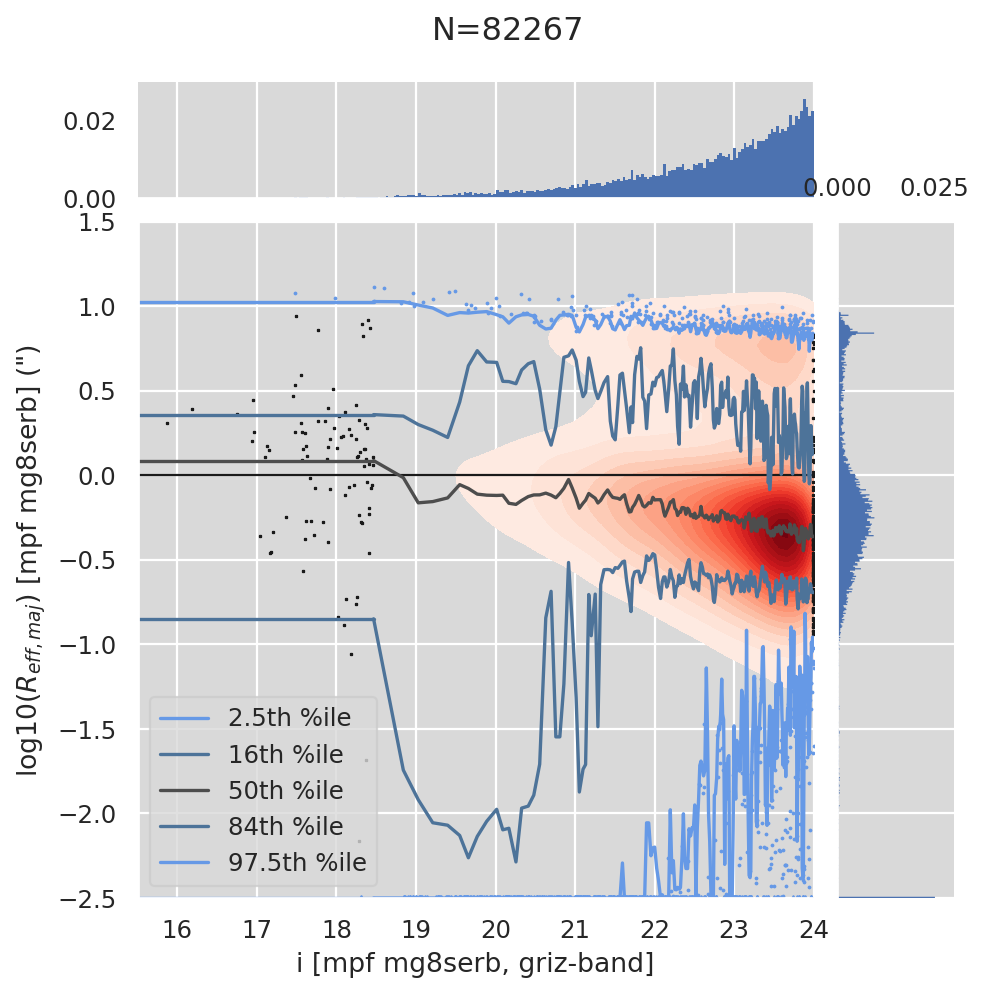

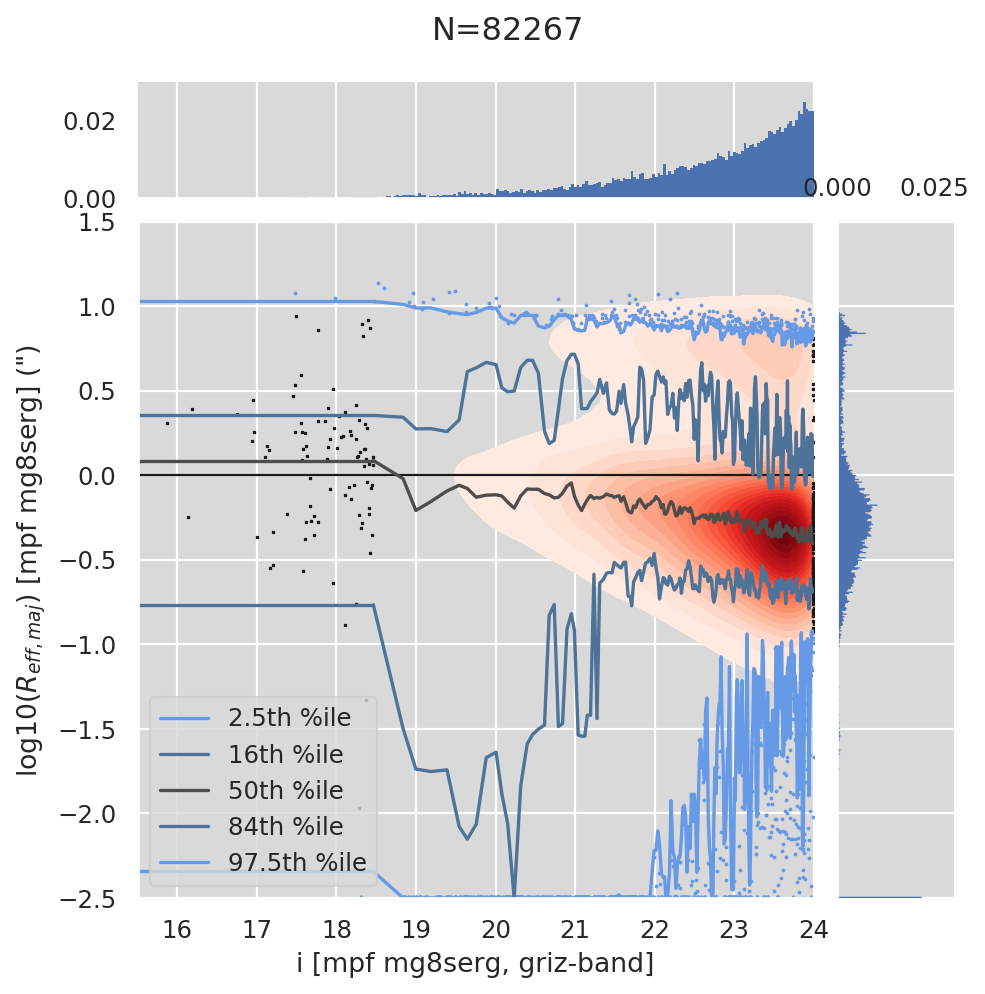

In [13]:
# Plot MPF Sersic with different initialization
columns_plot["time"] = dict(postfix="", log=True, ratio=True, limx=(-1., 2.5), limy=(-2., 2.), plot_cumulative=True)
limy = columns_plot["loglike"]["limy"], columns_plot_size["reff"]["limy"]
columns_plot["loglike"]["limy"] = (-3, 0.2)
columns_plot_size_algo["reff"]["limy"] = (-0.7, 0.3)
columns_plot_size_algo["time"] = columns_plot["time"]
for alt in ("mg8serm", "mg8serg"):
    plot_models_algo(data, "griz", "mpf", ("mg8serb", alt), {'loglike': columns_plot['loglike']},
                     columns_plot_size_algo, labels=labels, argspj=argspj)
columns_plot["loglike"]["limy"], columns_plot_size["reff"]["limy"] = limy

## Plot Gaussian size-mag relation (i band)
Is the Gaussian model more robust to growing to unreasonable sizes? Apparently not.

Plotting model gauss plot mag_i_reff_mmf


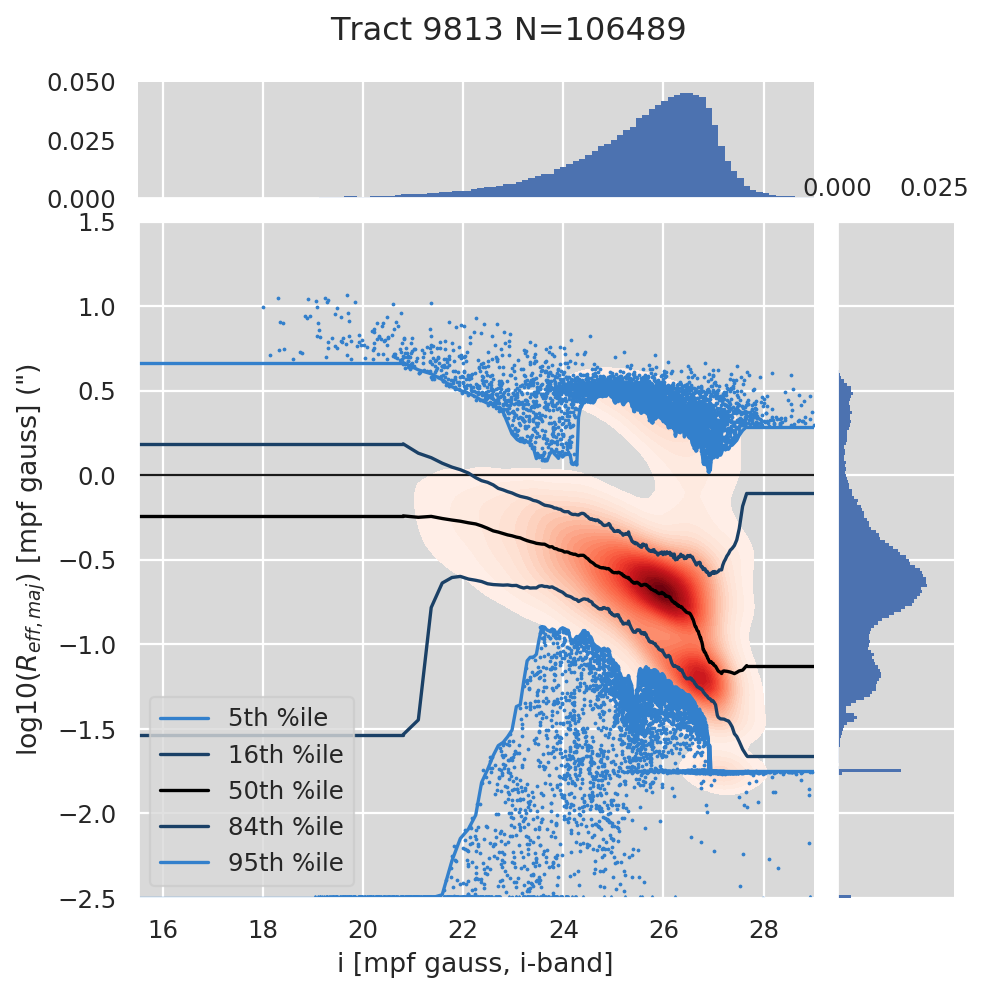

In [14]:
# Plot Gaussian sizes only
plot_models(data, "i", ("mpf", "mpf"), {}, {"mag_i_reff_mmf": columns_plot_size["mag_i_reff_mmf"]}, models=["gauss"], labels=labels)

## Comparing HSC-[IZ] with HST-F814W fits
Here the HST fits are for isolated HSC sources only (and hence have fewer bright galaxies since they tend to be larger and are thus more likely to be blended). This is to avoid having to deblend the HST sources.
This does mean that some fraction of the sources will be:
 1. artifacts in one (usually HSC, but mainly because I'm not checking all of the relevant flags before passing or using the masks); or
 2. undetected blends in HSC; or
 3. undetected in one or more bands, usually HST, but potentially HSC-I/Z for red/blue sources, respectively.

In [15]:
# Define function for HSC vs HST plots
def plot_mpf_model_hsc_vs_hst(model, model_reff=None, plot_only_size_mag=False, reff_min=None, lims_mag=None, argspj=None):
    if argspj is None:
        argspj = {}
    if lims_mag is None:
        lims_mag = (19.5, 25.5)
    lim_x = lims_mag
    data_hst = data['f814w'][model]['mpf']
    data_hsc = data['iz'][model]['mpf']
    if model_reff is None:
        model_reff = model
    if model_reff == model:
        data_hst_reff, data_hsc_reff = data_hst, data_hsc
    else:
        data_hst_reff = data['f814w'][model]['mpf']
        data_hsc_reff = data['iz'][model]['mpf']
    is_single_comp = model != "cmodel"
    mag_bright = 23
    x = data_hsc["mag_i"]
    cond = (x < lim_x[1]) & (x > lim_x[0])
    label_x = f"mag MPF-{model} [HSC-I]"
    flux_hsc = data_hsc["flux_i"] + data_hsc["flux_z"]
    flux_hst = data_hst["flux_f814w"]
    good = cond & np.isfinite(flux_hsc) & np.isfinite(flux_hst) & data_hsc['good']
    print(f"lim_x={lim_x} cond={np.sum(cond)}. isfin_hsc={np.sum(np.isfinite(flux_hsc))},"
          f"isfin_hst={np.sum(np.isfinite(flux_hsc))}, good={np.sum(data_hsc['good'])},"
          f"allgood={np.sum(good)}, good_not_cond={np.sum(good & ~cond)}")
    if reff_min is not None:
        good = good & (data_hst_reff["reff"] > np.log10(reff_min))
    y = -2.5*(np.log10(flux_hsc[good]/flux_hst[good]) - 2.65)
    x_good = x[good]
    n_good = np.count_nonzero(good)
    plotjoint_running_percentiles(
        x_good, y, **argspj,
        labelx=label_x, labely='mag$_{HSC}$-mag$_{HST}$',
        limx=lim_x, limy=(-1, 1), title=f'Tract 9813 N={n_good}')
    if is_single_comp:
        reff_hst = data_hst_reff["reff"][good]
        reff_hsc = data_hsc_reff["reff"][good]
        if not plot_only_size_mag:
            big_hst = reff_hst > -0.3
            big_hsc = reff_hsc > -0.3
            big = big_hst | big_hst
            num_big = np.count_nonzero(big)
            print(f'n_big_hst, hsc={np.count_nonzero(big_hst)}, {np.count_nonzero(big_hsc)}; ' 
                  f'frac_big={num_big}/{n_good}={num_big/n_good:.3e}')
            y = reff_hsc - reff_hst
            prefix = '$R_{eff, HSC|HST}$ > 0.5"'
            plotjoint_running_percentiles(
                x_good[big], y[big], **argspj,
                labelx=label_x, labely="log10($R_{eff,HSC}$/$R_{eff,HST}$)",
                limx=lim_x, limy=(-0.3, 0.3), title=f'{prefix}, N={num_big}')
        plotjoint_running_percentiles(
            x_good, reff_hst, **argspj,
            labelx=label_x, labely='log10($R_{eff,HST}$/")',
            limx=lim_x, limy=(-2.3, 0.6), title=f'N={n_good}')
        if not plot_only_size_mag:
            plotjoint_running_percentiles(
                reff_hst, y, **argspj,
                labelx='log10($R_{eff,HST}$/")', labely="log10($R_{eff,HSC}$/$R_{eff,HST}$)",
                limx=[-1.5, 1], limy=(-0.32, 0.68), title=f'N={n_good}')
            big_bright = big & (x_good < mag_bright)
            plotjoint_running_percentiles(
                reff_hst[big_bright], y[big_bright], **argspj,
                labelx='log10($R_{eff,HST}$/")', labely="log10($R_{eff,HSC}$/$R_{eff,HST}$)",
                title=f'{prefix} & mag < {mag_bright}, N={np.count_nonzero(big_bright)}',
                limx=[-0.32, 0.58], limy=(-0.15, 0.15),
            )
            n_ser = data_hsc.get("nser_1", None)
            if n_ser is not None:
                n_ser = n_ser[good]
                good_size = (reff_hst > 0) & (reff_hsc > 0)
                prefix = '$R_{eff, HSC&HST}$ > 1"'
                y = np.log10(n_ser[good_size]/data_hst["nser_1"][good][good_size])
                plotjoint_running_percentiles(
                    x_good[good_size], y, **argspj,
                    labelx=label_x, labely="log10($n_{ser,HSC}$/$n_{ser,HST}$)",
                    limx=lim_x, limy=(-0.6, 0.6), title=f'{prefix}, N={np.count_nonzero(good_size)}')

###  HSC-[IZ] vs. HST-F814W, Gauss

Conclusions here:
1. Magnitudes are sort-of-but-not-completely consistent. It's unclear whether this is mainly due to my shoddy attempt at calibrating without any colour terms.
2. Sizes are surprisingly consistent - the scatter is not small, but the bias is.
3. HSC fits of small galaxies are systematically larger than HST. This could be partly due to issues in PSF modelling. A double Gaussian is probably not a great representation of the HST PSF, and it's unclear how reliable the empirical PSFs (that the models are fit to) are in the first place - for HSC they're probably mostly fine, but for HST...?

lim_x=(19.5, 25.5) cond=111206. isfin_hsc=282388,isfin_hst=282388, good=120316,allgood=4673, good_not_cond=0
n_big_hst, hsc=488, 517; frac_big=488/4673=1.044e-01


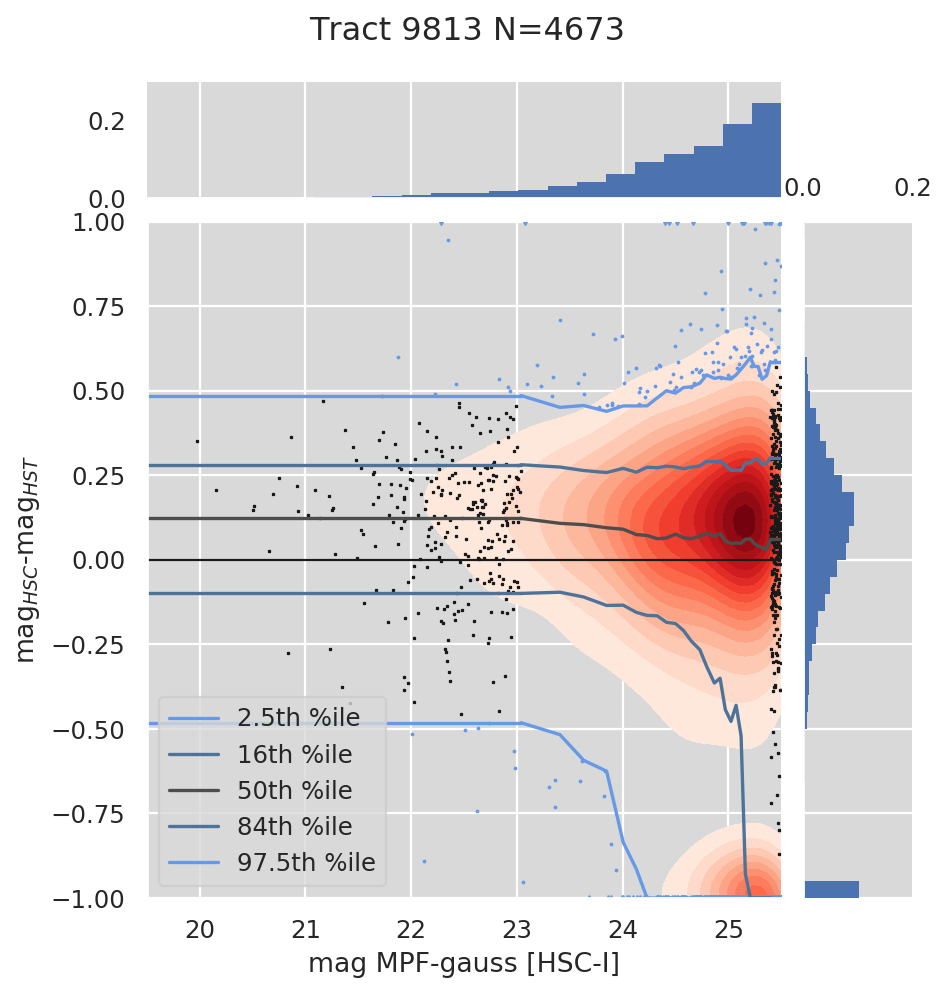

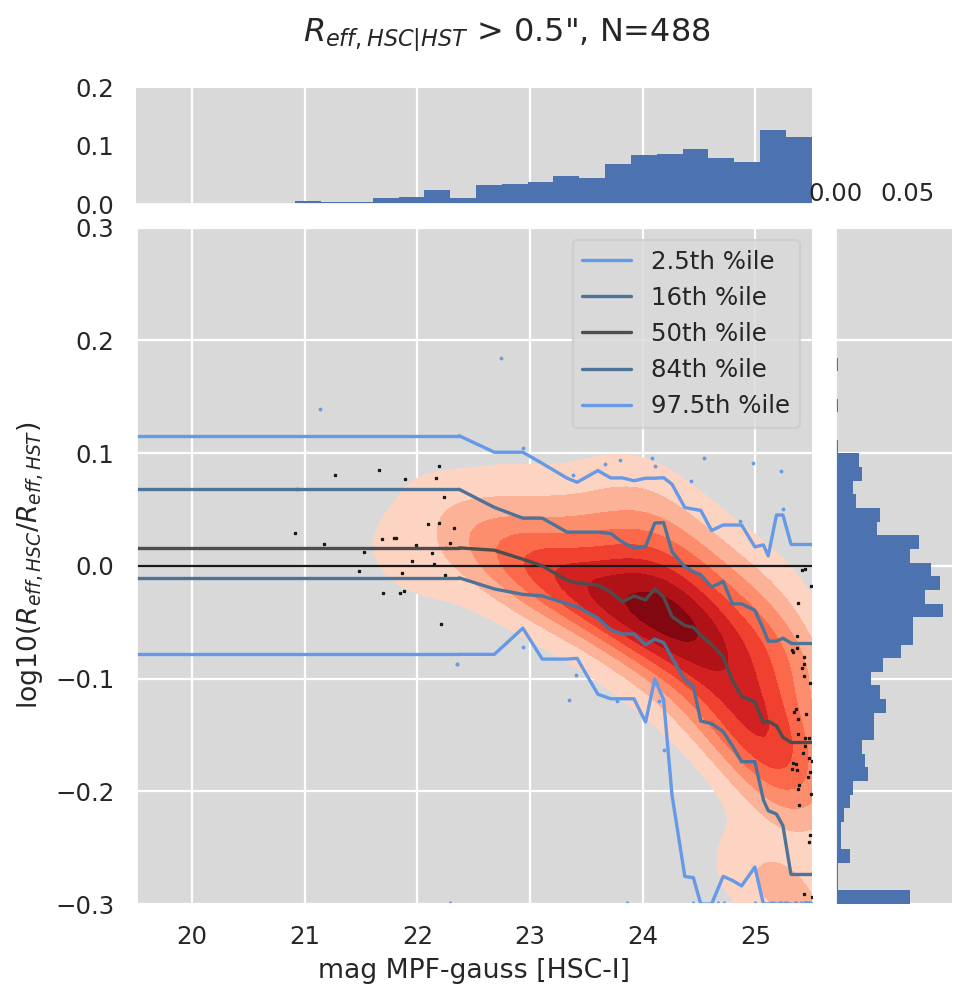

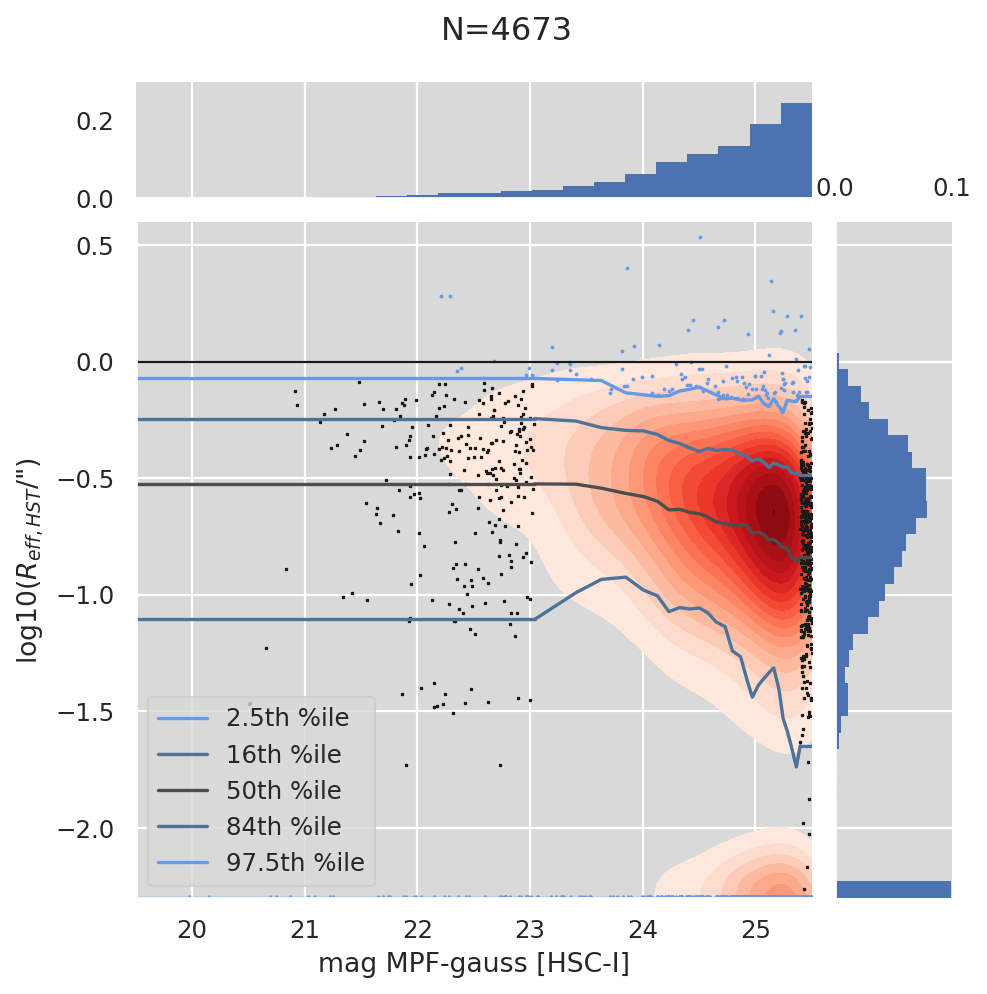

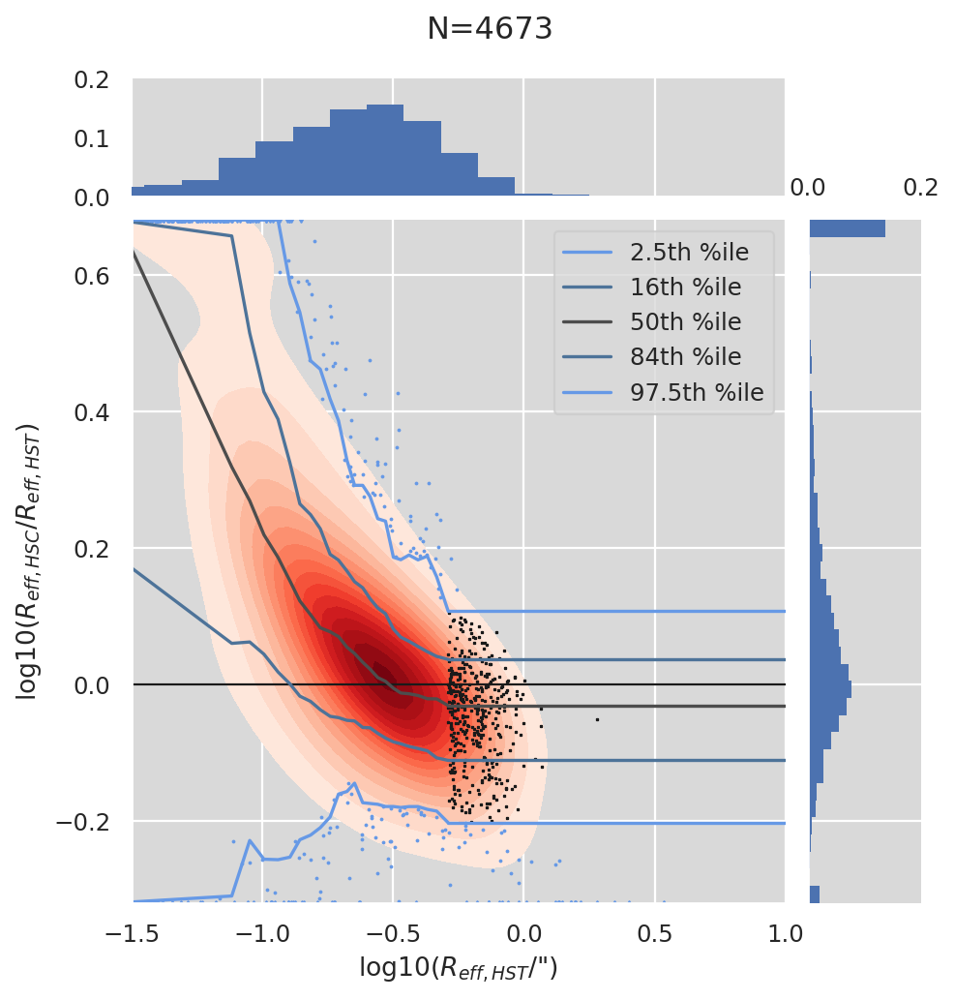

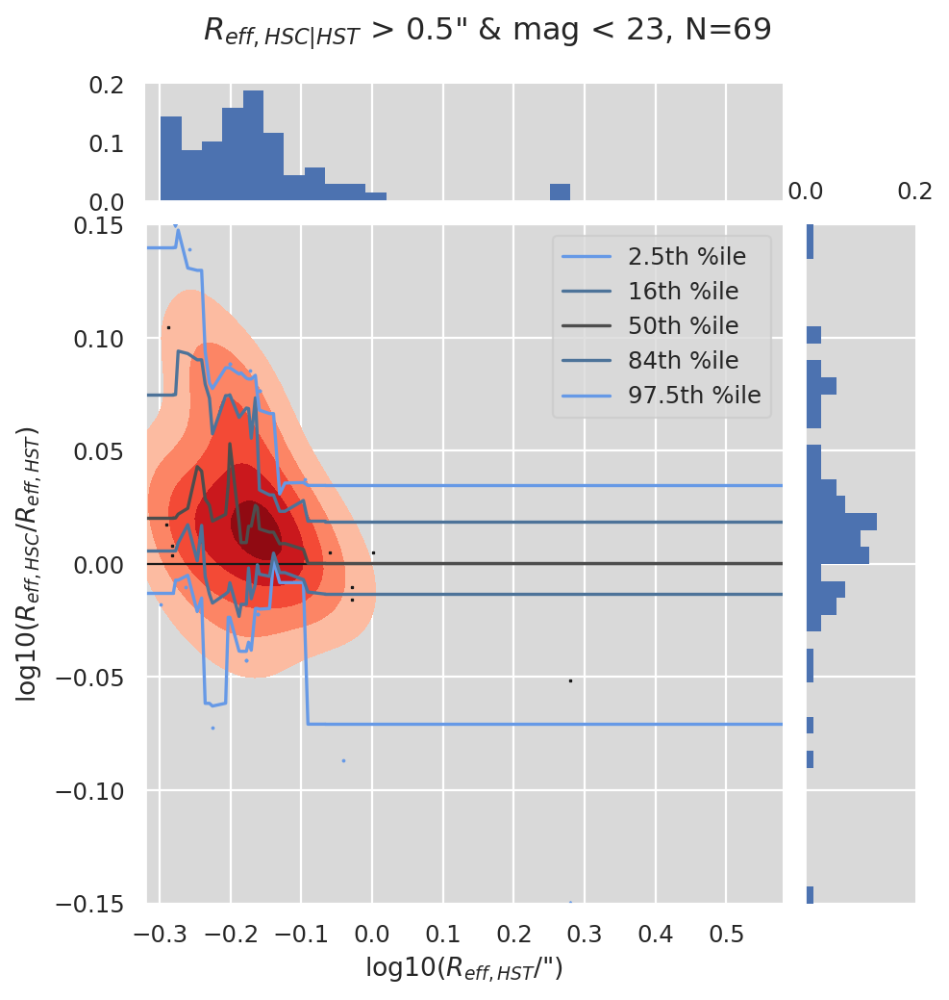

In [16]:
# Plot isolated HST galaxies only
argspj_gauss = argspj.copy()
argspj_gauss['ndivisions'] = 10
argspj_gauss['nbinspan'] = 3
plot_mpf_model_hsc_vs_hst("gauss", argspj=argspj_gauss)
plt.show()

## Are Gaussian sizes more robust?
Sadly, it doesn't seem so. TODO: Plot sizes vs PSF mags; most unreasonably large galaxies are probably >27 mags.

lim_x=(19.5, 25.5) cond=111206. isfin_hsc=282388,isfin_hst=282388, good=120316,allgood=4673, good_not_cond=0
n_big_hst, hsc=488, 517; frac_big=488/4673=1.044e-01


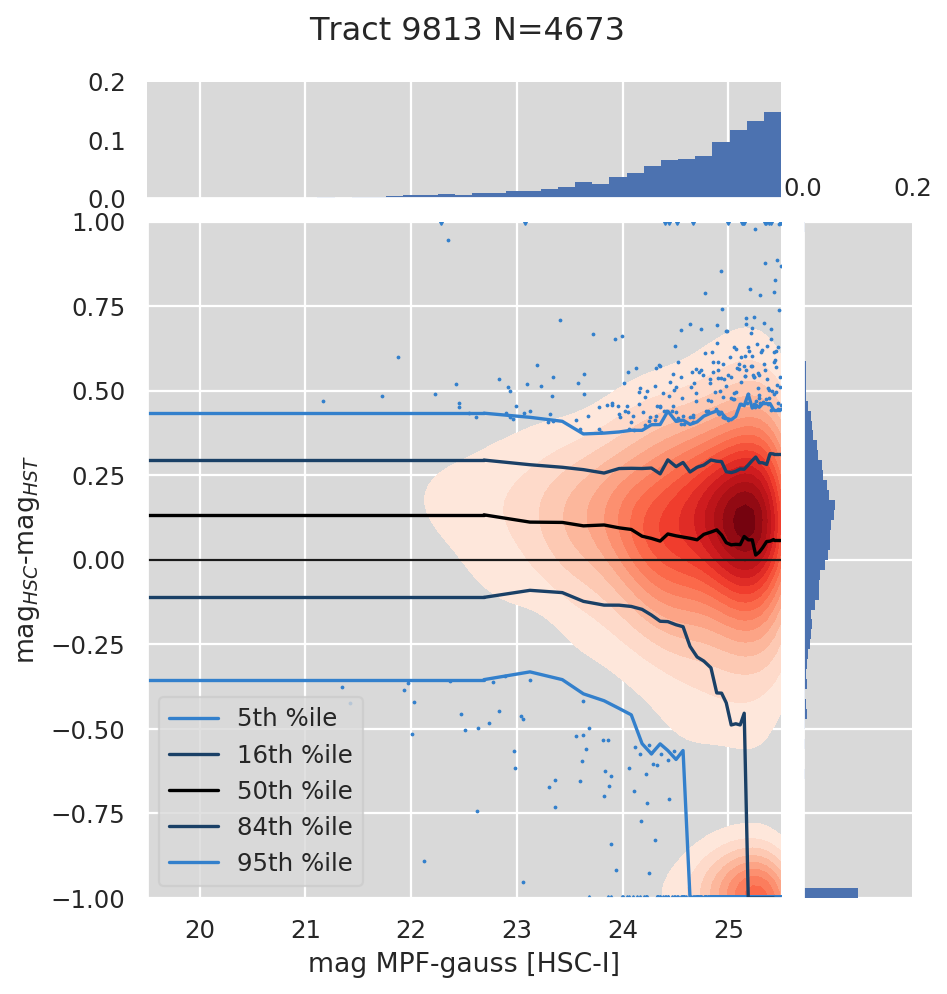

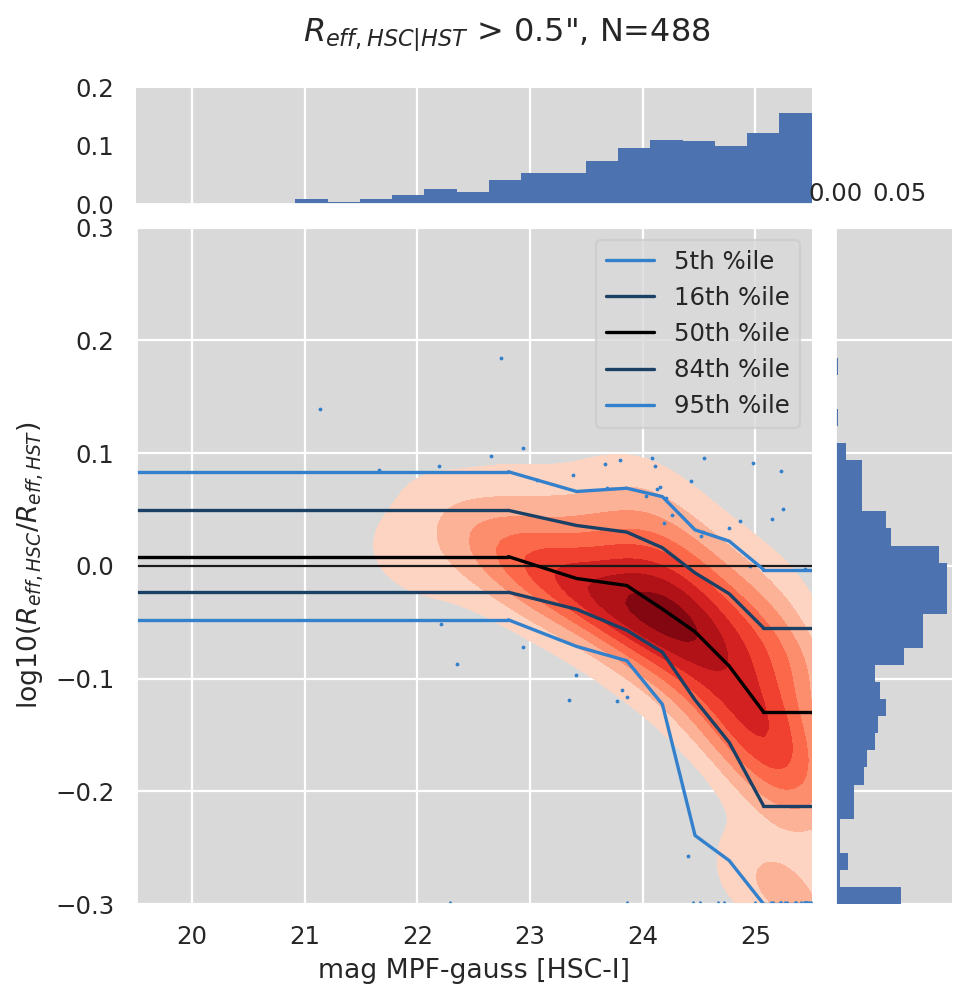

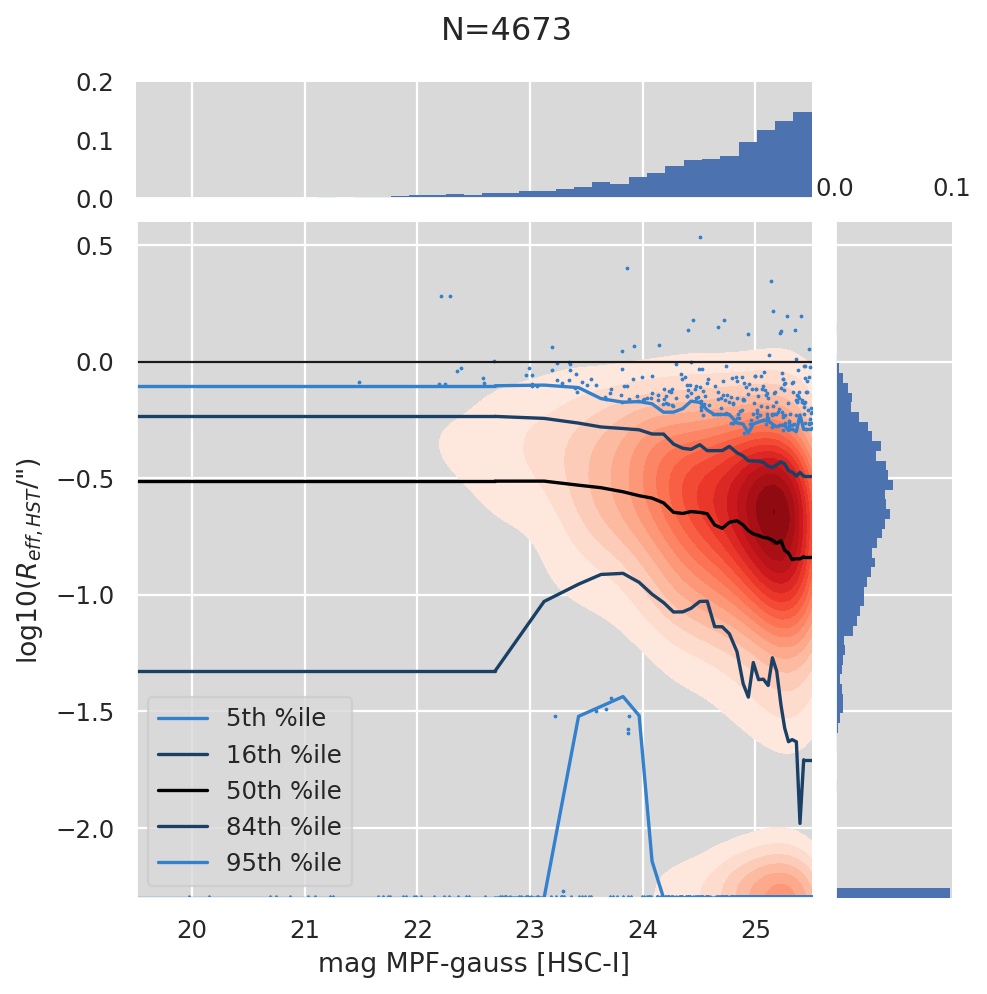

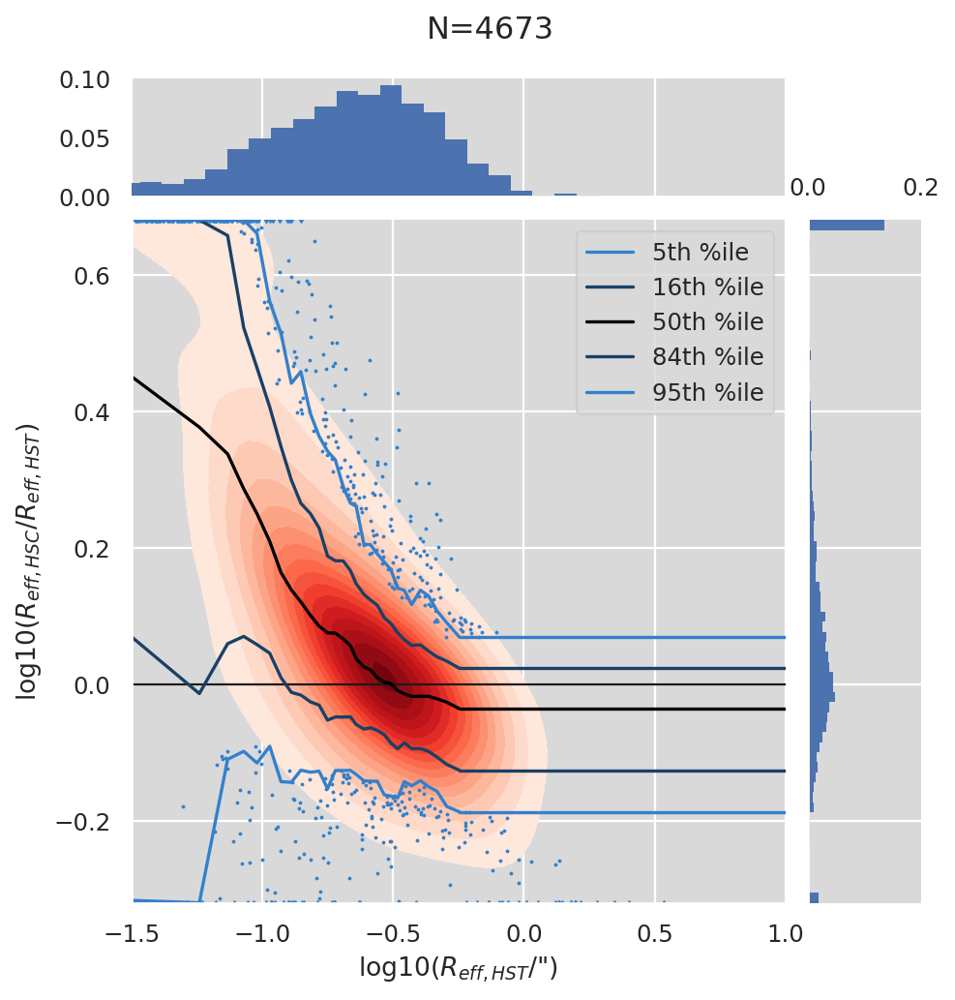

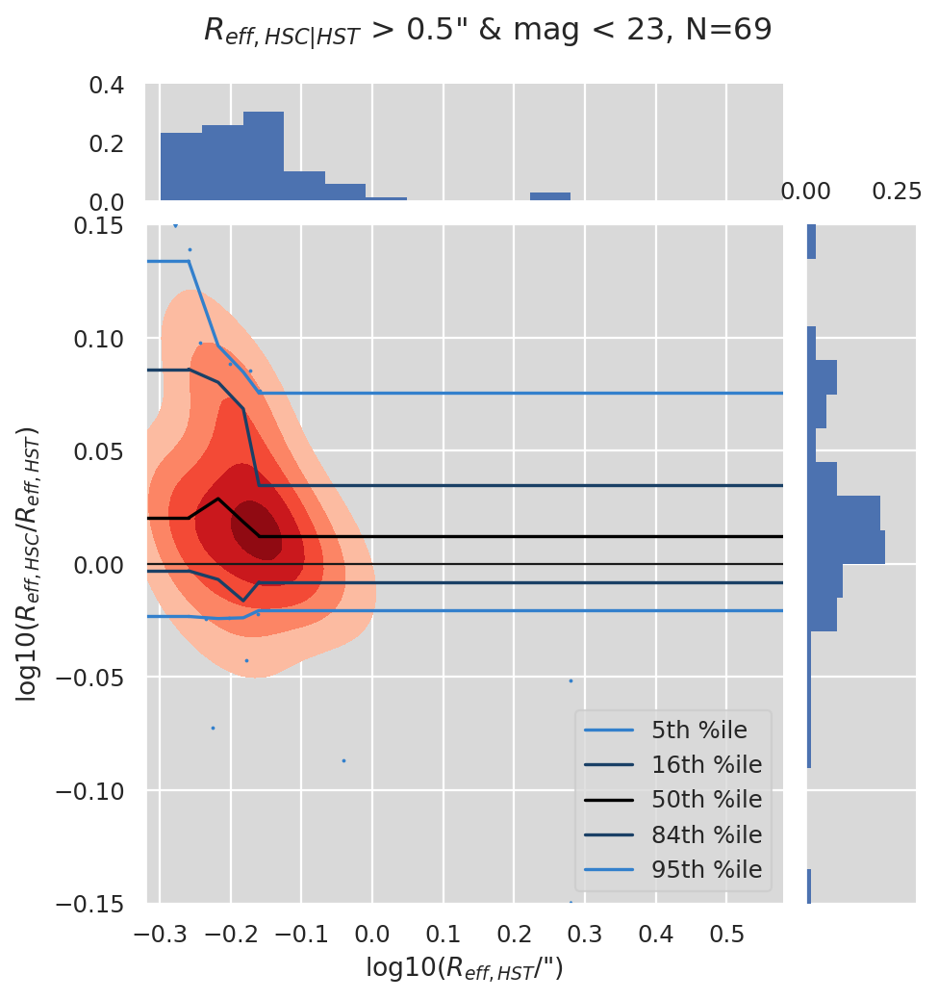

Gauss mag vs Sersic reff
lim_x=(18.5, 26) cond=149887. isfin_hsc=282388,isfin_hst=282388, good=120316,allgood=7816, good_not_cond=0


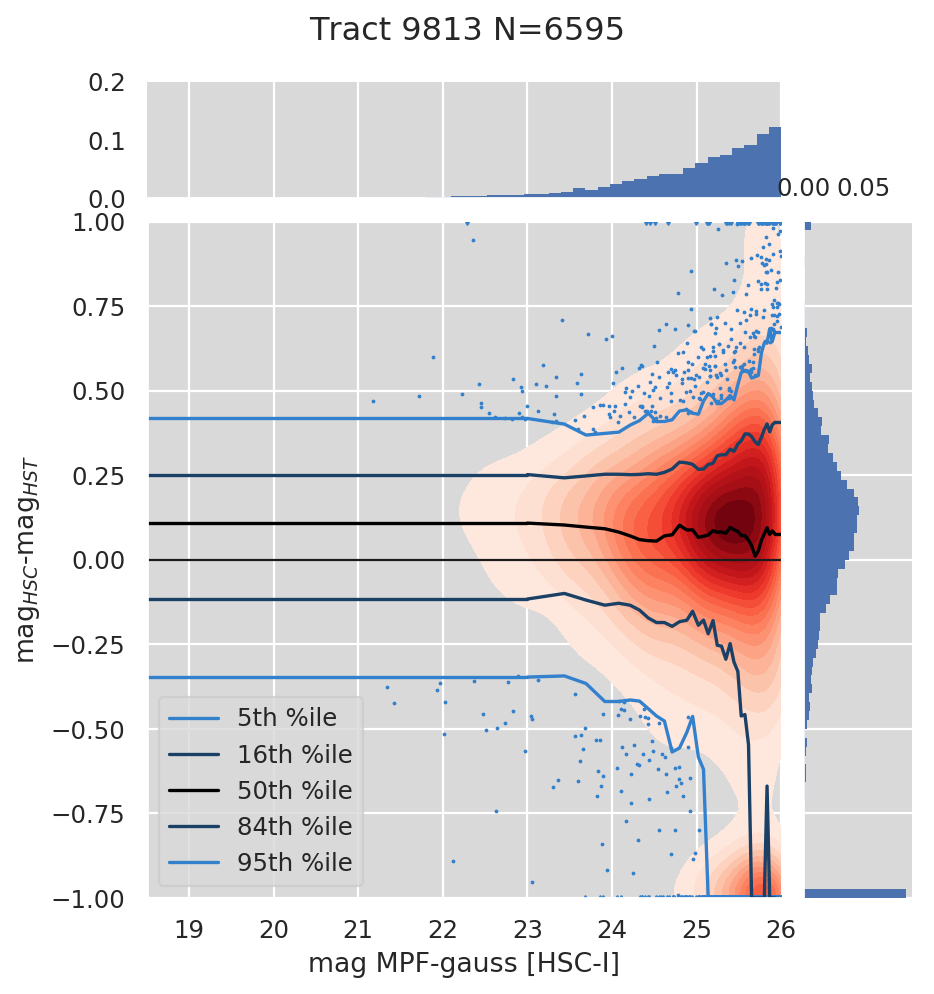

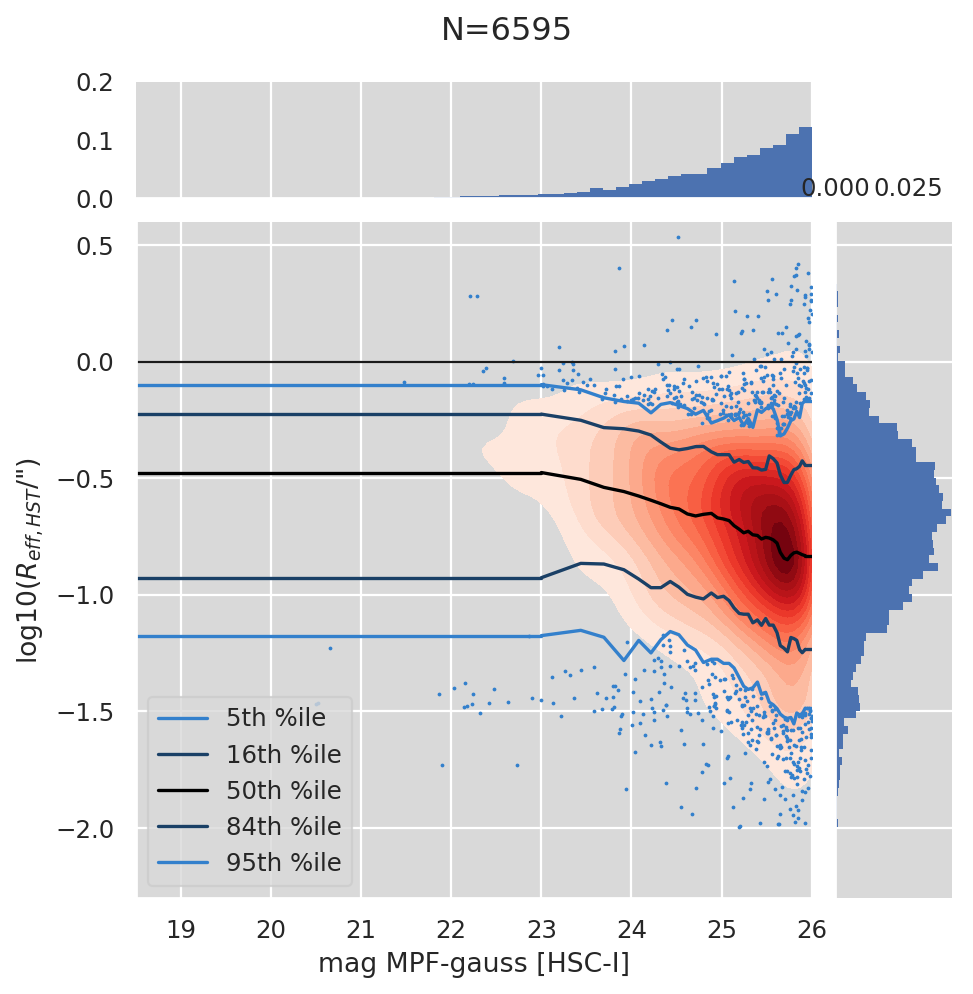

In [17]:
# Plot the presumably robust Gaussian fits
plot_mpf_model_hsc_vs_hst("gauss")
plt.show()
print('Gauss mag vs Sersic reff')
plot_mpf_model_hsc_vs_hst("gauss", model_reff="mg8serb", plot_only_size_mag=True, reff_min=1e-2, lims_mag=(18.5, 26))

lim_x=(19.5, 25.5) cond=119114. isfin_hsc=282388,isfin_hst=282388, good=120316,allgood=5124, good_not_cond=0
n_big_hst, hsc=707, 916; frac_big=707/5124=1.380e-01


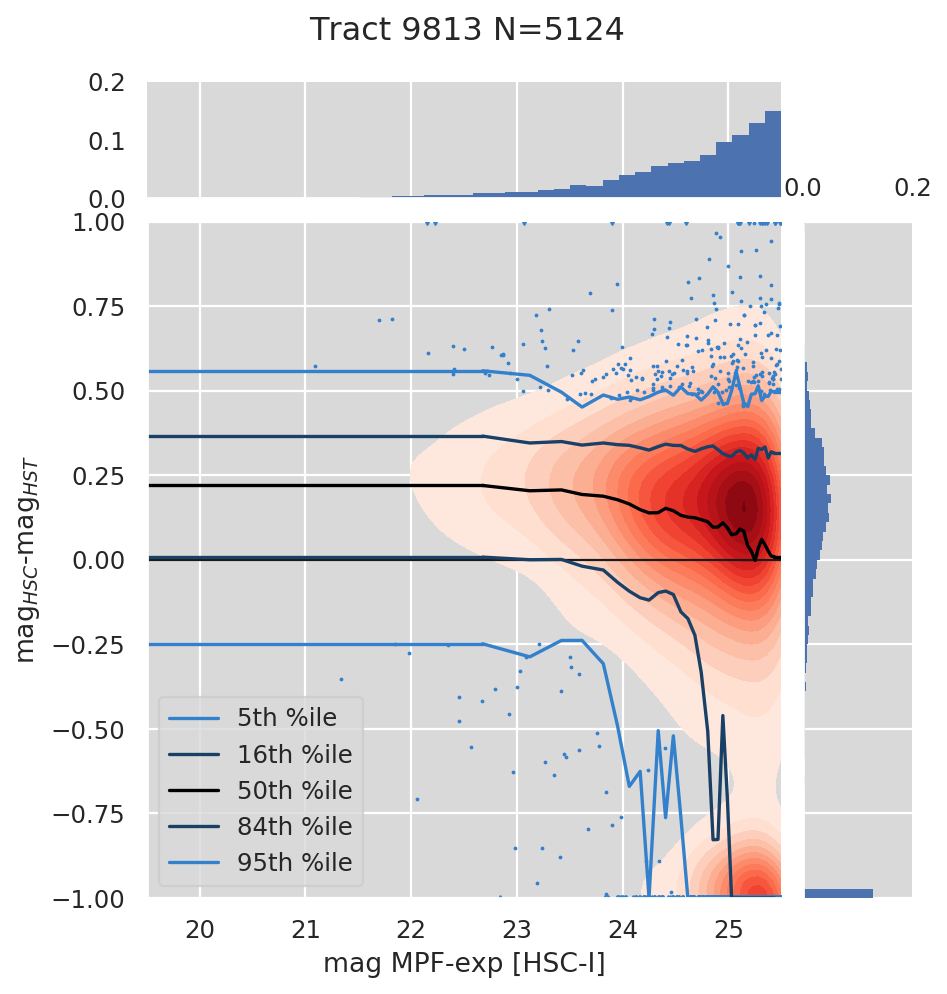

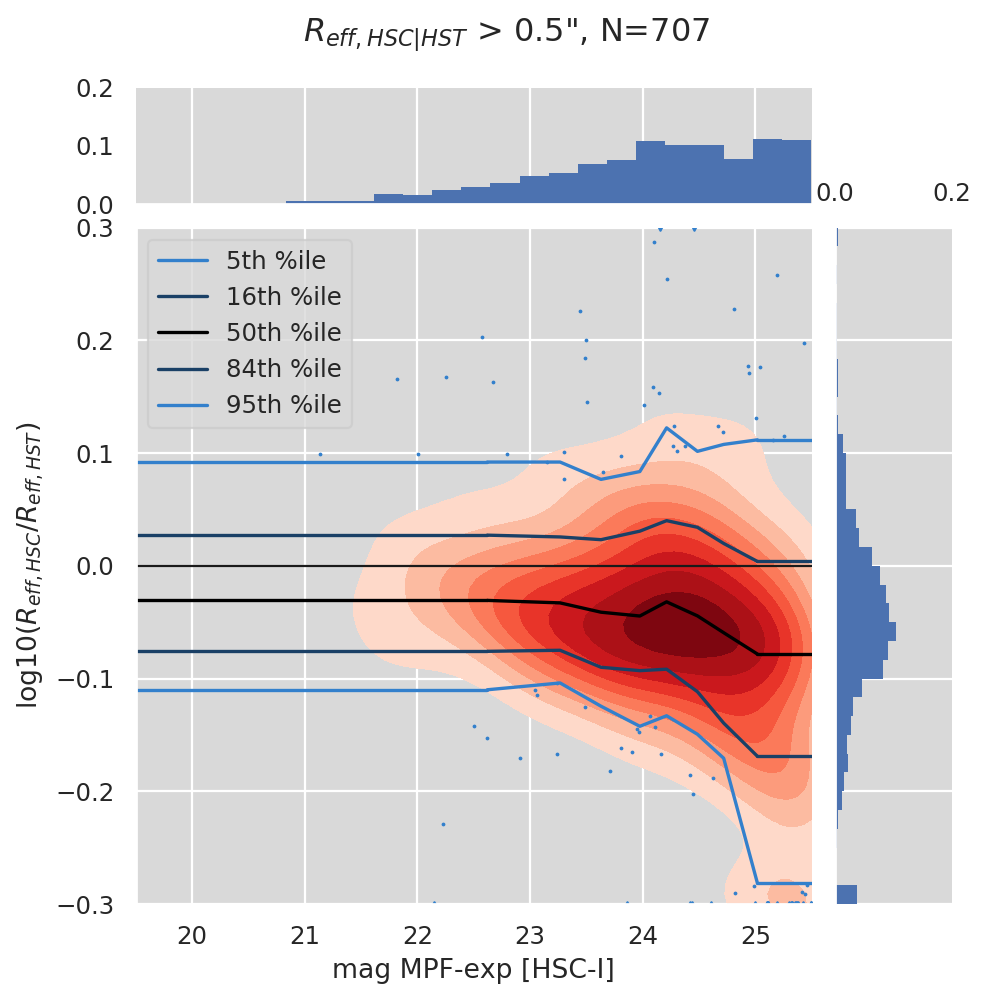

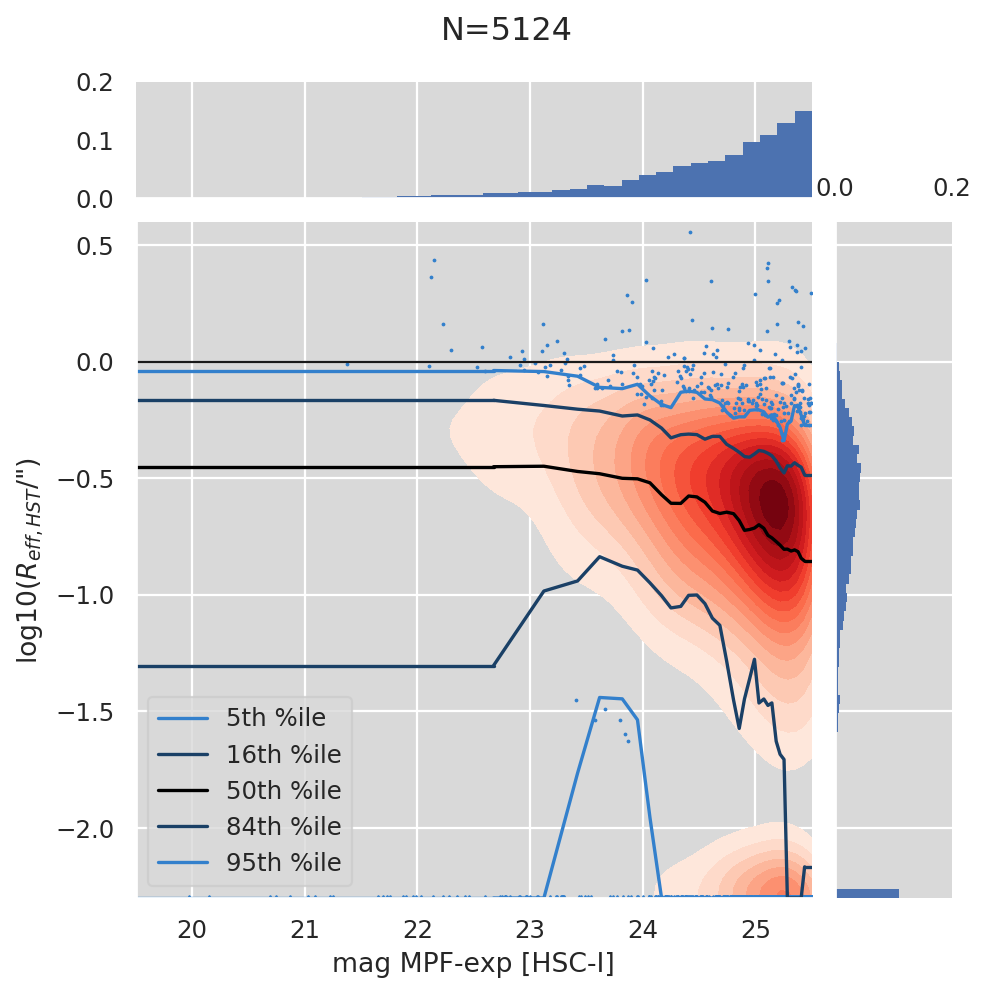

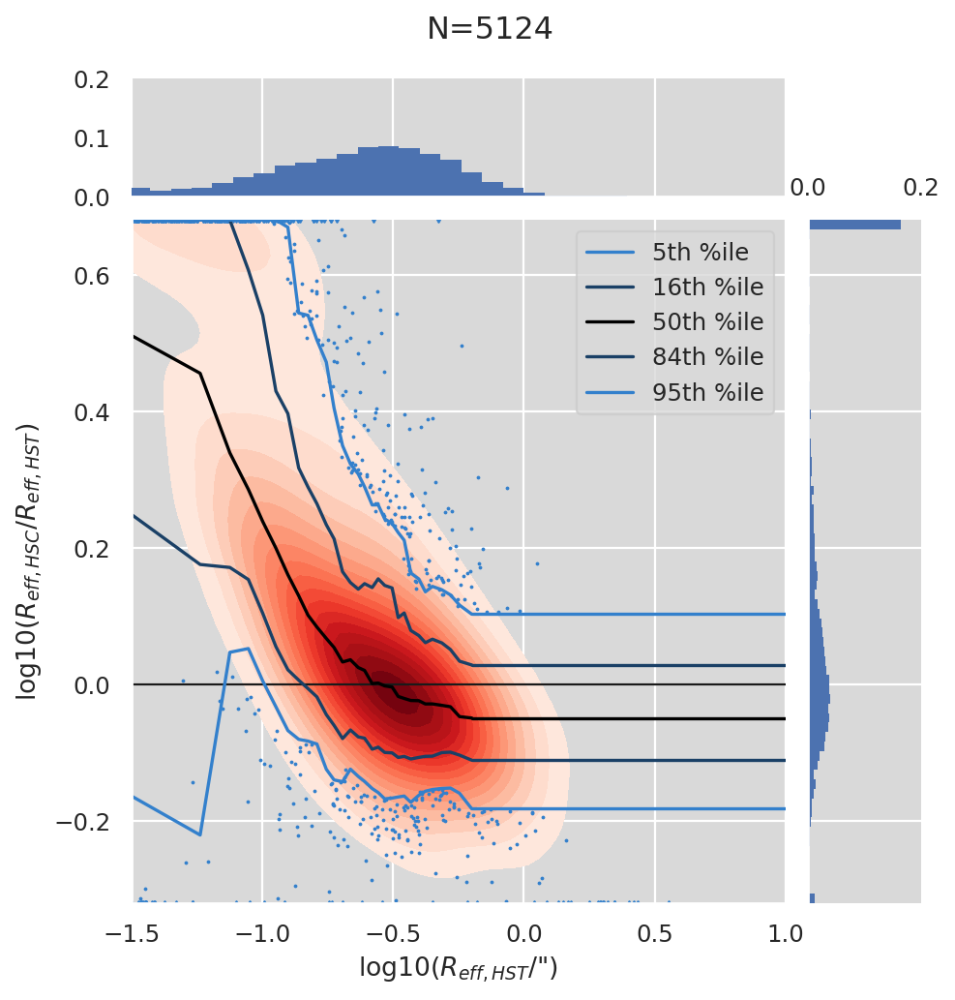

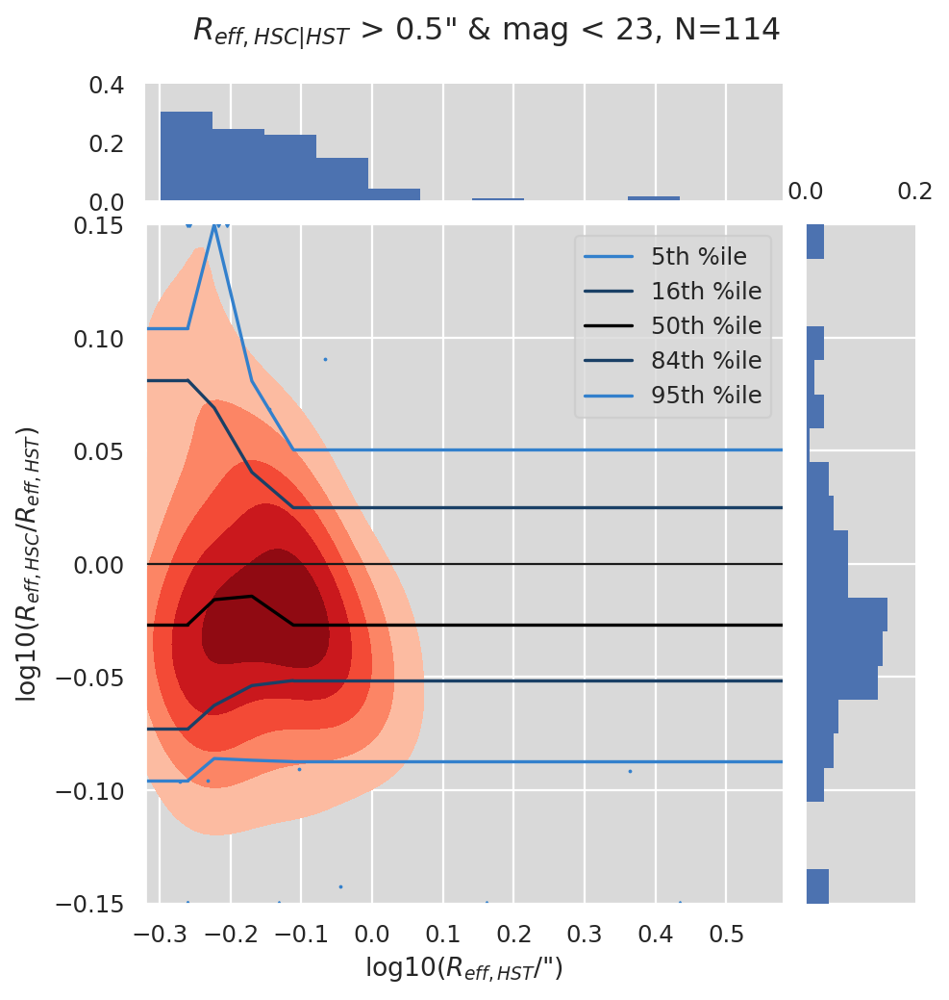

In [18]:
# Plot the hopefully still mostly robust exponential fits
plot_mpf_model_hsc_vs_hst("exp")

###  HSC-[IZ] vs. HST-F814W, Sersic

Conclusions:

1. Magnitudes are really not very consistent at all, and worse than for exponential fits. Perhaps colour terms are more important here.
2. Sizes are more consistent, albeit still not unbiased. Still, it's better than expected, if worse than hoped.
3. There are so few large, isolated galaxies that it's hard to say if the Sersic indices are consistent, but I doubt it.
4. One could conceivably use the size-magnitude relation as a rough prior, although it may be wise to use a more robust magnitude. Even a PSF magnitude might work.

lim_x=(19.5, 25.5) cond=127740. isfin_hsc=282388,isfin_hst=282388, good=120316,allgood=5534, good_not_cond=0
n_big_hst, hsc=782, 1308; frac_big=782/5534=1.413e-01


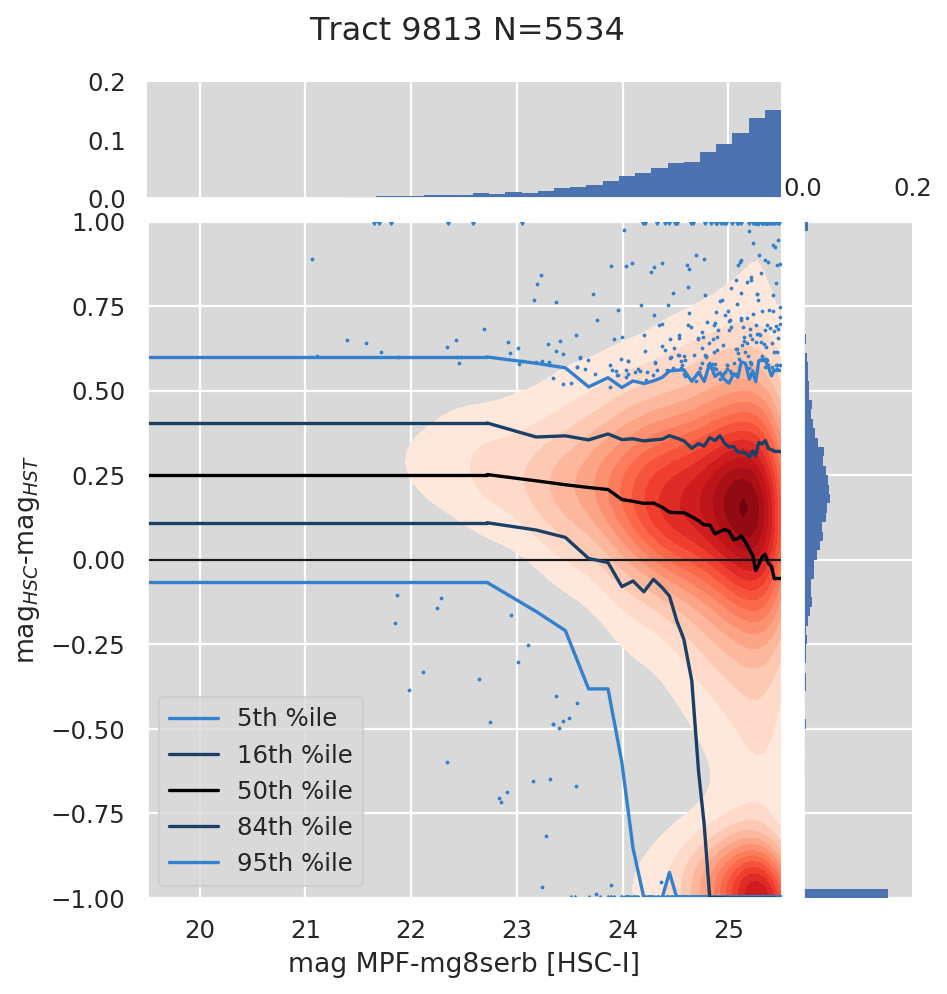

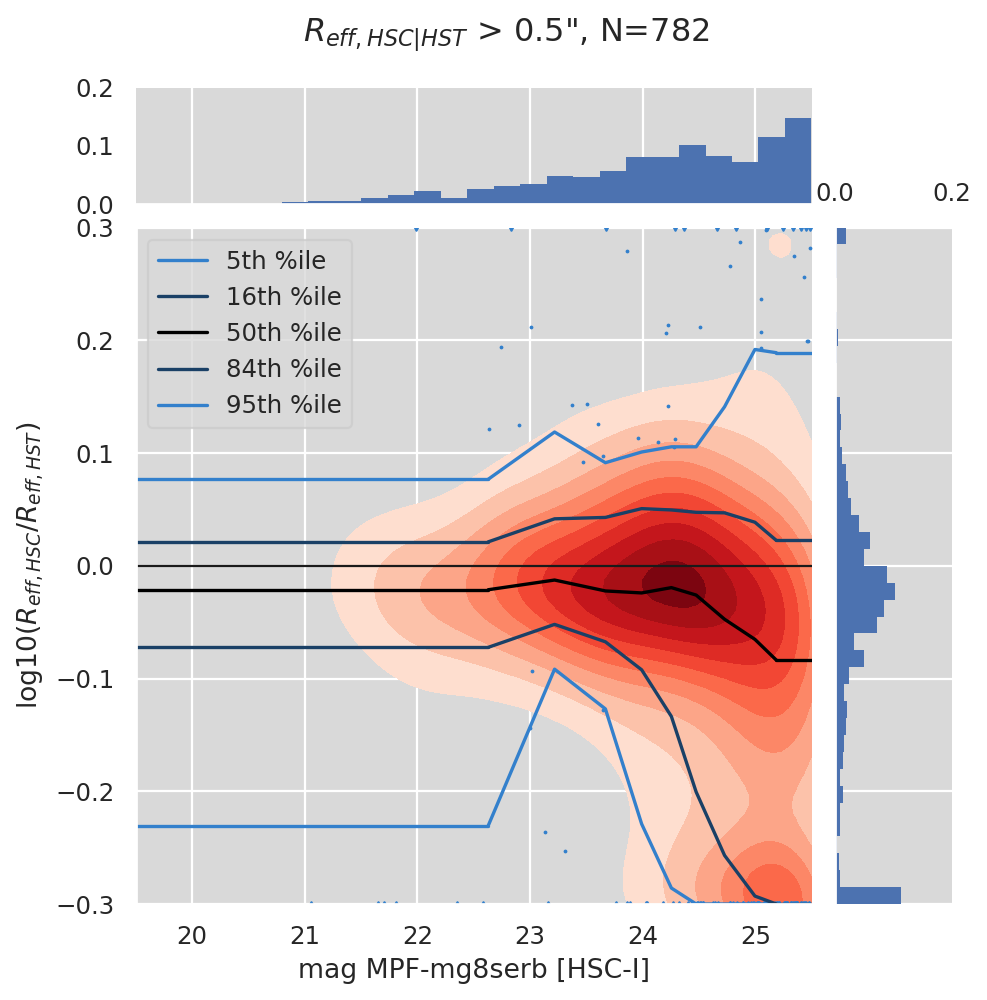

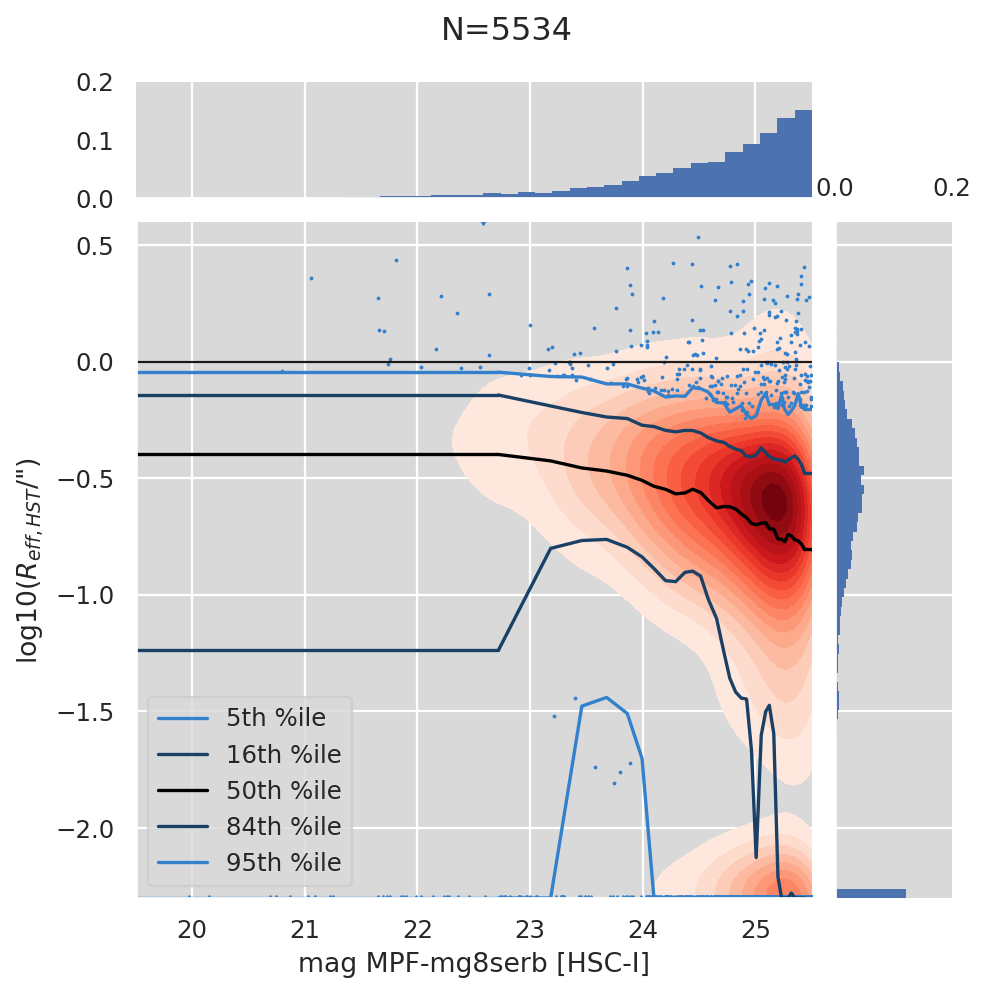

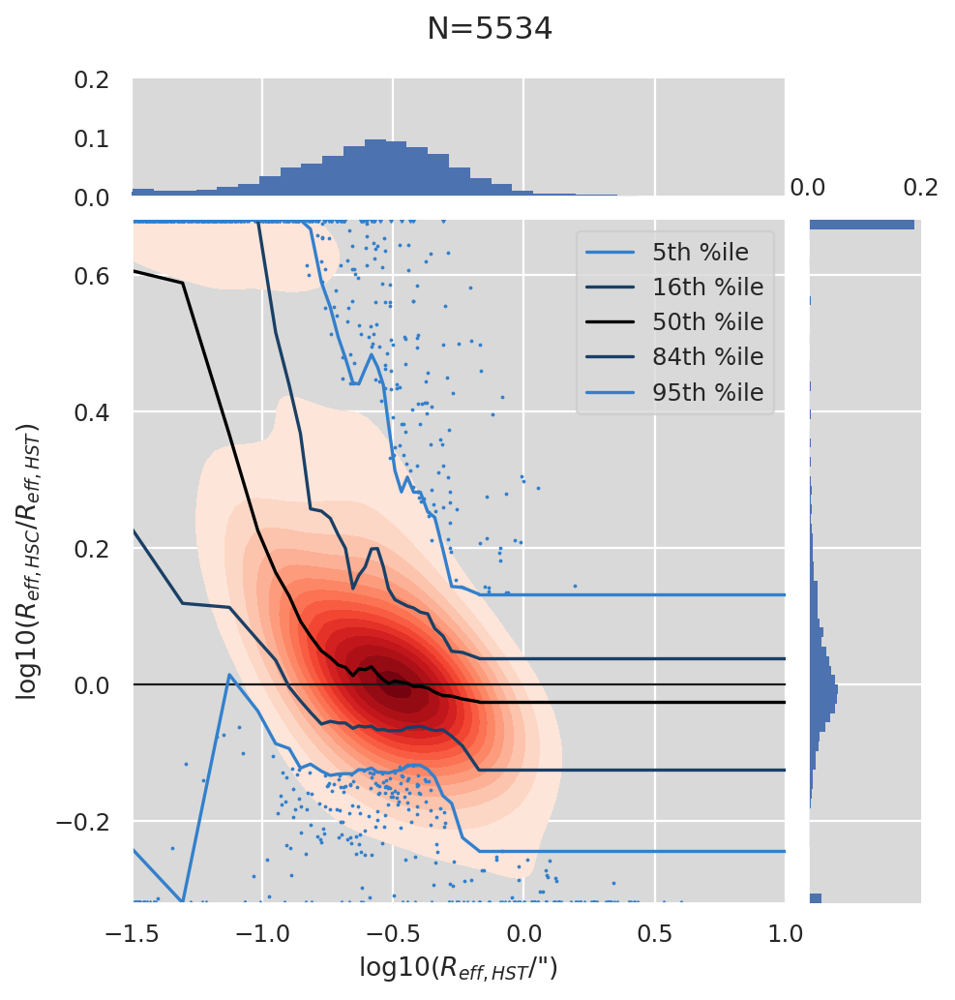

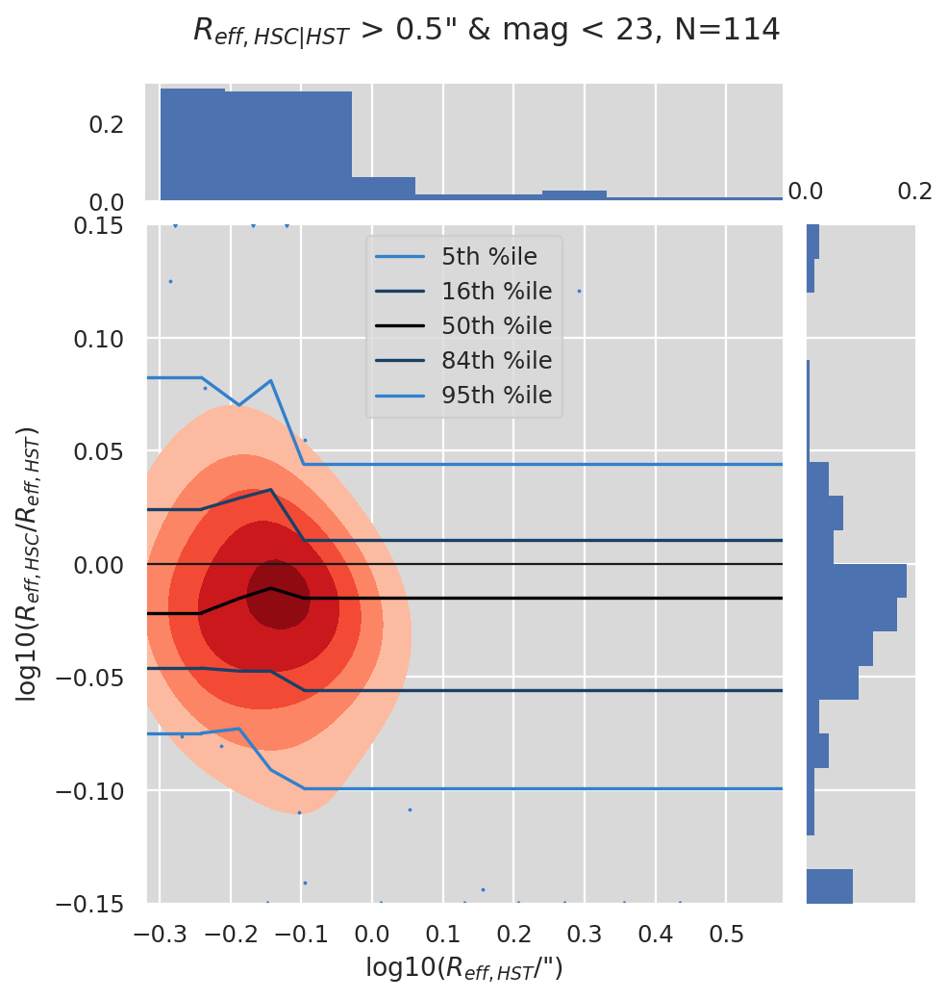

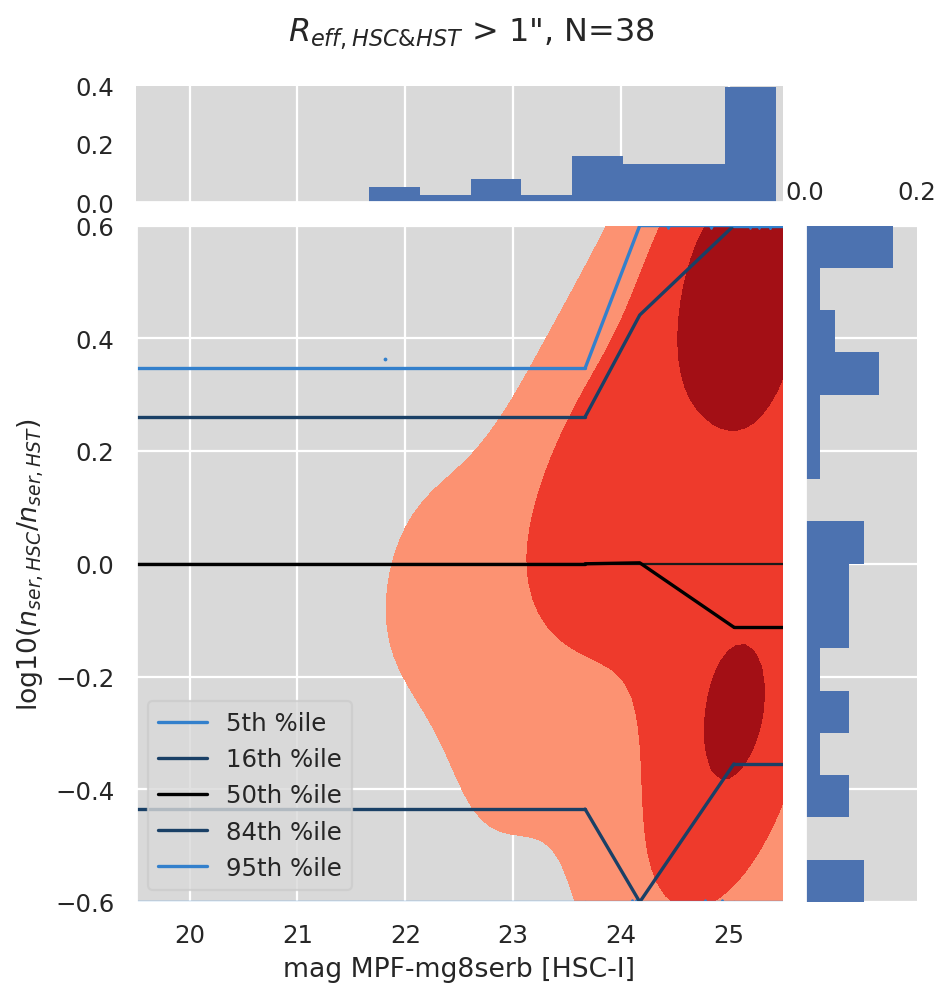

In [19]:
# Plot Sersic fits, including Sersic index
plot_mpf_model_hsc_vs_hst("mg8serb")

## Investigating Discrepancies
Why don't HSC and HST sizes match for bright sources which should be fairly reliably recovered? See below for exact selection criteria.

Most of these cases are artifacts in one or the other, or unrecognized blends. Only a few seem to be genuine disagreements on an isolated galaxy, and even then it's not clear that MultiProFit did anything wrong (some appear to have unusual structures).

In [20]:
# Load all of the overlapping COSMOS HST images
cat = cats['iz']
rad2deg = 180/np.pi
ra_range, dec_range = [(np.nanmin(x)*rad2deg, np.nanmax(x)*rad2deg) for x in [cat[f'coord_{y}'] for y in ['ra', 'dec']]]
tiles = get_tiles_HST_COSMOS()
tiles = get_tiles_overlapping_HST(ra_range, dec_range, tiles)
exposures_hst = get_exposures_HST_COSMOS(ra_range, dec_range, tiles, "/project/dtaranu/cosmos/hst/COSMOS_25.2_training_sample")
calexps = {}
meas = {}

### Discrepant galaxy selection

This focuses on bright (by UltraDeep standards) galaxies that should be reasonably resolved in HSC but have overestimated sizes compared to HST.

In [21]:
# Cache the calexps and original measurement catalogs with bboxes
# It would have been smarter to keep the whole catalog as a SourceCatalog but concatenating astropy tables is so much easier
model = 'mg8serb'
data_hst = data['f814w'][model]['mpf']
data_hsc = data['iz'][model]['mpf']
cat_hsc = cats['iz']
n_child_hsc = cat_hsc['deblend_nChild']
id_hsc = cat_hsc['id']
isolated = np.zeros(len(cat_hsc), dtype=bool)
# This horribly slow code is here because there's no simple cat.find(key) except in afwTable, AFAIK.
for idx_src, src in enumerate(cat_hsc):
    parent_src = src['parent']
    if (src['parent'] != 0) and (n_child_hsc[np.where(id_hsc == parent_src)[0][0]] == 1):
        isolated[idx_src] == 1
safe = (data_hsc["mag_i"] > 20.5) & (data_hsc["mag_i"] < 23) & (data_hsc["reff"] > -0.3) & isolated
# More than 0.2 dex bigger
rows_big = {
    'bright_iso_toobig_relhst_hsc':  np.nonzero(safe & ((data_hsc["reff"] - data_hst["reff"]) > 0.2))[0],
    'faint_toobig_hsc': np.nonzero((data_hsc["mag_i"] > 24) & (data_hsc["mag_i"] < 25) & (data_hsc["reff"] > 0.9))[0],
}
cat = cats['iz']
tract = 9813
#skymap = butler.get("deepCoadd_skyMap")[tract]
bands = ['HSC-Z', 'HSC-I', 'HSC-R']

Plotting 0/0 outliers of type bright_iso_toobig_relhst_hsc
Plotting 16/42 outliers of type faint_toobig_hsc


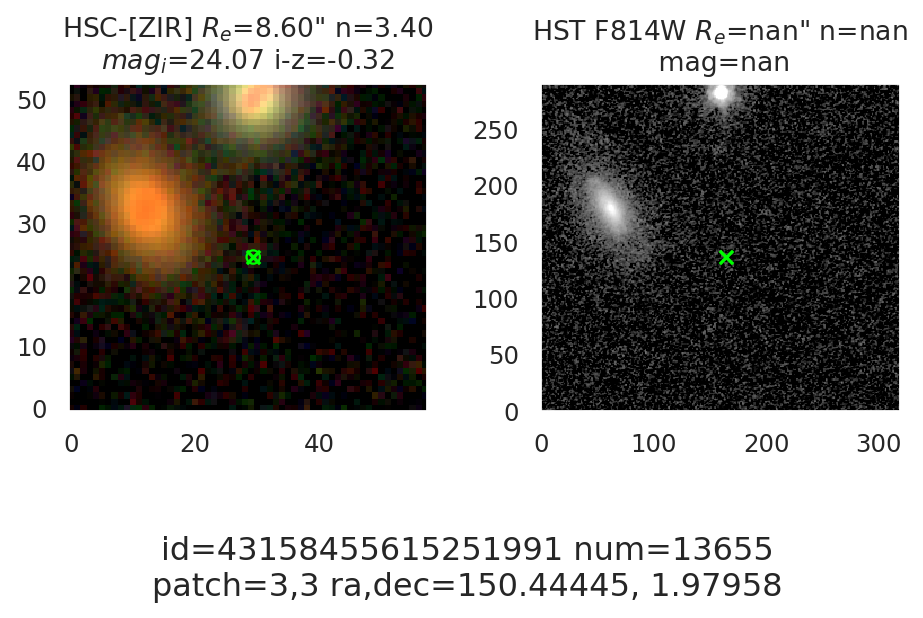

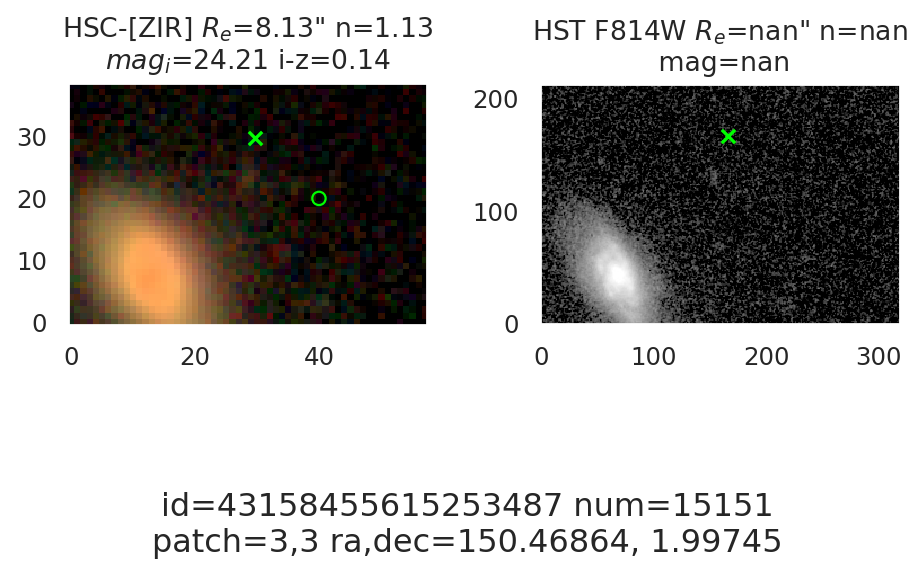

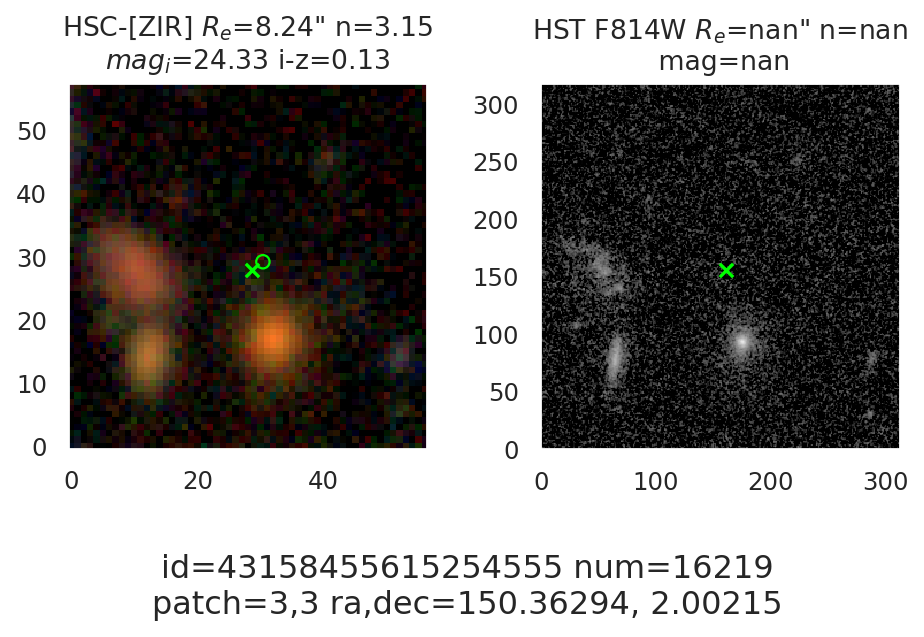

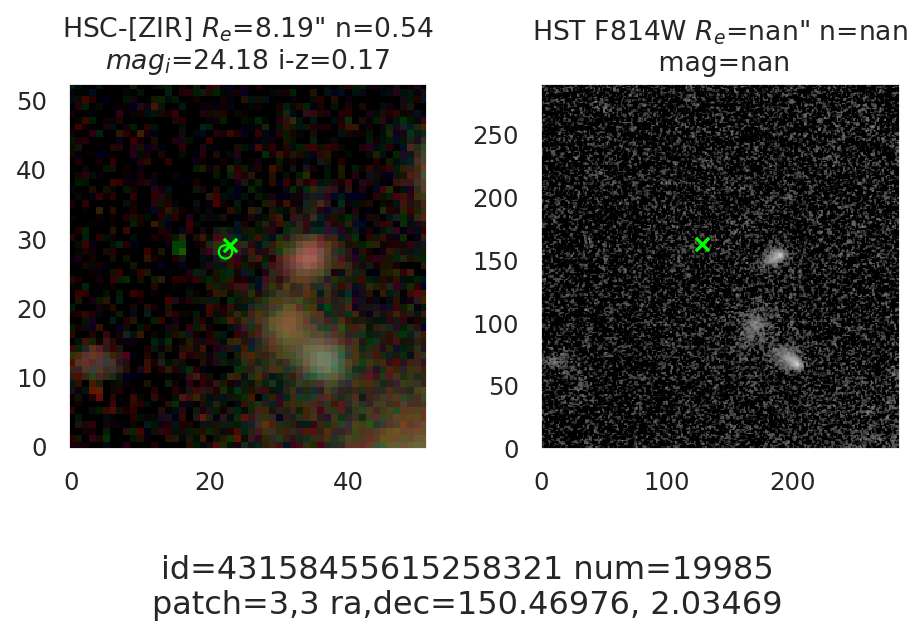

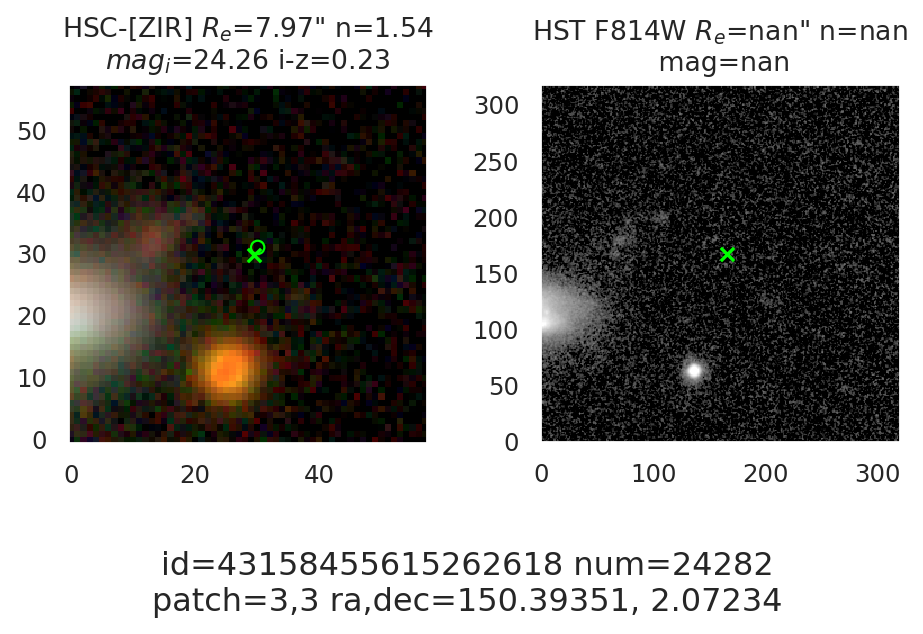

...

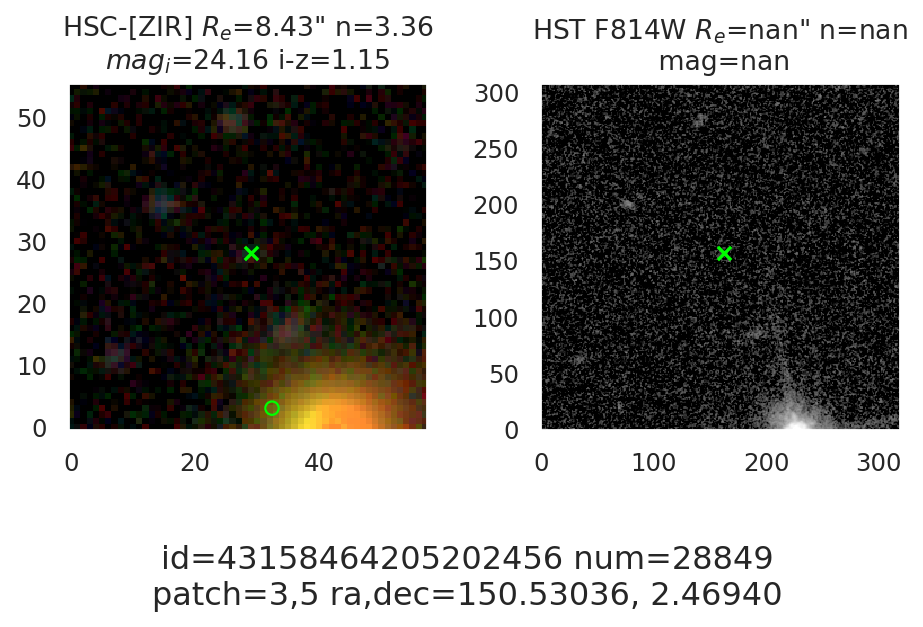

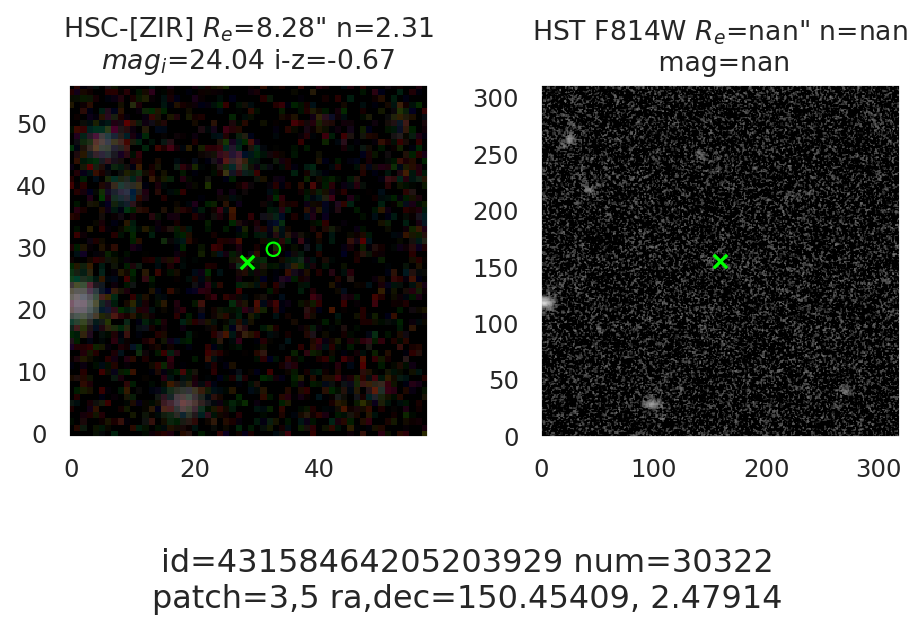

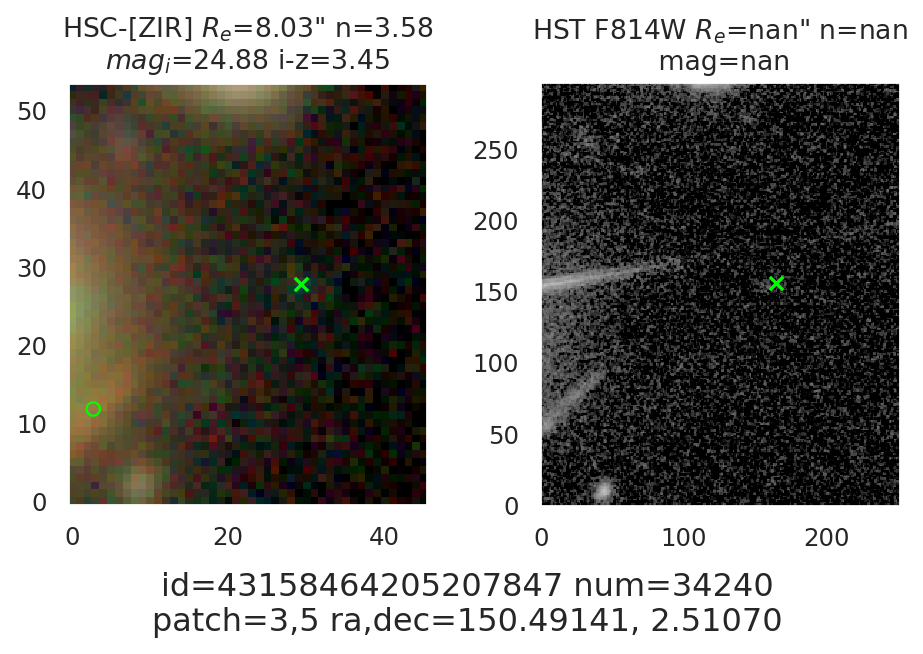

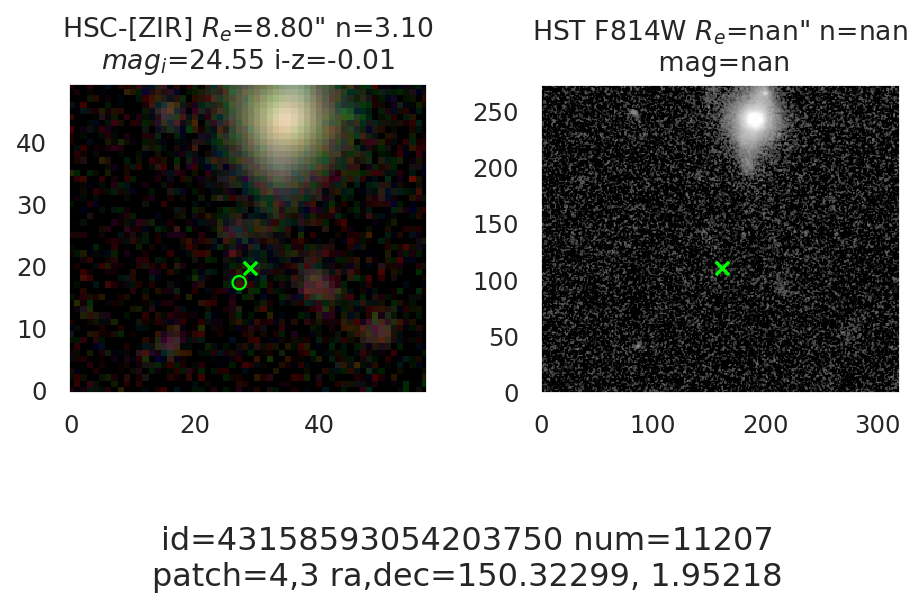

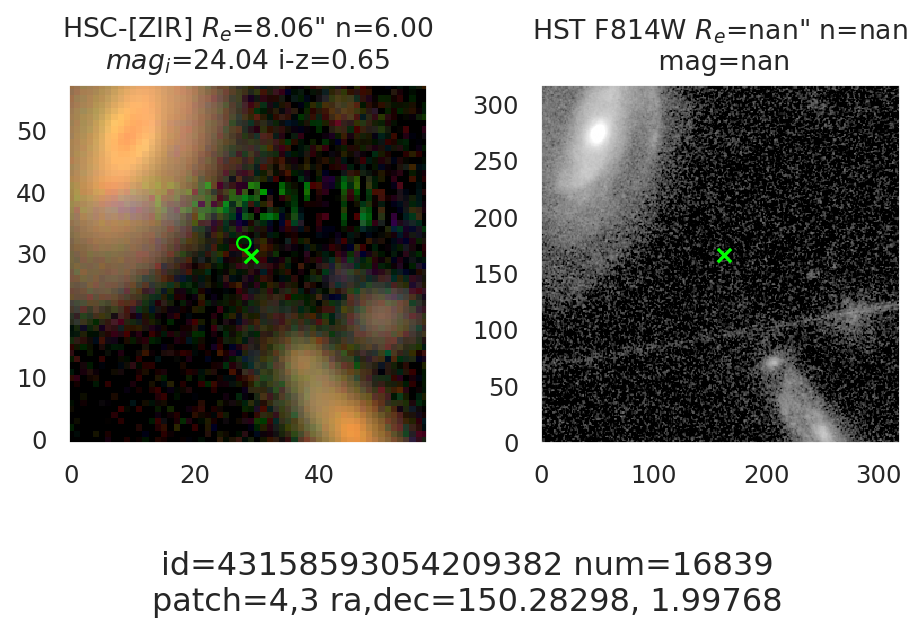

In [22]:
# Plot HSC and HST images of discrepant models
sns.set_style("darkgrid", {'axes.grid' : False})
band = 'HSC-I'
scale_hst2hsc = scales['hsc']/scales['hst']
names_patches = [k for k, v in patches.items() if v[1]]
rows_max = 16
for name, rows in rows_big.items():
    n_rows = len(rows)
    row_max = np.min((n_rows, rows_max))
    print(f"Plotting {row_max}/{n_rows} outliers of type {name}")
    n_rows_shown = 0
    for idx_row in rows:
        row = cat[idx_row]
        id_src = row['id']
        row_offset_idx = np.argmax(patch_rows>=idx_row)
        name_patch = names_patches[row_offset_idx]
        row_patch = int(idx_row - (0 if row_offset_idx == 0 else patch_rows[row_offset_idx-1]))
        # This doesn't always agree - not sure if that's because patches overlap?
        # patch = skymap.findPatch(SpherePoint(row['coord_ra'], row['coord_dec'], radians)).getIndex()
        if name_patch not in meas:
            meas[name_patch] = butler.get('deepCoadd_meas', {'filter': 'HSC-I', 'tract': tract, 'patch': name_patch})
        src = meas[name_patch][row_patch]
        if name_patch not in calexps:
            calexps[name_patch] = {band: butler.get('deepCoadd_calexp', {'filter': band, 'tract': tract, 'patch': name_patch}) for band in bands}
        calexps_patch = calexps[name_patch]
        wcs = calexps_patch['HSC-I'].getWcs()
        bbox = src.getFootprint().getBBox()
        cenx, ceny = src.getCentroid() - bbox.getBegin()
        radec = [[y for y in wcs.pixelToSky(Point2D(x)).getPosition(degrees)] for x in bbox.getCorners()]
        try:
            img = get_exposure_cutout_HST(radec, (0, 0), exposures_hst)[0]
            if img.image[0, 0] != 0 or (0.1*np.count_nonzero(img.image) > np.prod(img.image.shape)):
                fig, axes = plt.subplots(ncols=2)
                axes[0].imshow(make_lupton_rgb(*[x.image.subset(bbox).array for x in calexps_patch.values()],
                                               stretch=0.4, Q=8))
                axes[0].set_title(f'HSC-[ZIR] $R_{{e}}$={10**data_hsc["reff"][idx_row]:.2f}"'
                                  f' n={data_hsc["nser_1"][idx_row]:.2f}\n'
                                  f'$mag_i$={data_hsc["mag_i"][idx_row]:.2f}'
                                  f' i-z={data_hsc["mag_i"][idx_row] - data_hsc["mag_z"][idx_row]:.2f}')
                fluxratio = data_hst["flux_f814w"][idx_row]/(
                    data_hsc["flux_i"][idx_row] + data_hsc["flux_z"][idx_row])
                mag_hst = data_hsc["mag_i"][idx_row] - 2.5*(np.log10(fluxratio) + 0.88)
                axes[0].scatter(cenx, ceny, marker='x', color='lime')
                axes[0].scatter(data_hsc["cenx"][idx_row]-0.5, data_hsc["ceny"][idx_row]-0.5,
                                marker='o', color='lime', facecolors='none')
                axes[1].imshow(make_lupton_rgb(img.image,img.image, img.image, stretch=0.01, Q=6))
                axes[1].set_title(f'HST F814W $R_{{e}}$={10**data_hst["reff"][idx_row]:.2f}" '
                                  f'n={data_hst["nser_1"][idx_row]:.2f}\n mag={mag_hst:.2f}')
                axes[1].scatter(cenx*scale_hst2hsc, ceny*scale_hst2hsc, marker='x', color='lime')
                axes[1].scatter(data_hst["cenx"][idx_row]-0.5, data_hst["ceny"][idx_row]-0.5,
                                marker='o', color='lime', facecolors='none')
                radec = ', '.join(f'{x:.5f}' for x in wcs.pixelToSky(Point2D(bbox.getCenter())).getPosition(degrees))
                plt.suptitle(f'id={id_src} num={row_patch}\npatch={name_patch} ra,dec={radec}', y=0.05)
                plt.tight_layout()
                plt.show(block=False)
                n_rows_shown += 1
        except Exception as e:
            print(f'Failed plotting {id_src} in patch={name_patch} due to {e}')
        if n_rows_shown > row_max:
            break
sns.set_style("darkgrid", {'axes.grid' : True})